
Estrategia Dijkstra:


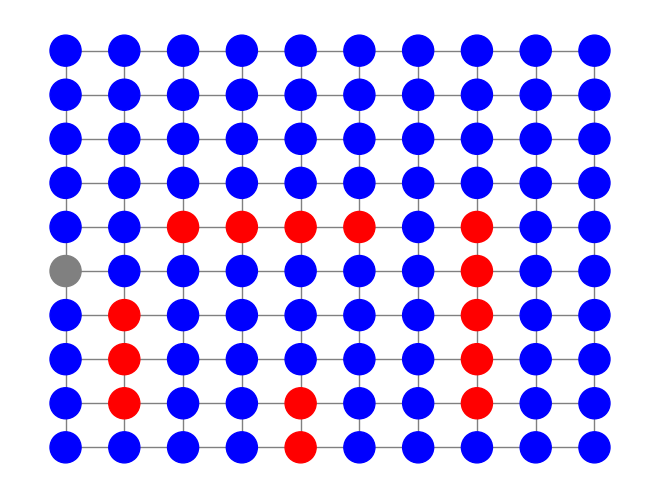

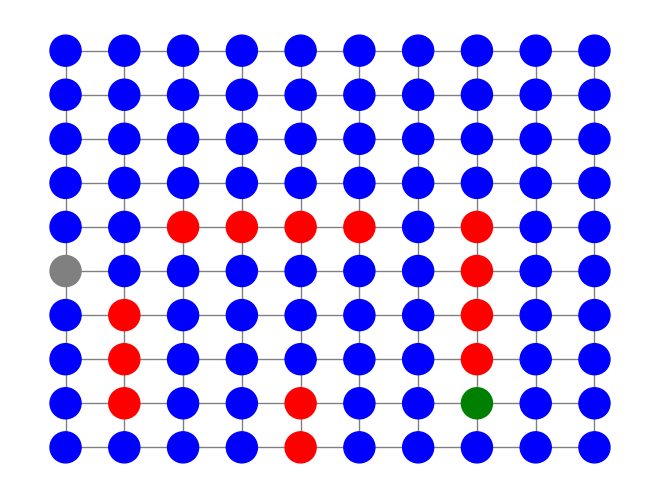

Dijkstra explora: (6, 8) con probabilidad 0.30


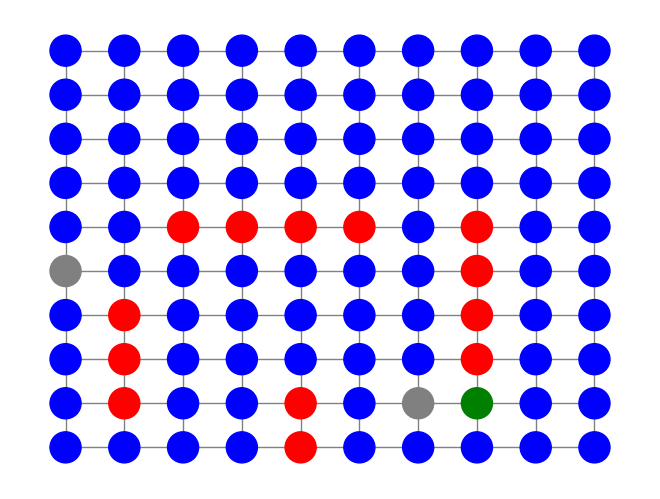

Dijkstra explora: (7, 7) con probabilidad 0.30


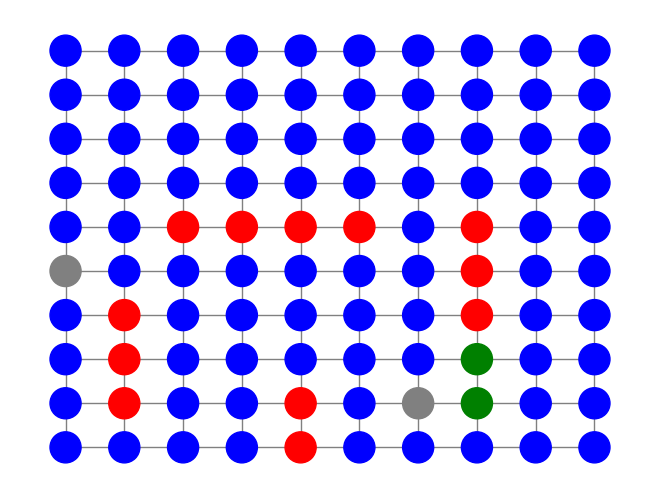

Dijkstra explora: (6, 7) con probabilidad 0.30


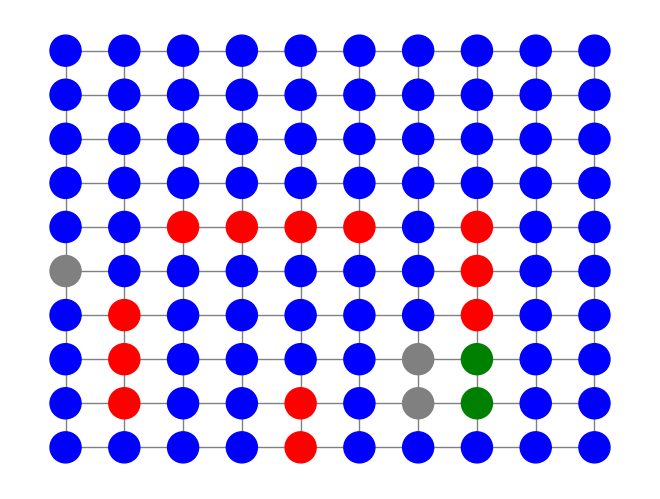

Dijkstra explora: (7, 6) con probabilidad 0.30


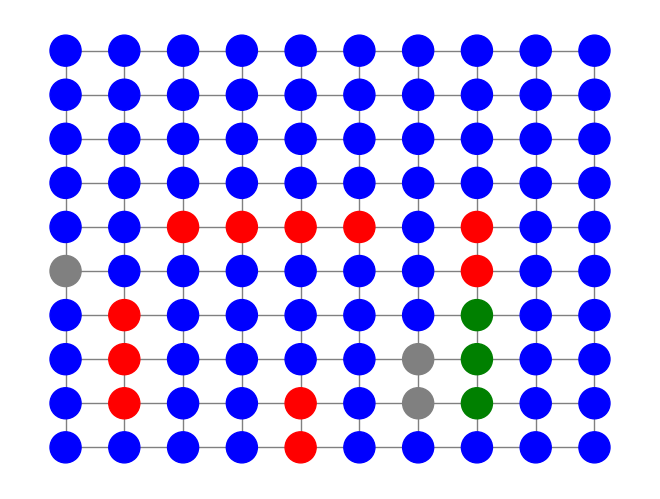

Dijkstra explora: (6, 6) con probabilidad 0.30


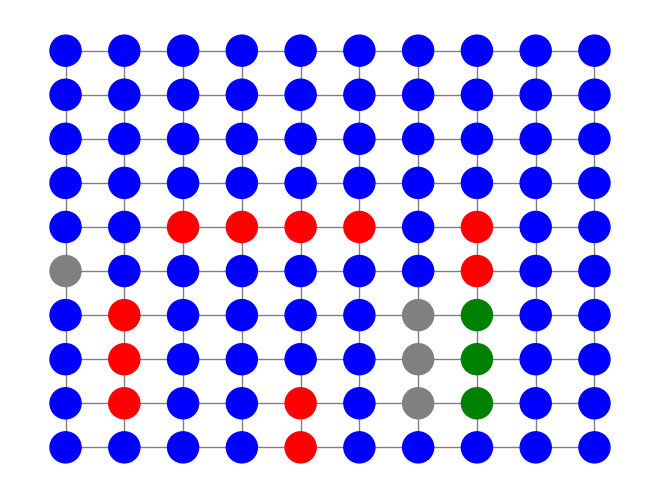

Dijkstra explora: (7, 5) con probabilidad 0.30


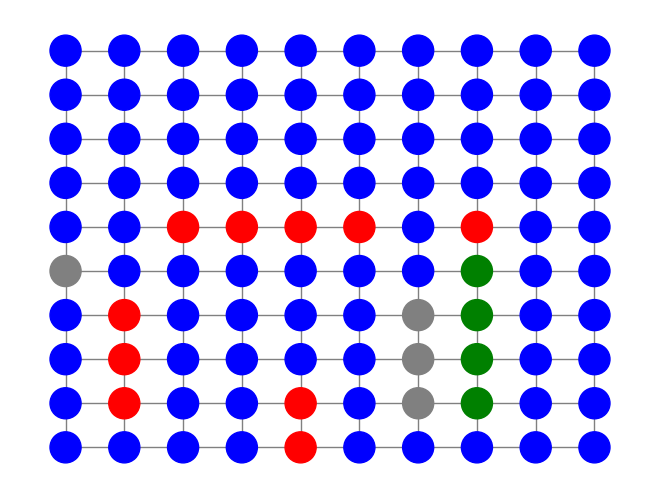

Dijkstra explora: (6, 5) con probabilidad 0.30


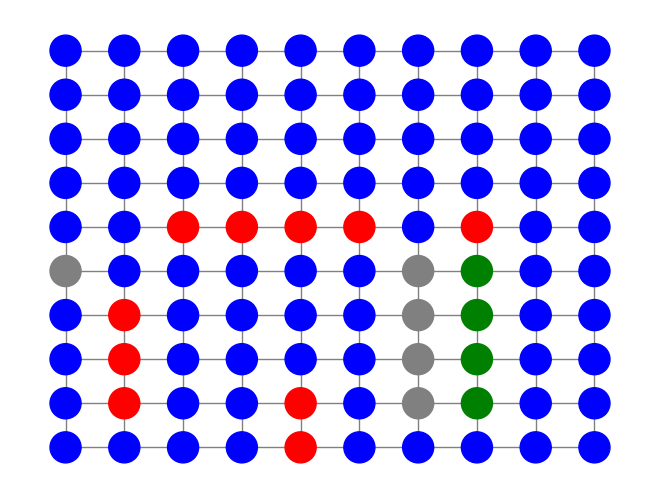

Dijkstra explora: (7, 4) con probabilidad 0.30


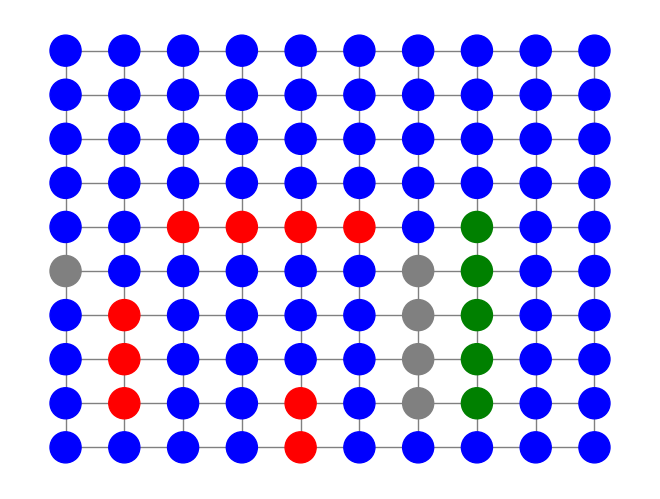

Dijkstra explora: (6, 4) con probabilidad 0.30


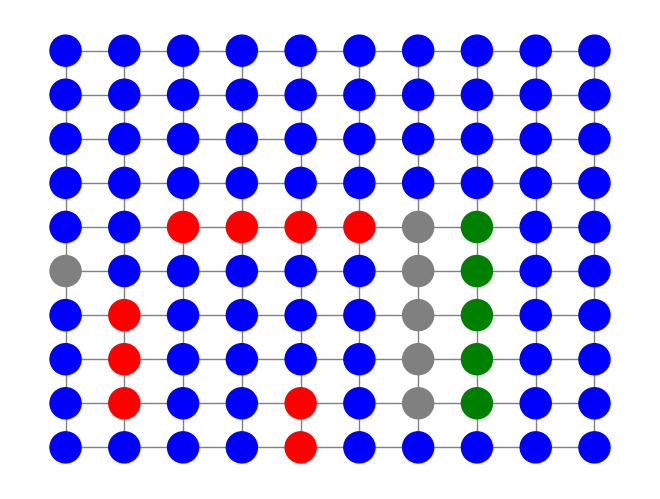

Dijkstra explora: (7, 3) con probabilidad 0.30


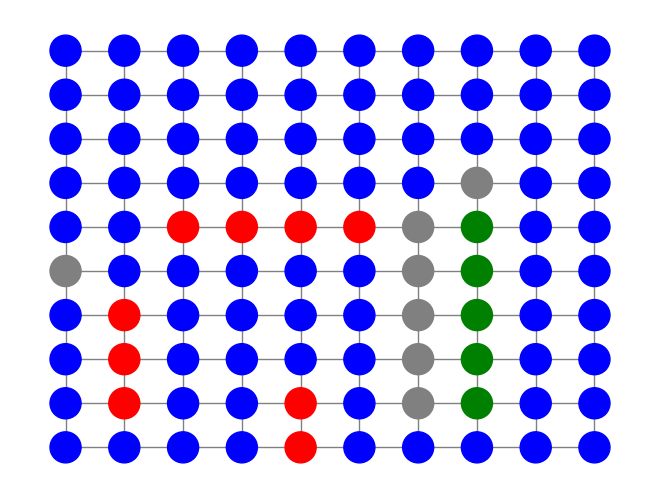

Dijkstra explora: (7, 9) con probabilidad 0.30


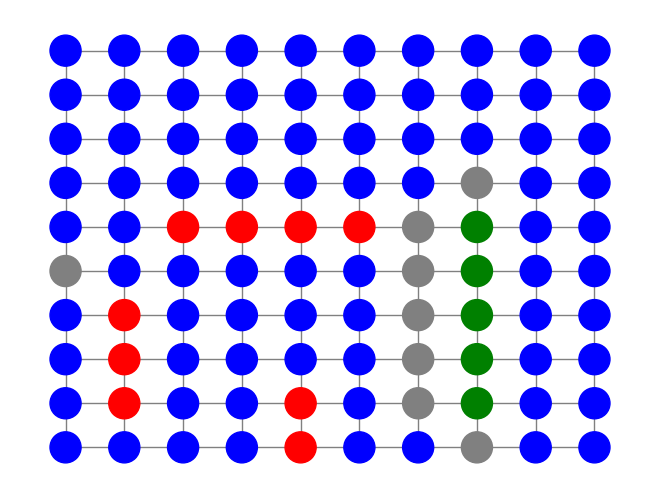

Dijkstra explora: (8, 4) con probabilidad 0.30


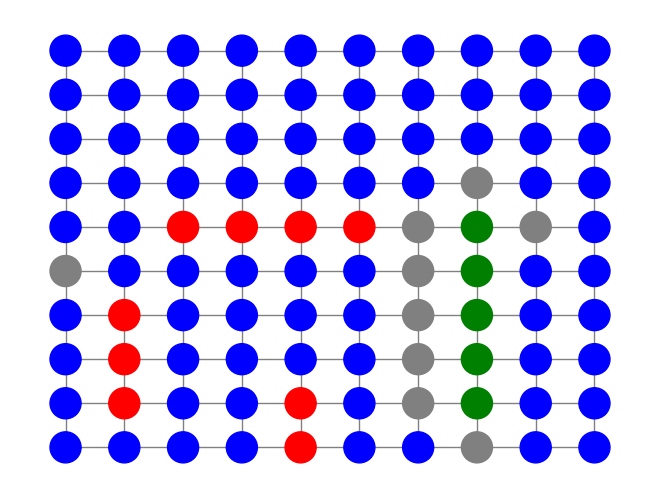

Dijkstra explora: (8, 6) con probabilidad 0.30


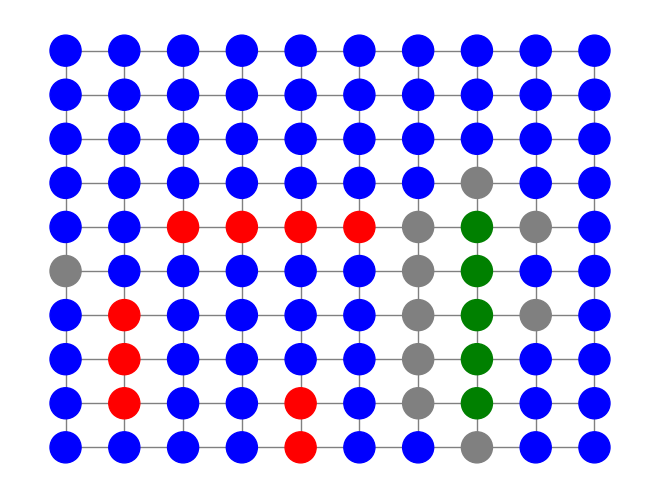

Dijkstra explora: (8, 8) con probabilidad 0.30


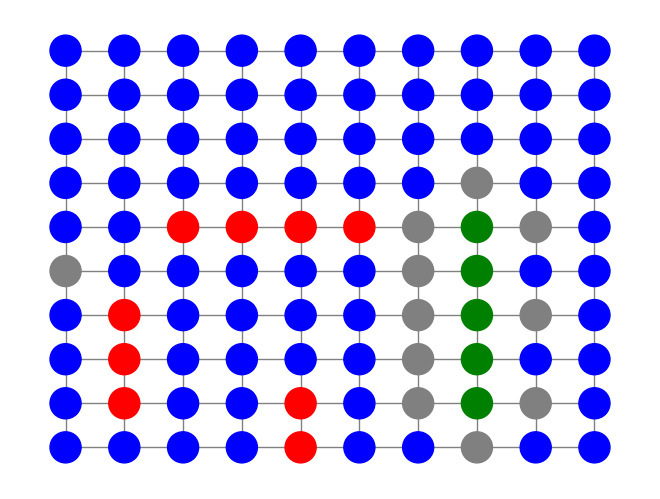

Dijkstra explora: (8, 5) con probabilidad 0.10


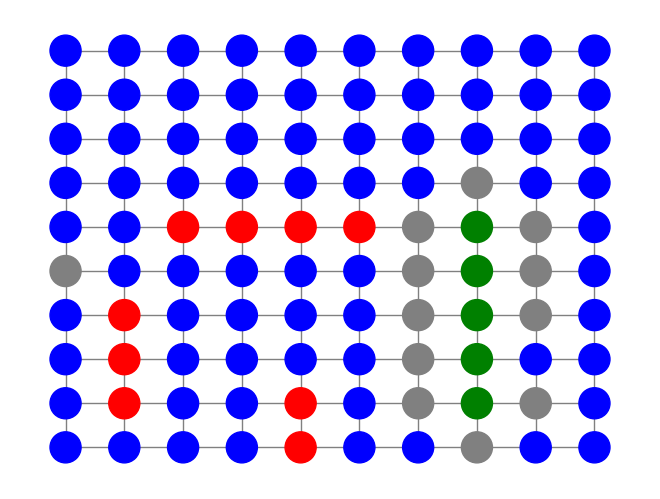

Dijkstra explora: (8, 7) con probabilidad 0.10


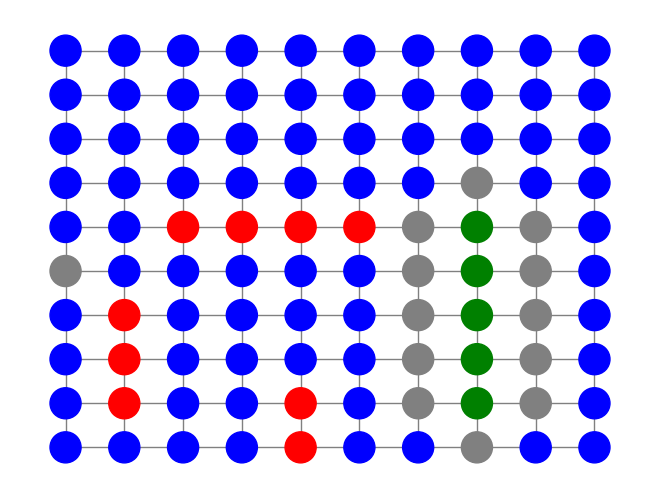

Dijkstra explora: (0, 0) con probabilidad 0.00


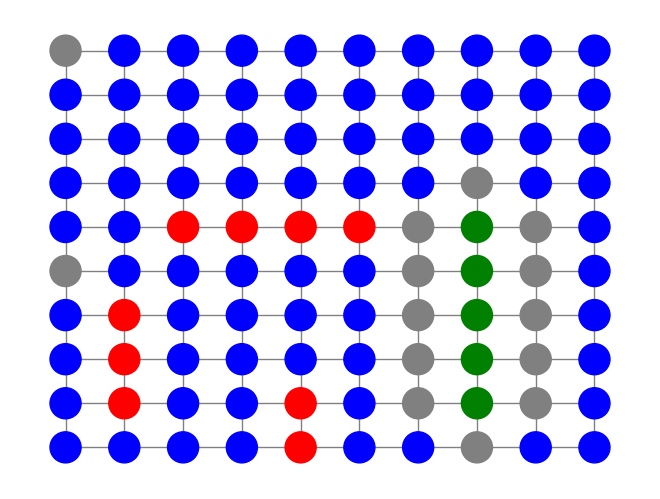

Dijkstra explora: (0, 1) con probabilidad 0.00


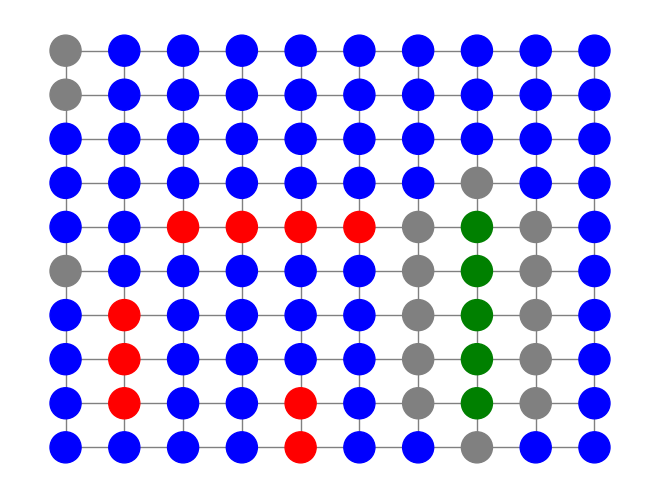

Dijkstra explora: (0, 2) con probabilidad 0.00


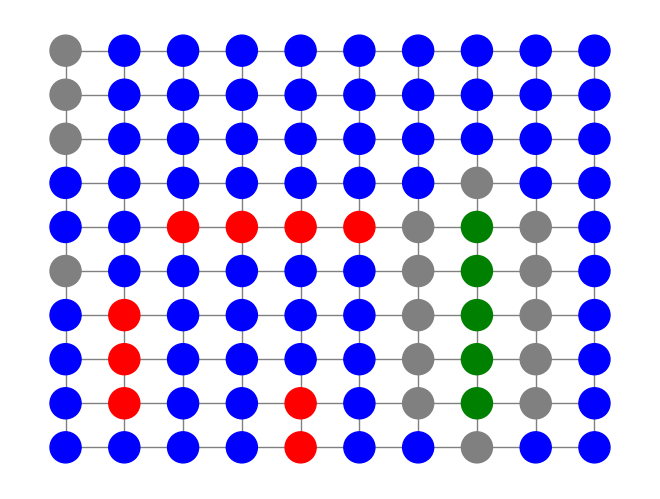

Dijkstra explora: (0, 3) con probabilidad 0.00


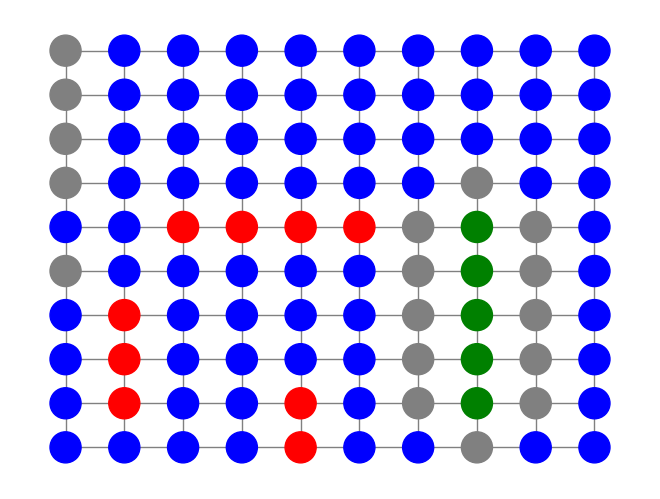

Dijkstra explora: (0, 4) con probabilidad 0.00


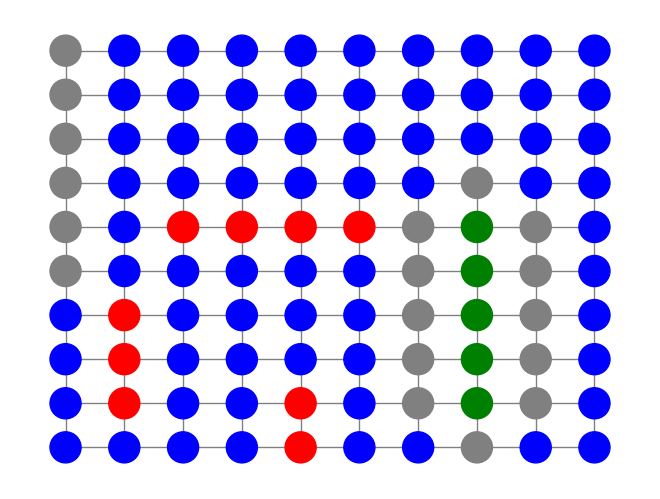

Dijkstra explora: (0, 6) con probabilidad 0.00


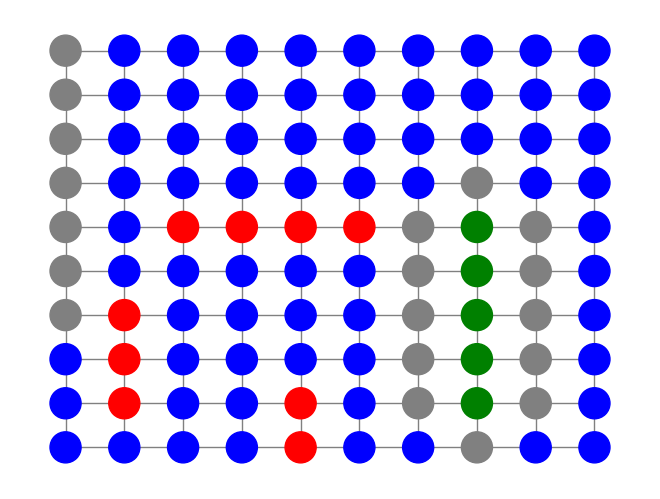

Dijkstra explora: (0, 7) con probabilidad 0.00


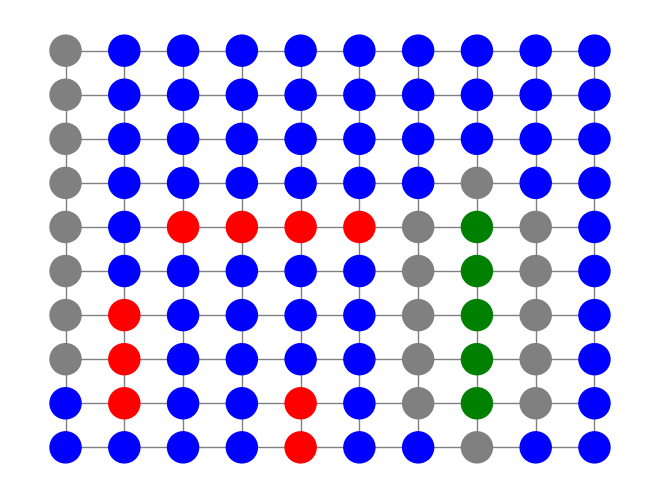

Dijkstra explora: (0, 8) con probabilidad 0.00


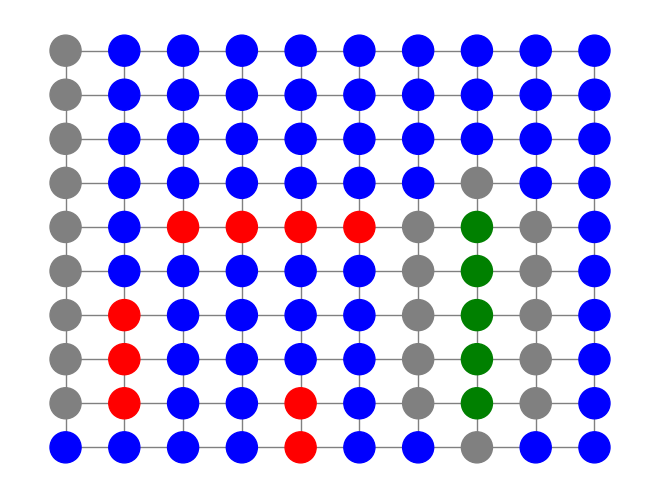

Dijkstra explora: (0, 9) con probabilidad 0.00


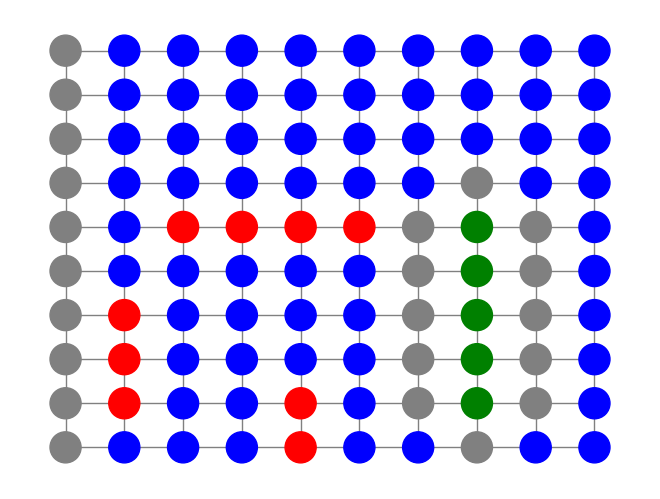

Dijkstra explora: (1, 0) con probabilidad 0.00


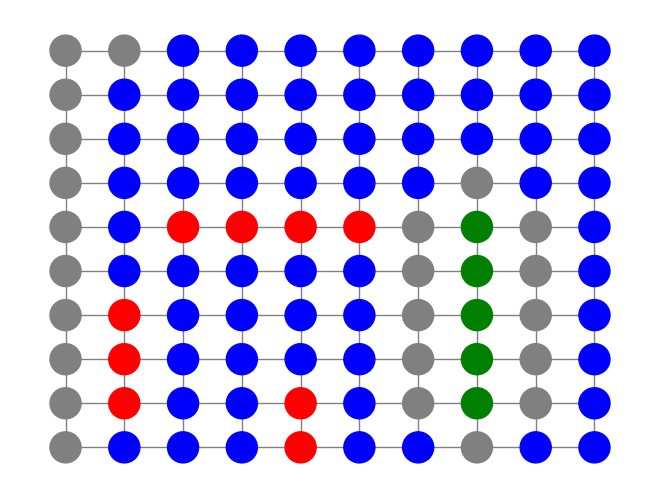

Dijkstra explora: (1, 1) con probabilidad 0.00


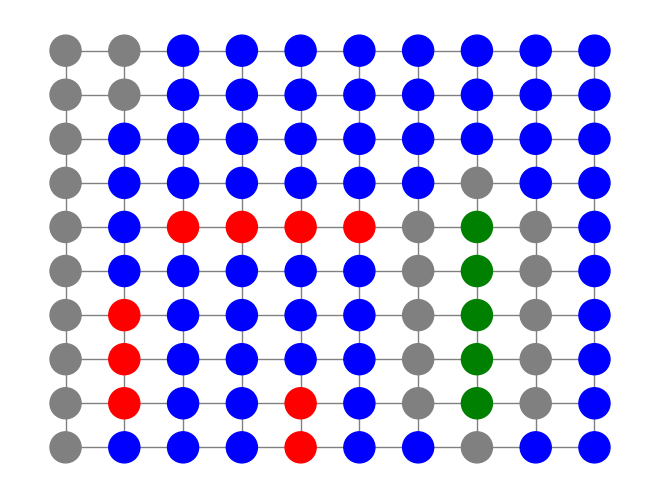

Dijkstra explora: (1, 2) con probabilidad 0.00


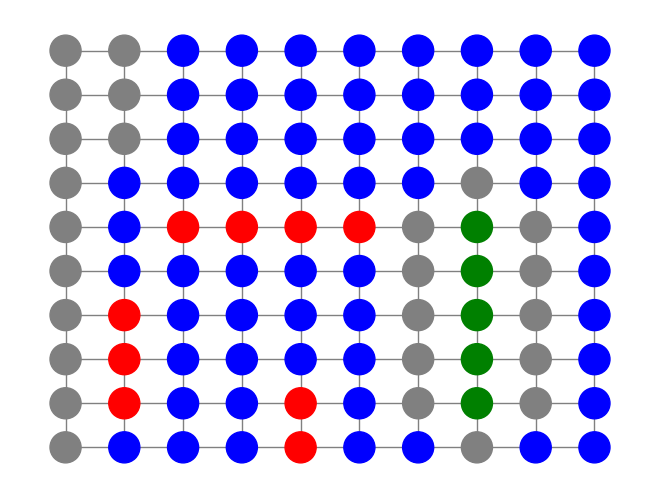

Dijkstra explora: (1, 3) con probabilidad 0.00


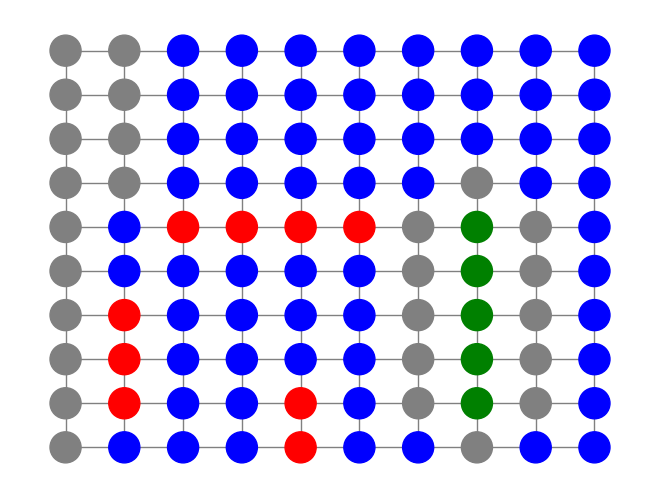

Dijkstra explora: (1, 4) con probabilidad 0.00


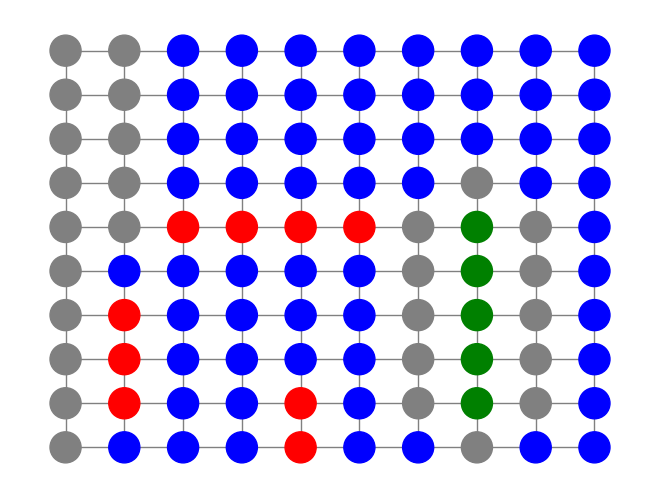

Dijkstra explora: (1, 5) con probabilidad 0.00


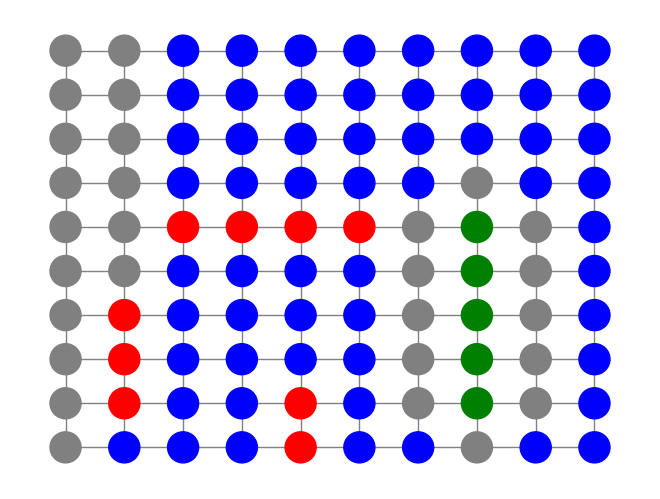

Dijkstra explora: (1, 6) con probabilidad 0.00


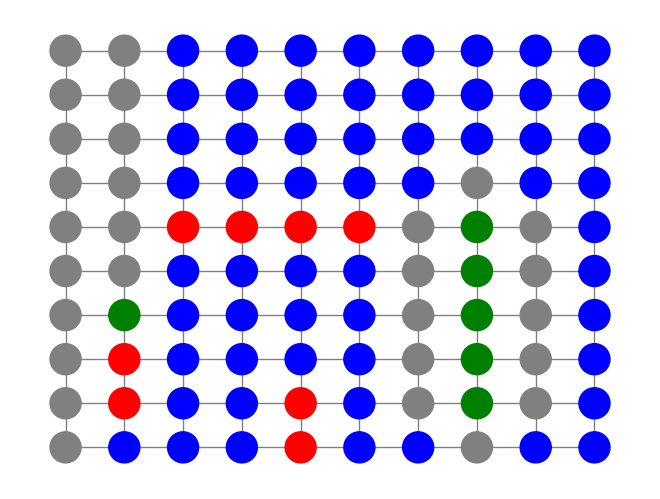

Dijkstra explora: (1, 7) con probabilidad 0.30


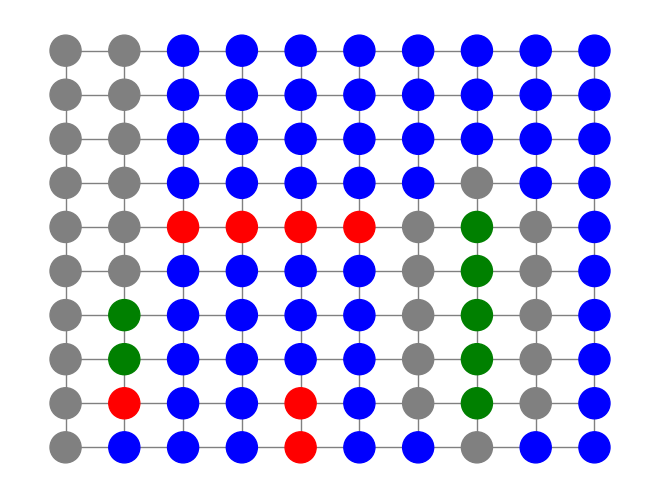

Dijkstra explora: (1, 8) con probabilidad 0.30


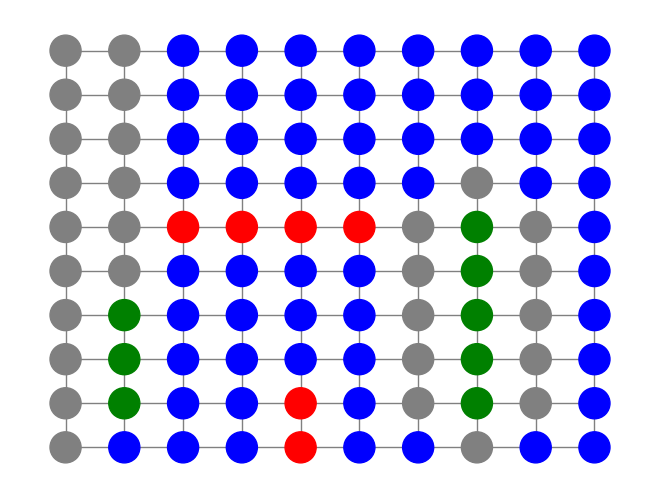

Dijkstra explora: (1, 9) con probabilidad 0.30


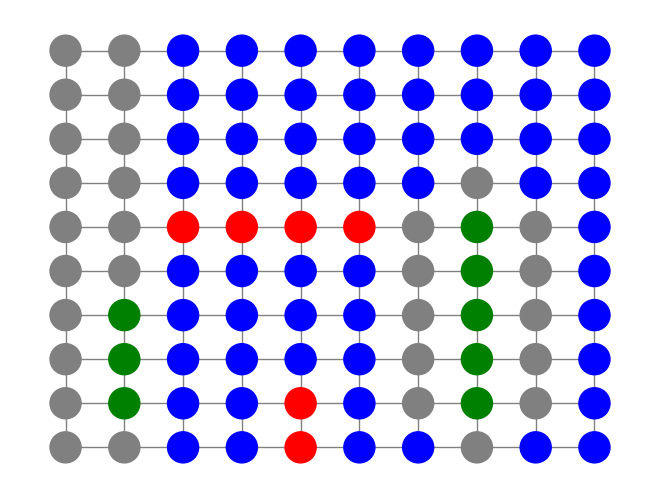

Dijkstra explora: (2, 6) con probabilidad 0.30


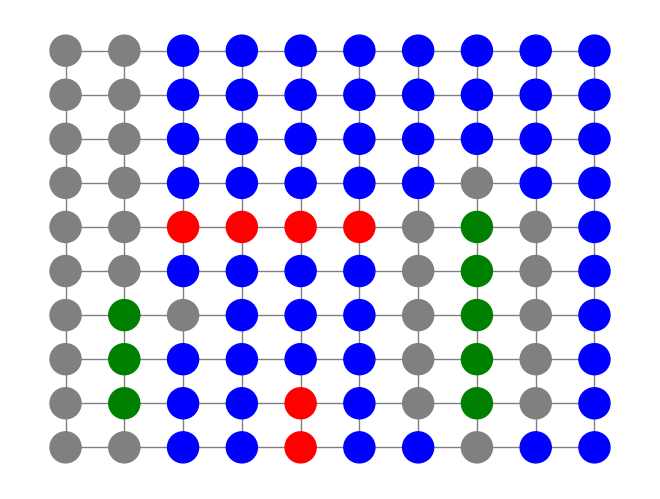

Dijkstra explora: (2, 8) con probabilidad 0.30


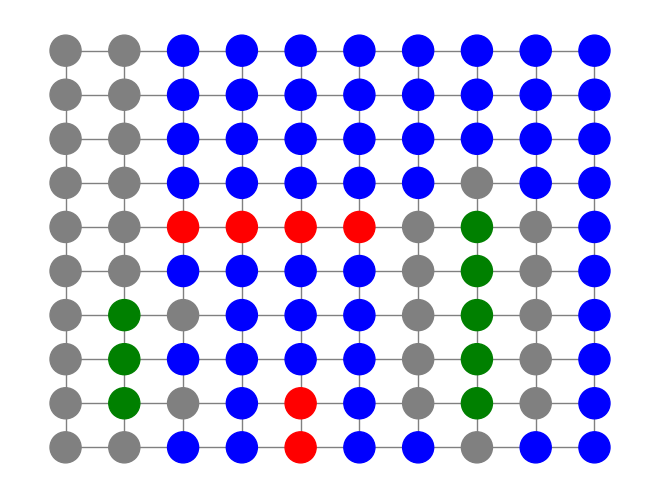

Dijkstra explora: (2, 7) con probabilidad 0.10


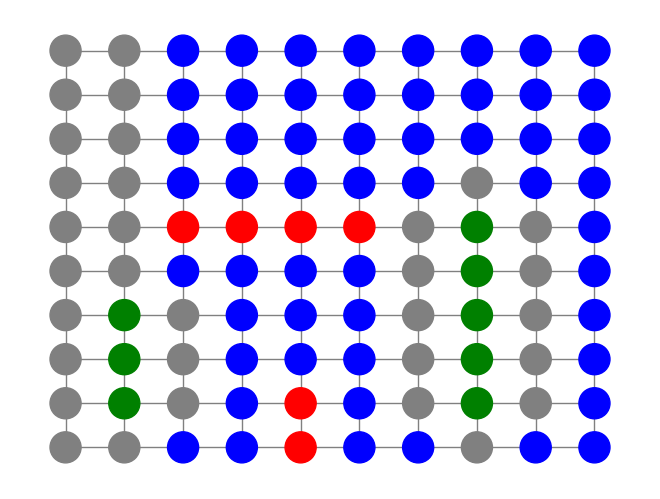

Dijkstra explora: (2, 0) con probabilidad 0.00


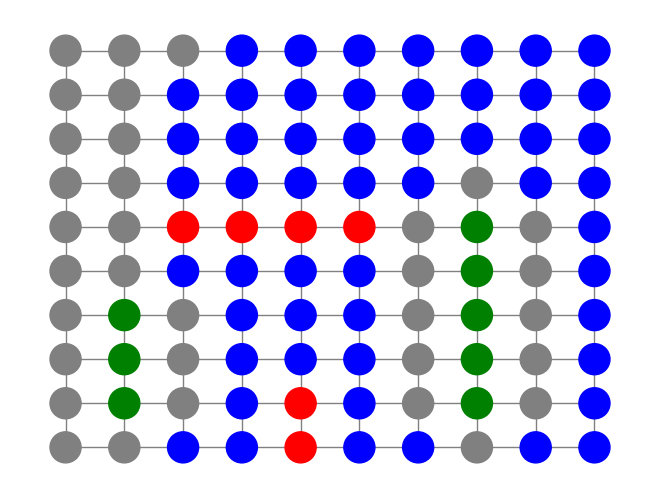

Dijkstra explora: (2, 1) con probabilidad 0.00


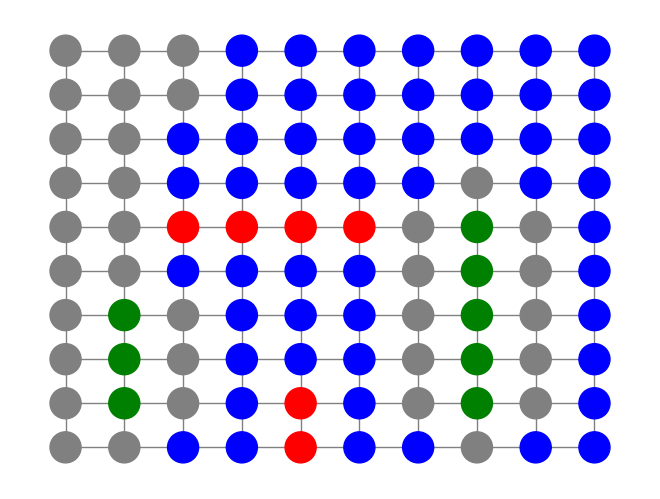

Dijkstra explora: (2, 2) con probabilidad 0.00


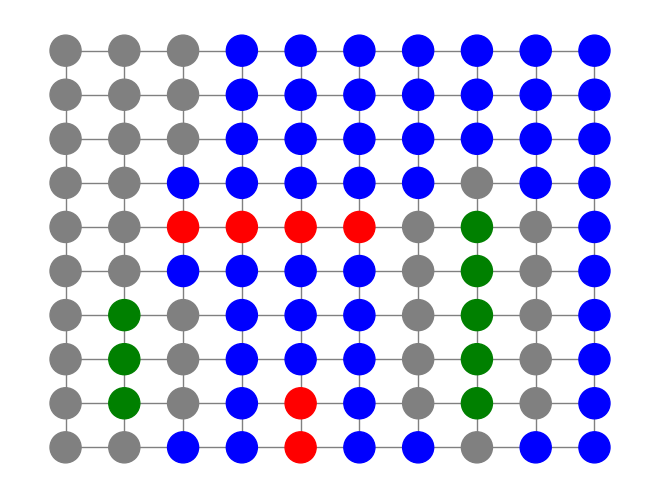

Dijkstra explora: (2, 3) con probabilidad 0.00


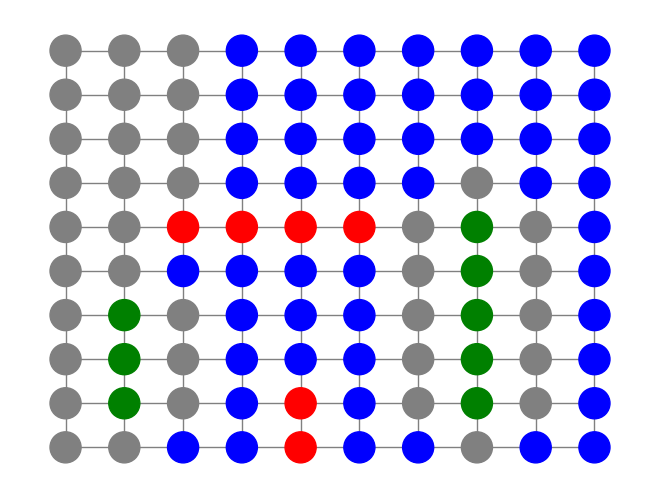

Dijkstra explora: (2, 4) con probabilidad 0.00


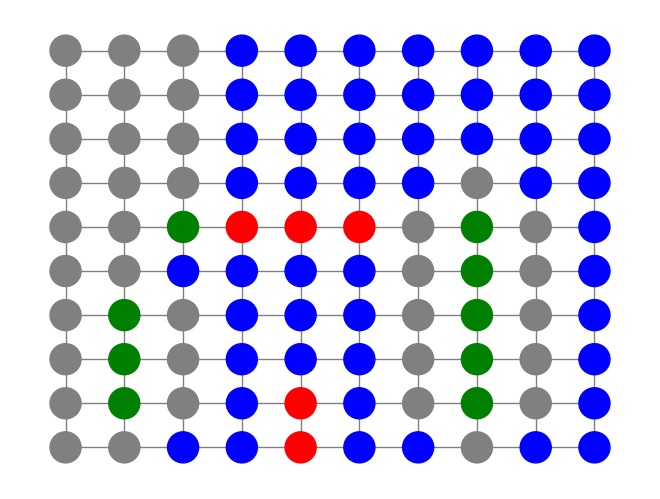

Dijkstra explora: (2, 5) con probabilidad 0.30


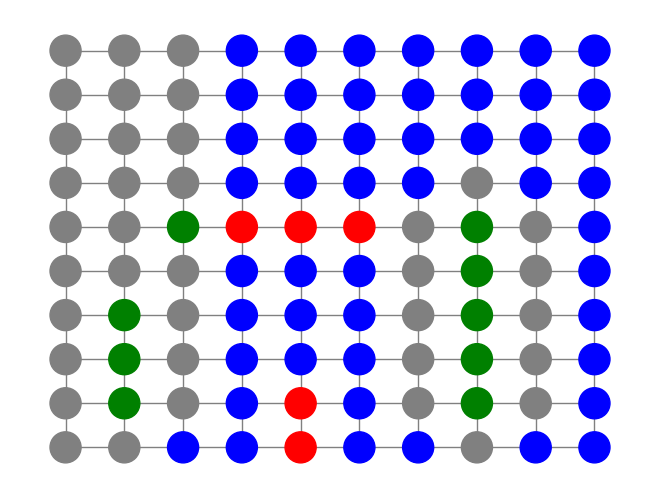

Dijkstra explora: (3, 4) con probabilidad 0.30


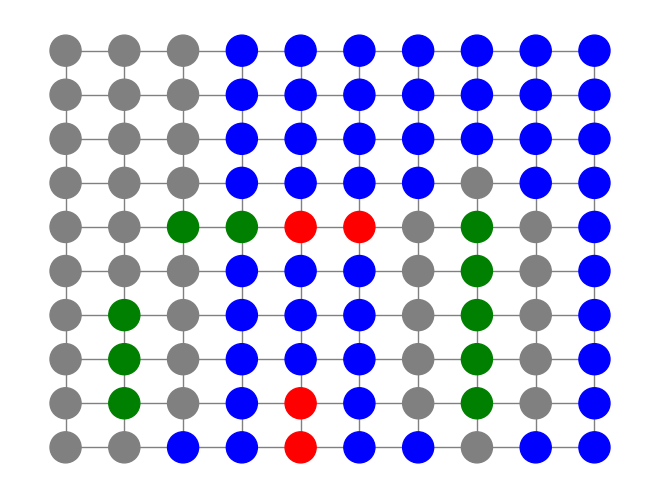

Dijkstra explora: (3, 3) con probabilidad 0.30


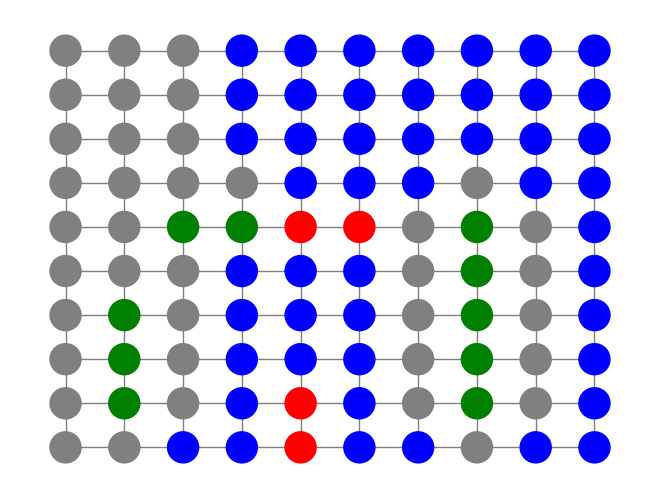

Dijkstra explora: (3, 5) con probabilidad 0.30


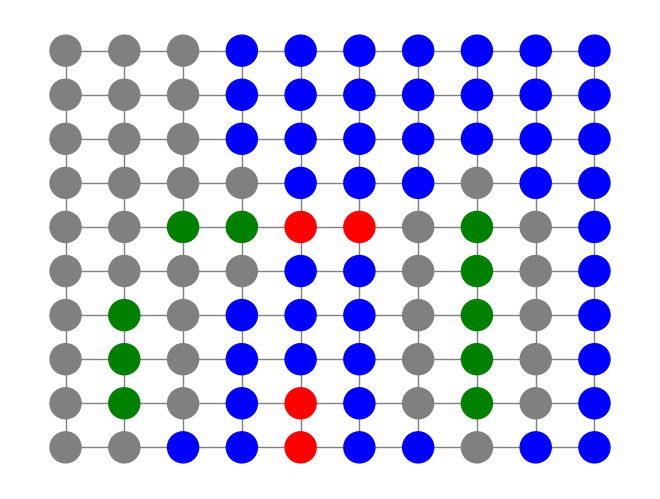

Dijkstra explora: (4, 4) con probabilidad 0.30


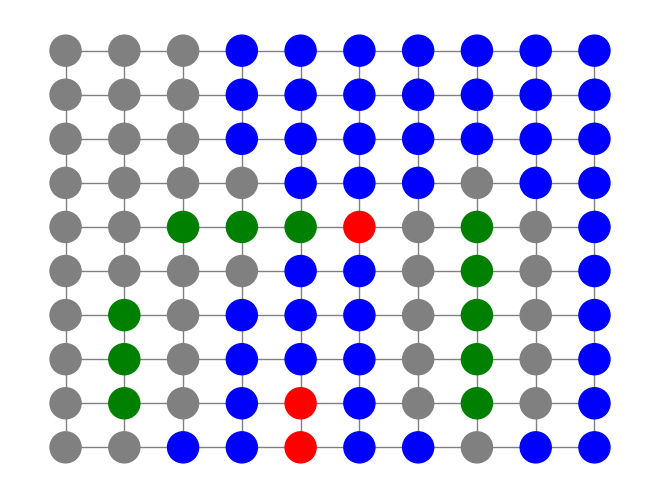

Dijkstra explora: (4, 3) con probabilidad 0.30


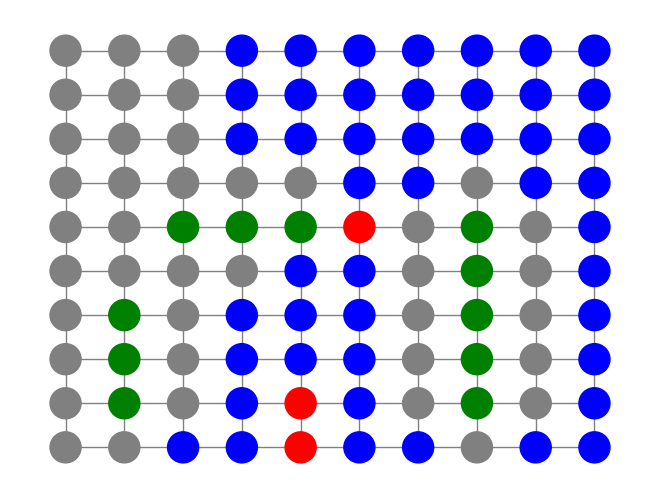

Dijkstra explora: (4, 5) con probabilidad 0.30


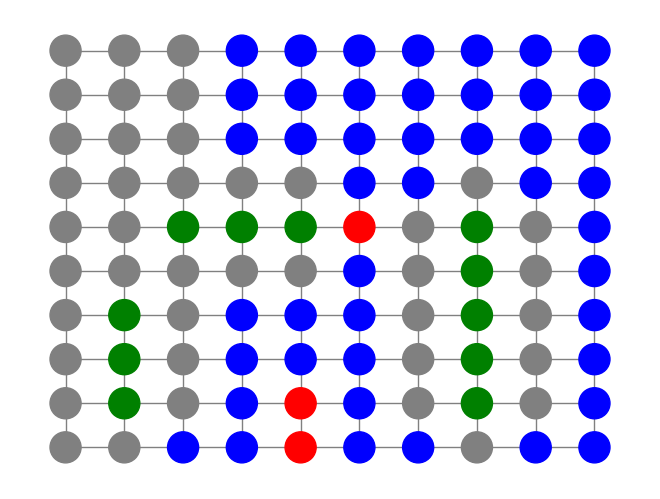

Dijkstra explora: (5, 4) con probabilidad 0.30


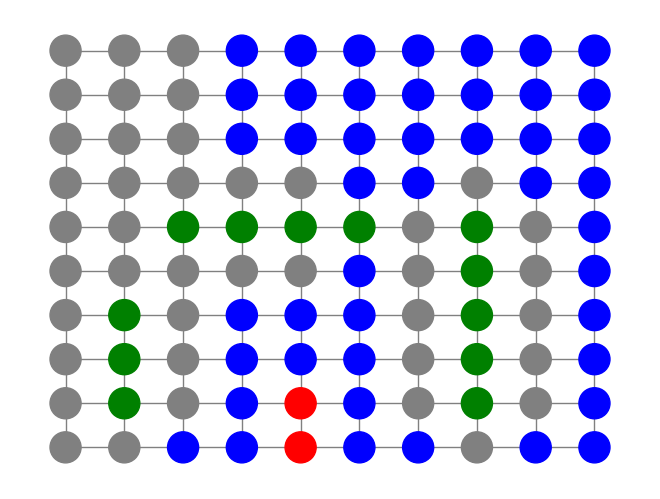

Dijkstra explora: (5, 3) con probabilidad 0.30


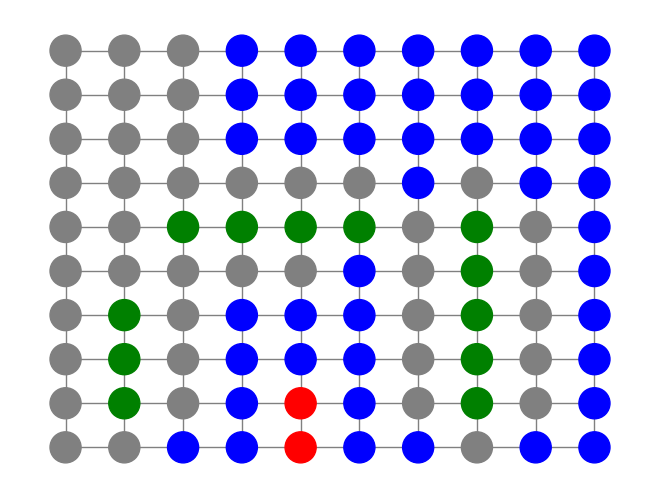

Dijkstra explora: (5, 5) con probabilidad 0.30


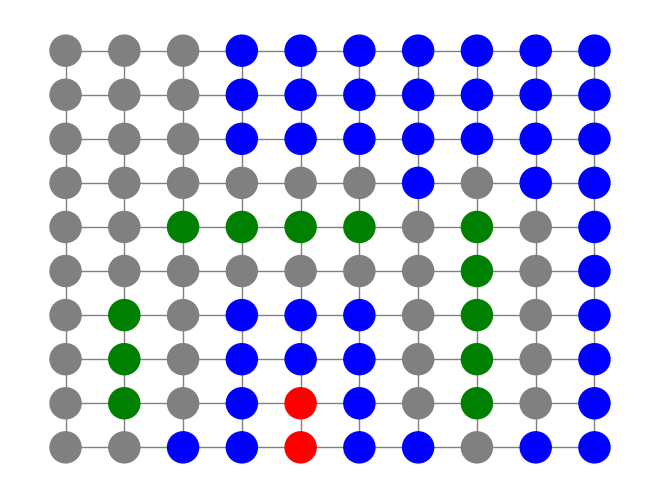

Dijkstra explora: (2, 9) con probabilidad 0.00


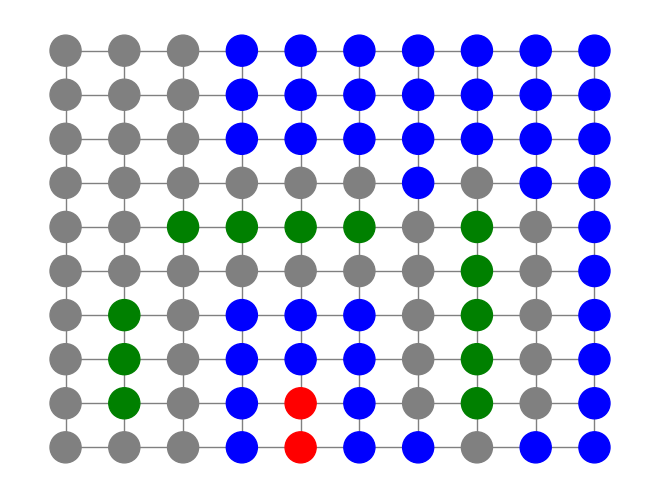

Dijkstra explora: (3, 0) con probabilidad 0.00


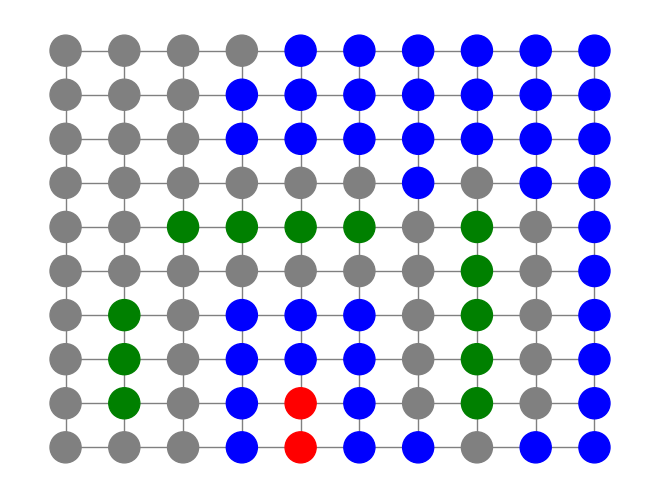

Dijkstra explora: (3, 1) con probabilidad 0.00


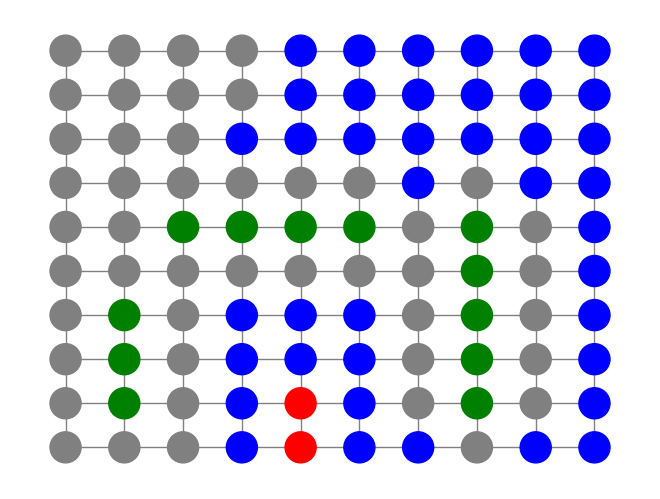

Dijkstra explora: (3, 2) con probabilidad 0.00


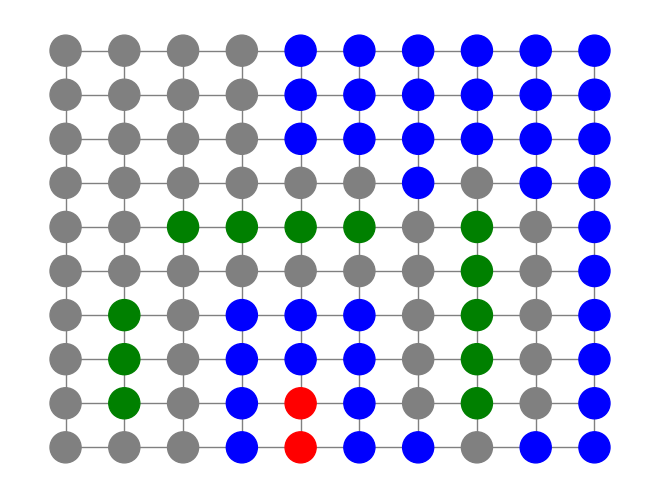

Dijkstra explora: (3, 6) con probabilidad 0.00


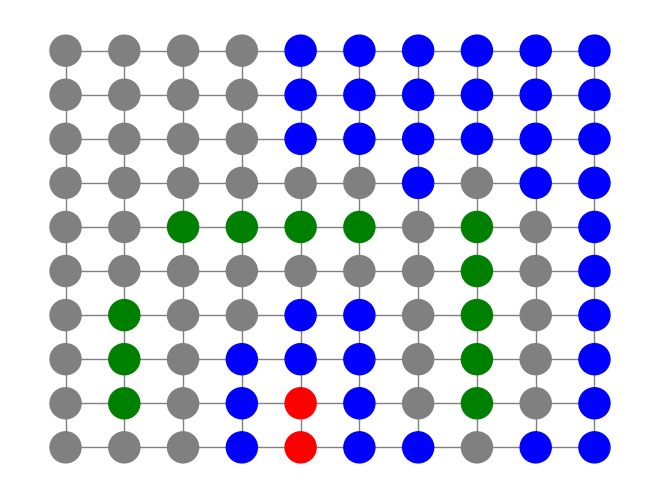

Dijkstra explora: (3, 7) con probabilidad 0.00


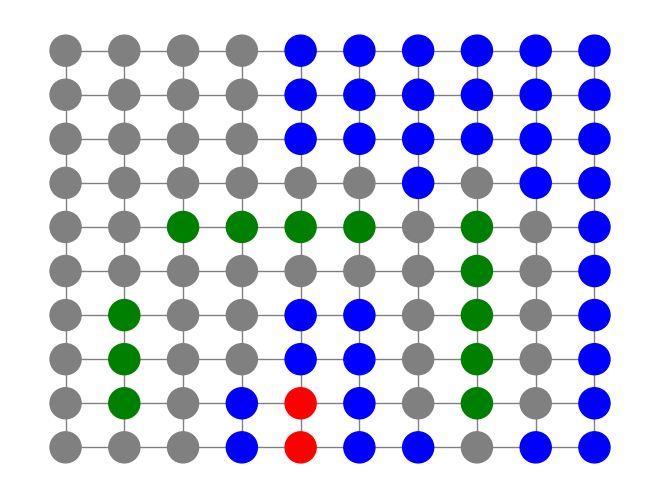

Dijkstra explora: (3, 8) con probabilidad 0.00


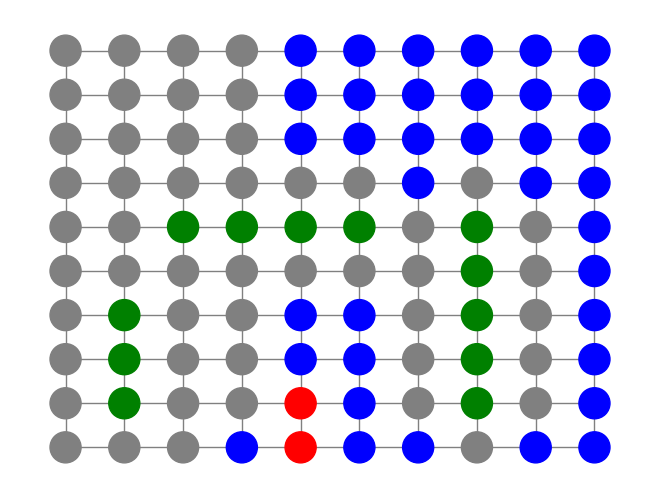

Dijkstra explora: (3, 9) con probabilidad 0.00


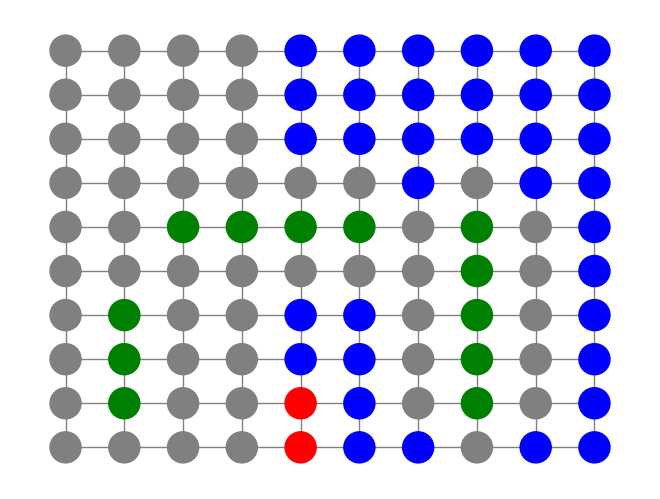

Dijkstra explora: (4, 0) con probabilidad 0.00


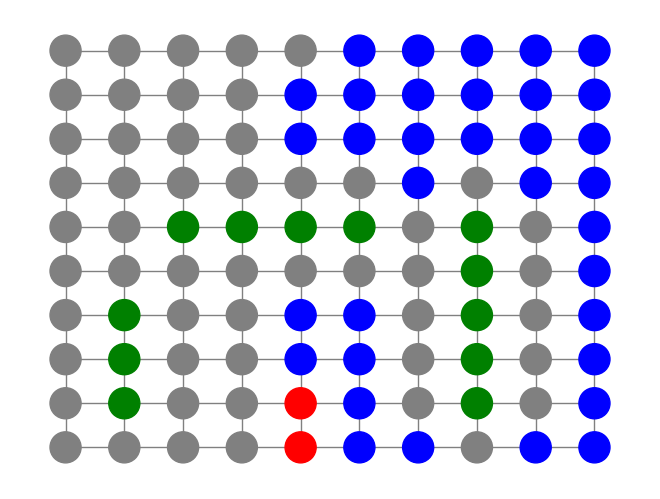

Dijkstra explora: (4, 1) con probabilidad 0.00


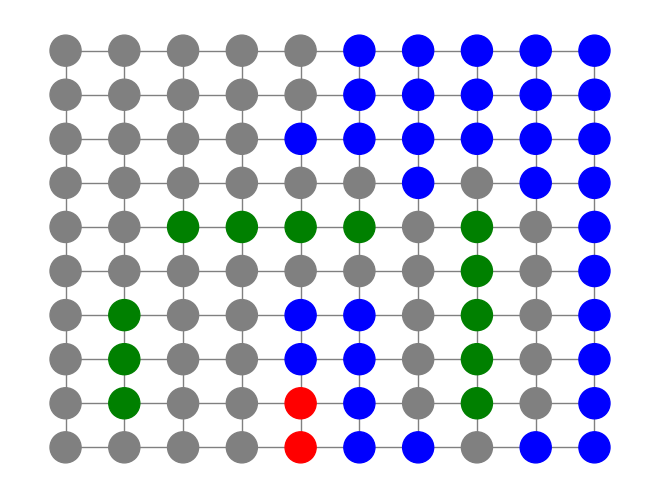

Dijkstra explora: (4, 2) con probabilidad 0.00


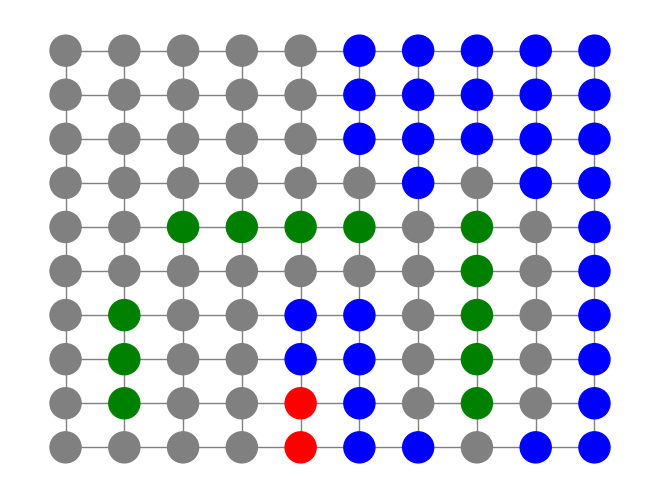

Dijkstra explora: (4, 6) con probabilidad 0.00


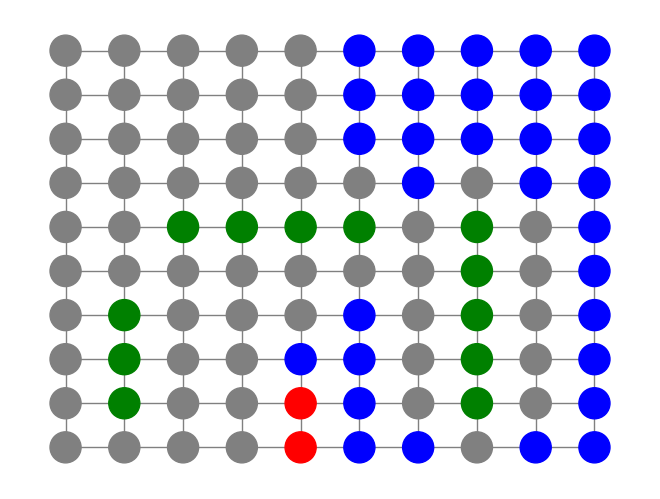

Dijkstra explora: (4, 7) con probabilidad 0.00


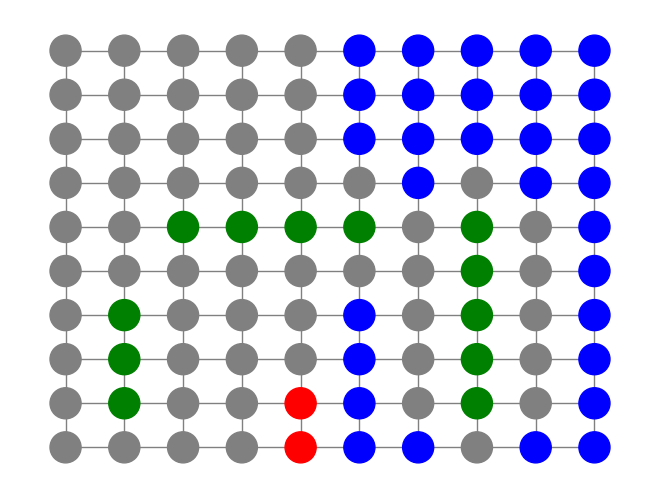

Dijkstra explora: (4, 8) con probabilidad 0.00


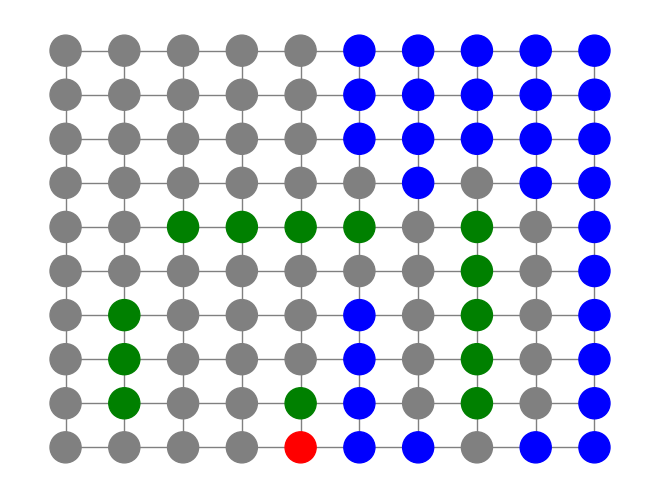

Dijkstra explora: (4, 9) con probabilidad 0.30


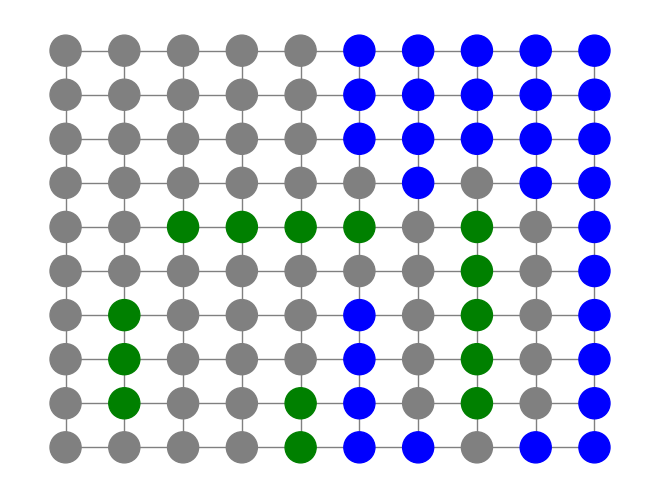


Resultados:
Disparos totales: 2
Tiempo total: 31.32 segundos
Precisión: 700.00%


In [ ]:
import networkx as nx
import matplotlib.pyplot as plt
import random
from collections import deque
import heapq
import time

# =======================
# Configuración del tablero
# =======================
def crear_tablero(tamaño=10):
    tablero = nx.grid_2d_graph(tamaño, tamaño)
    nx.set_node_attributes(tablero, 'azul', 'color')  # Color inicial de las casillas
    nx.set_node_attributes(tablero, None, 'barco')   # Indica si el nodo contiene un barco
    nx.set_node_attributes(tablero, 0.0, 'probabilidad')  # Probabilidad inicial de 0
    return tablero

def mostrar_tablero(tablero):
    color_map = {
        'azul': 'blue',
        'rojo': 'red',
        'verde': 'green',
        'gris': 'gray',
        'amarillo': 'yellow',
        'naranja': 'orange',
        'morado': 'purple',
        'cian': 'cyan'
    }
    colores = [color_map[tablero.nodes[nodo]['color']] for nodo in tablero.nodes()]
    pos = {(x, y): (x, -y) for x, y in tablero.nodes()}
    plt.clf()
    nx.draw(tablero, pos, node_color=colores, with_labels=False, node_size=500, edge_color='gray')
    plt.pause(0.1)

def reiniciar_colores(tablero):
    for nodo in tablero.nodes():
        if tablero.nodes[nodo]['barco']:
            tablero.nodes[nodo]['color'] = 'rojo'
        else:
            tablero.nodes[nodo]['color'] = 'azul'

# =======================
# Colocación de barcos con restricciones
# =======================
def verificar_adyacencia(tablero, nodos):
    for nodo in nodos:
        vecinos = list(tablero.neighbors(nodo))
        for vecino in vecinos:
            if tablero.nodes[vecino]['barco']:
                return False
    return True

def colocar_barco_optimo(tablero, tamaño, color_barco):
    while True:
        orientacion = random.choice(['horizontal', 'vertical'])
        x, y = random.randint(0, 9), random.randint(0, 9)

        if orientacion == 'horizontal' and x + tamaño <= 10:
            nodos = [(x + i, y) for i in range(tamaño)]
        elif orientacion == 'vertical' and y + tamaño <= 10:
            nodos = [(x, y + i) for i in range(tamaño)]
        else:
            continue

        if all(tablero.nodes[nodo]['color'] == 'azul' for nodo in nodos) and verificar_adyacencia(tablero, nodos):
            for nodo in nodos:
                tablero.nodes[nodo]['color'] = color_barco
                tablero.nodes[nodo]['barco'] = True
            break

# =======================
# Actualización de probabilidades
# =======================
def actualizar_probabilidades(tablero, disparo, impacto):
    """
    Actualiza las probabilidades de los nodos adyacentes según el resultado del disparo.
    """
    for vecino in tablero.neighbors(disparo):
        if impacto:
            tablero.nodes[vecino]['probabilidad'] += 0.3  # Incrementar si hay impacto
        else:
            tablero.nodes[vecino]['probabilidad'] -= 0.1  # Reducir si no hay impacto
        # Limitar la probabilidad entre 0 y 1
        tablero.nodes[vecino]['probabilidad'] = max(0.0, min(1.0, tablero.nodes[vecino]['probabilidad']))

def dijkstra_para_barcos(tablero, visitados, casillas_pendientes, partes_encontradas, total_partes_barcos):
    """
    Dijkstra para seleccionar el siguiente nodo a explorar basado en probabilidades dinámicas.
    """
    while partes_encontradas < total_partes_barcos:  # Solo sigue mientras no haya encontrado todas las partes
        probabilidades = nx.get_node_attributes(tablero, 'probabilidad')
        heap = [(-prob, nodo) for nodo, prob in probabilidades.items() if nodo not in visitados]  # Prioridad inversa
        heapq.heapify(heap)

        if not heap:  # Si no hay nodos restantes con probabilidades positivas
            break

        prob, nodo_actual = heapq.heappop(heap)
        prob = -prob  # Revertir el signo para obtener la probabilidad positiva
        print(f"Dijkstra explora: {nodo_actual} con probabilidad {prob:.2f}")

        if nodo_actual not in visitados:
            visitados.add(nodo_actual)

            if tablero.nodes[nodo_actual]['barco']:
                tablero.nodes[nodo_actual]['color'] = 'verde'
                casillas_pendientes.append(nodo_actual)
                actualizar_probabilidades(tablero, nodo_actual, impacto=True)
                partes_encontradas += 1
            else:
                tablero.nodes[nodo_actual]['color'] = 'gris'
                actualizar_probabilidades(tablero, nodo_actual, impacto=False)

            mostrar_tablero(tablero)

    return partes_encontradas

# =======================
# Algoritmo principal
# =======================
def ataque(tablero, estrategia):
    visitados = set()
    casillas_pendientes = deque()
    total_partes_barcos = sum(1 for nodo in tablero.nodes if tablero.nodes[nodo]['barco'])
    partes_encontradas = 0
    disparos = 0
    inicio_tiempo = time.time()

    plt.figure()

    while partes_encontradas < total_partes_barcos:
        if casillas_pendientes:
            inicio = casillas_pendientes.popleft()
            if estrategia == 'Dijkstra':
                partes_encontradas = dijkstra_para_barcos(tablero, visitados, casillas_pendientes, partes_encontradas, total_partes_barcos)
        else:
            disparo = disparo_aleatorio(tablero, visitados)
            if disparo:
                disparos += 1
                visitados.add(disparo)
                impacto = tablero.nodes[disparo]['barco']
                actualizar_probabilidades(tablero, disparo, impacto)
                if impacto:
                    tablero.nodes[disparo]['color'] = 'verde'
                    casillas_pendientes.append(disparo)
                    partes_encontradas += 1
                else:
                    tablero.nodes[disparo]['color'] = 'gris'
                mostrar_tablero(tablero)

    tiempo_total = time.time() - inicio_tiempo
    plt.show()
    return disparos, tiempo_total, partes_encontradas / disparos

def disparo_aleatorio(tablero, visitados):
    posibles = [nodo for nodo in tablero.nodes if nodo not in visitados]
    return random.choice(posibles) if posibles else None

# =======================
# Ejecución del programa
# =======================
# Crear tablero y colocar barcos
tablero = crear_tablero()
colores_barcos = ['amarillo', 'naranja', 'morado', 'cian']
tamaños_barcos = [5, 4, 3, 2]
for tamaño, color in zip(tamaños_barcos, colores_barcos):
    colocar_barco_optimo(tablero, tamaño, color)

# Inicializar probabilidades
reiniciar_colores(tablero)

# Ejecutar estrategia Dijkstra
print("\nEstrategia Dijkstra:")
disparos, tiempo_total, precision = ataque(tablero, 'Dijkstra')

# Resultados
print("\nResultados:")
print(f"Disparos totales: {disparos}")
print(f"Tiempo total: {tiempo_total:.2f} segundos")
print(f"Precisión: {precision * 100:.2f}%")



Estrategia BFS:


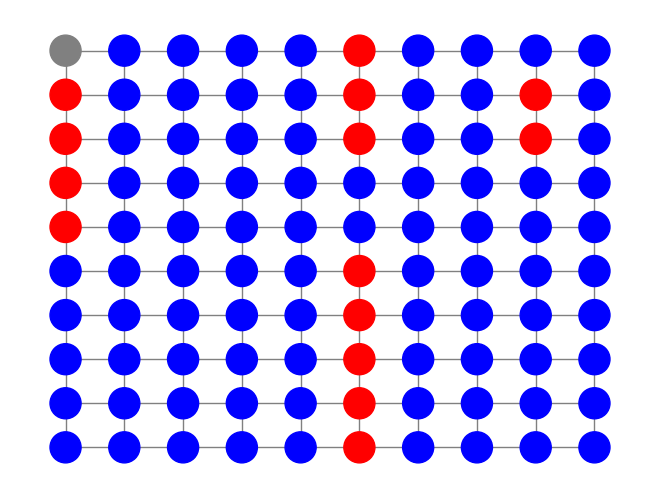

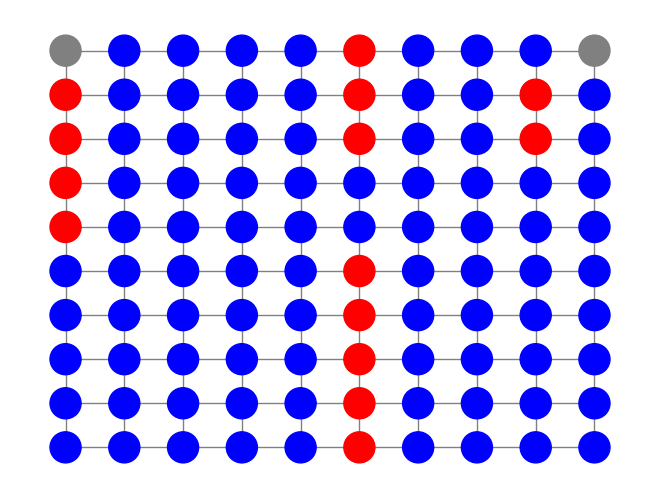

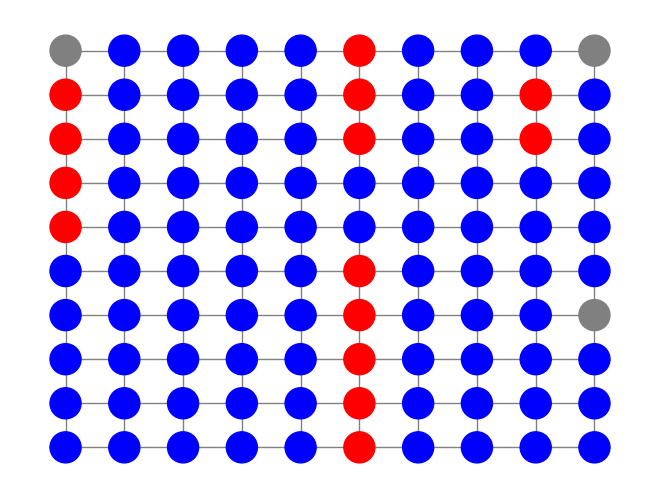

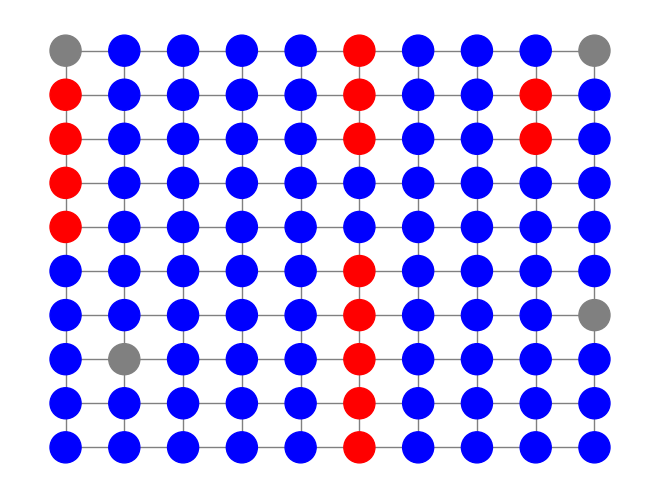

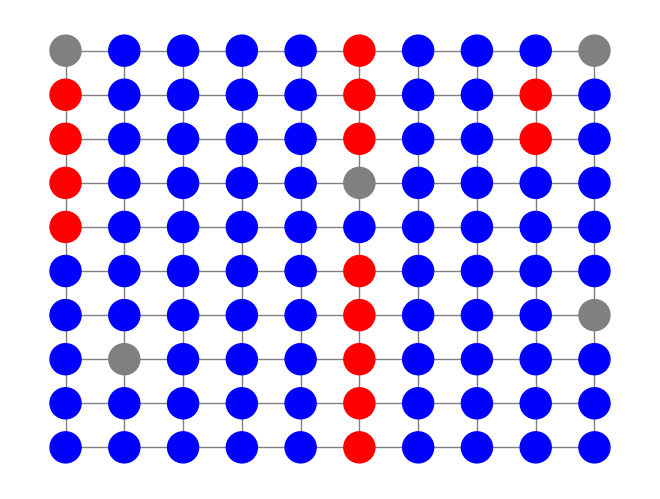

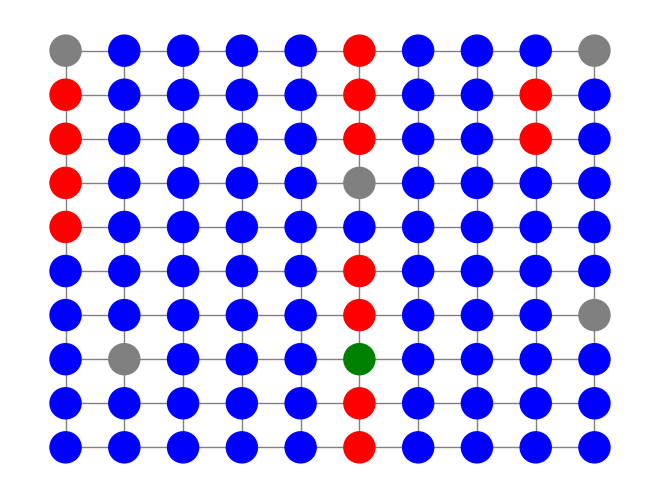

BFS explora: (5, 7)


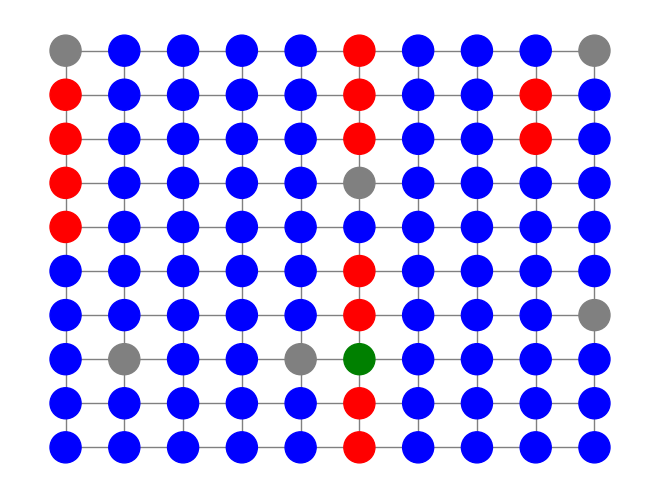

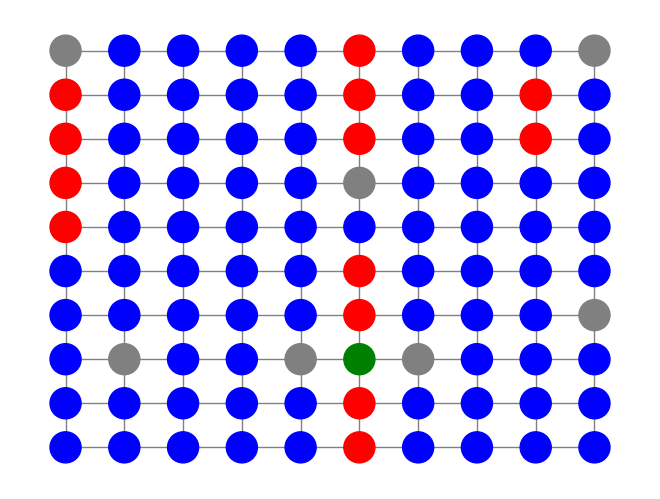

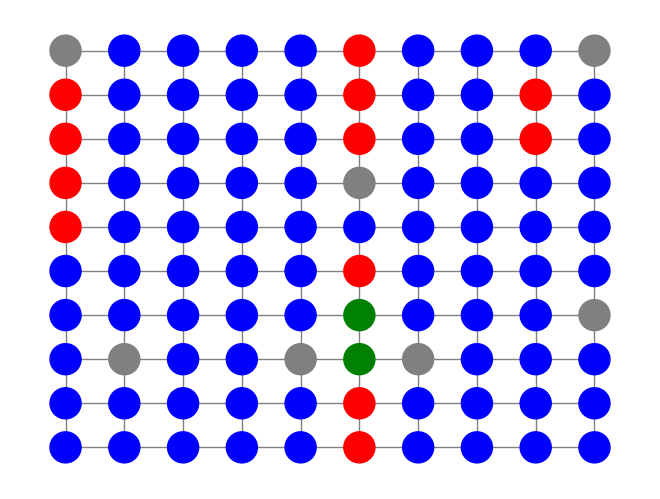

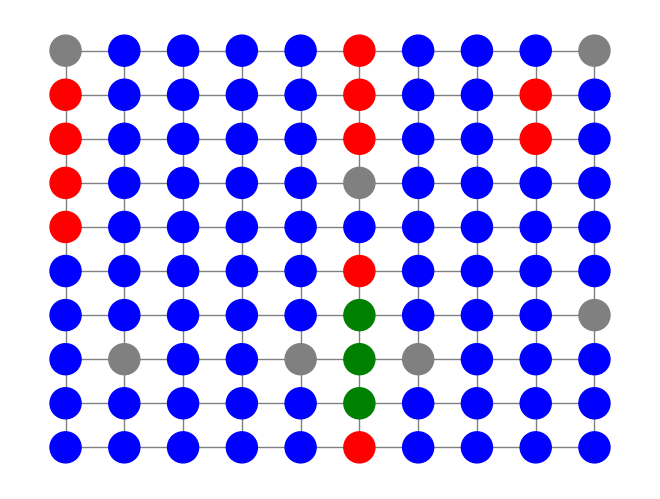

BFS explora: (5, 6)


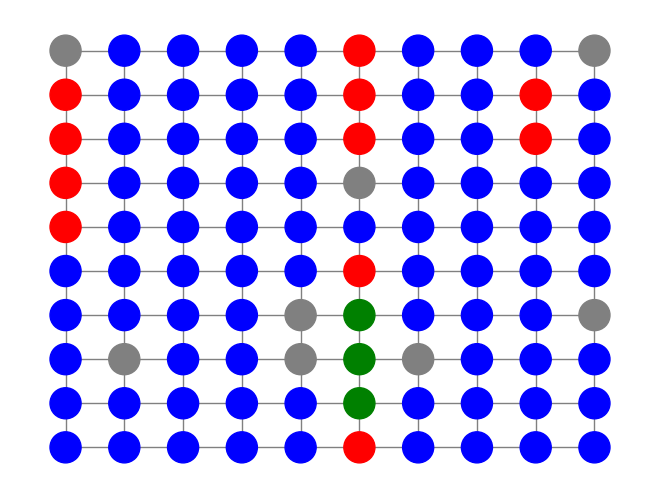

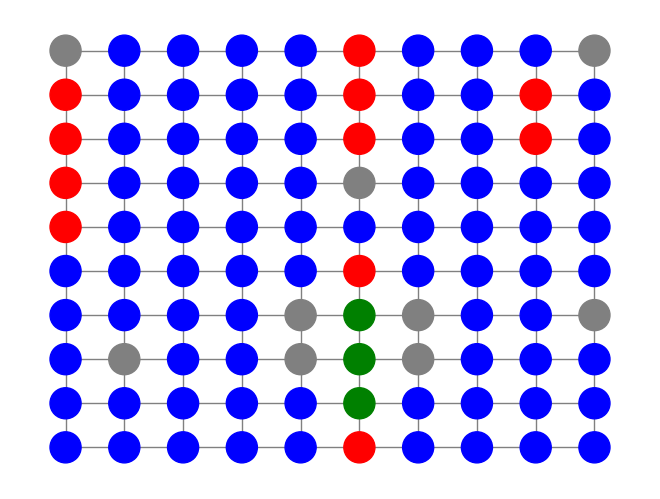

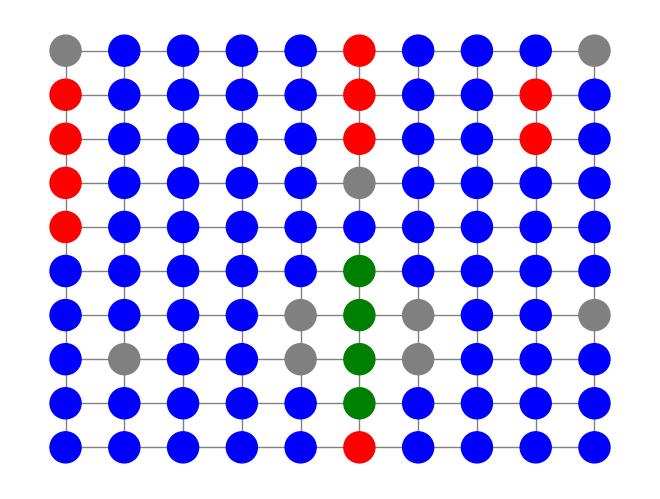

BFS explora: (5, 8)


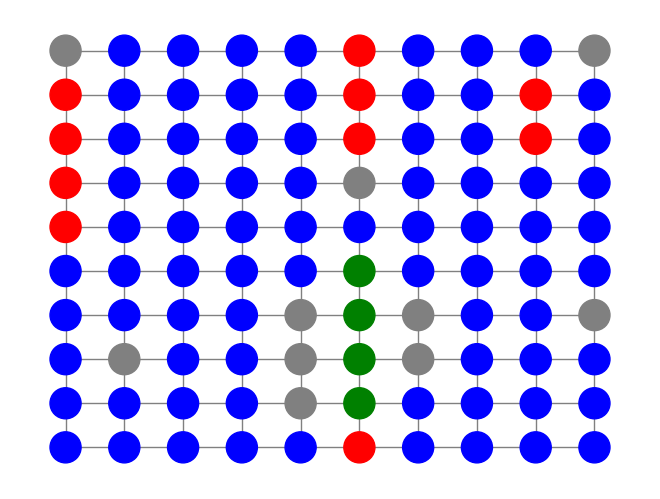

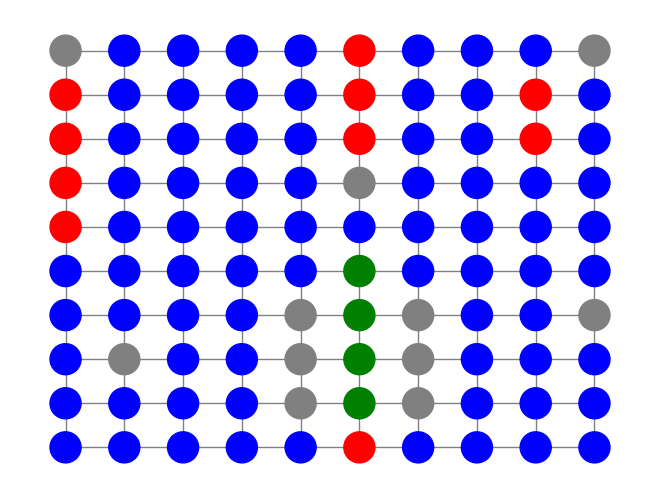

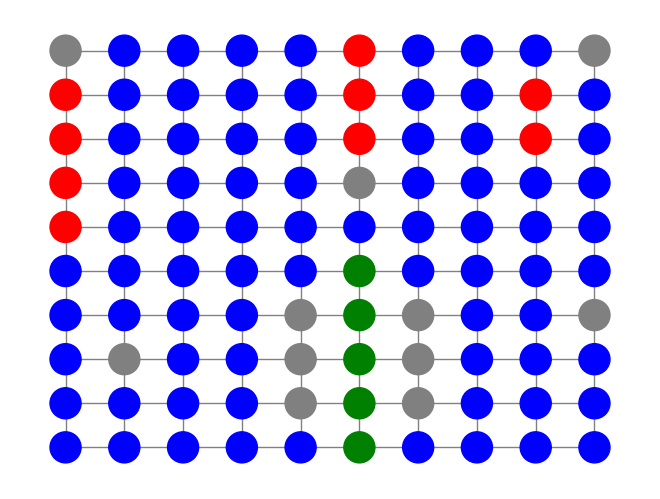

BFS explora: (5, 5)


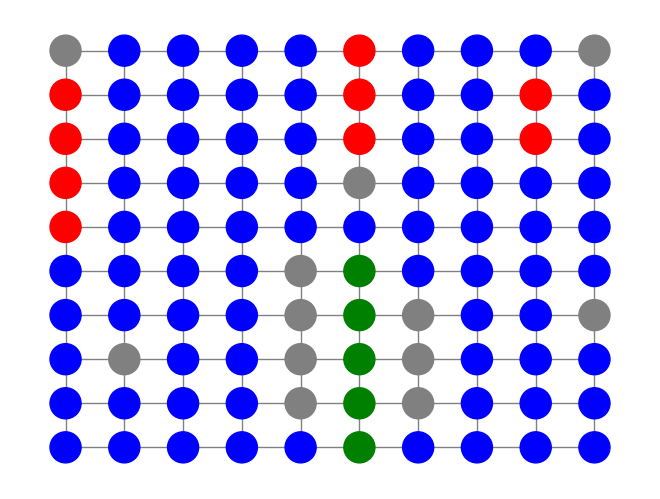

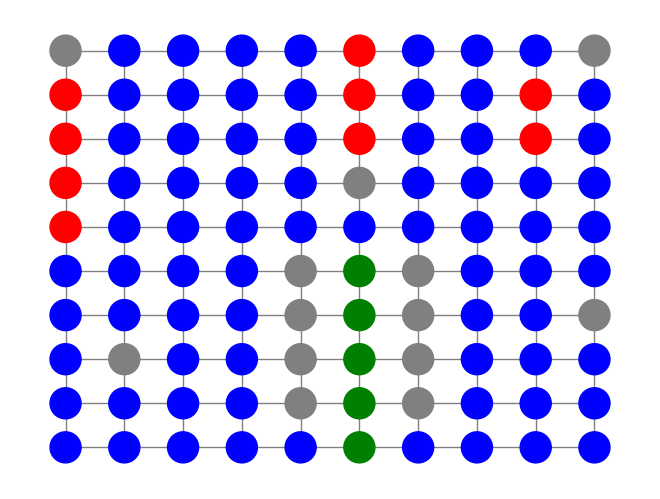

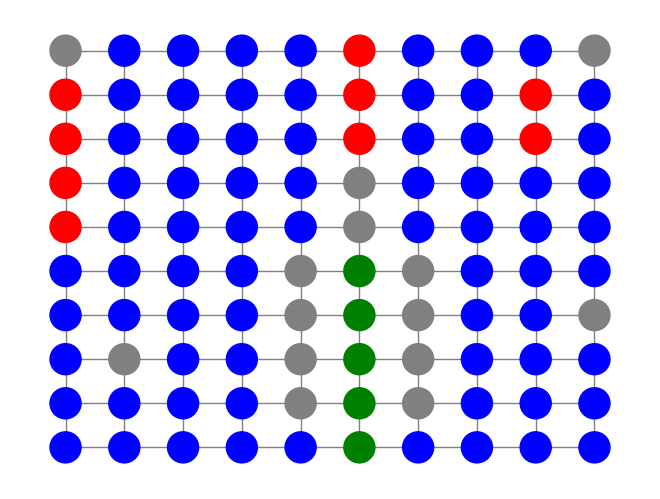

BFS explora: (5, 9)


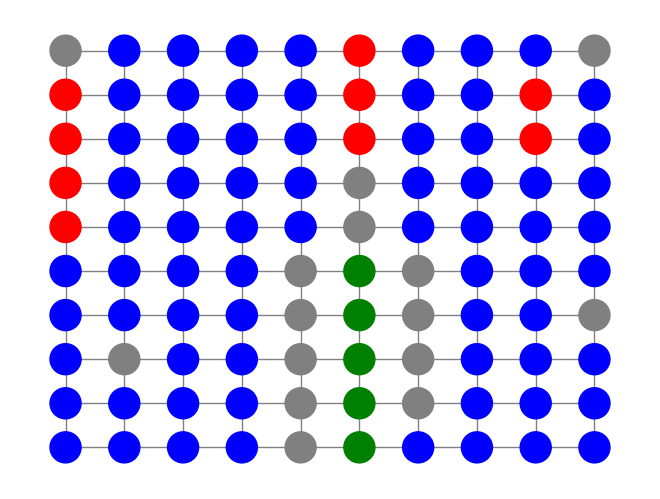

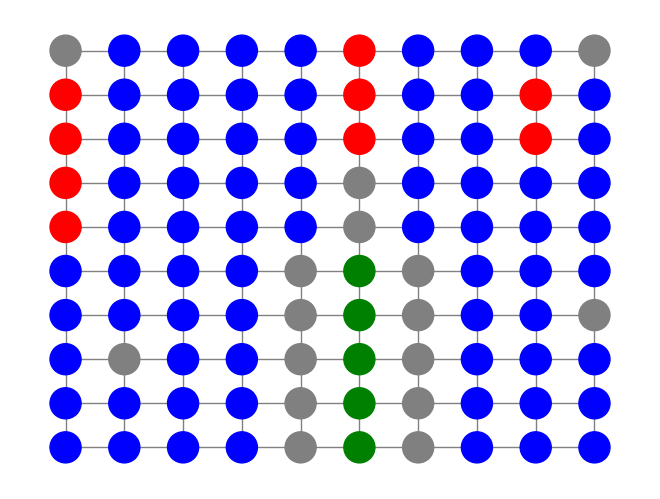

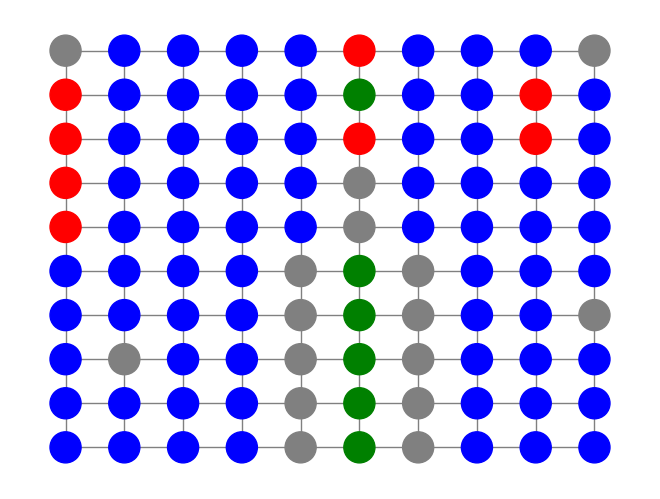

BFS explora: (5, 1)


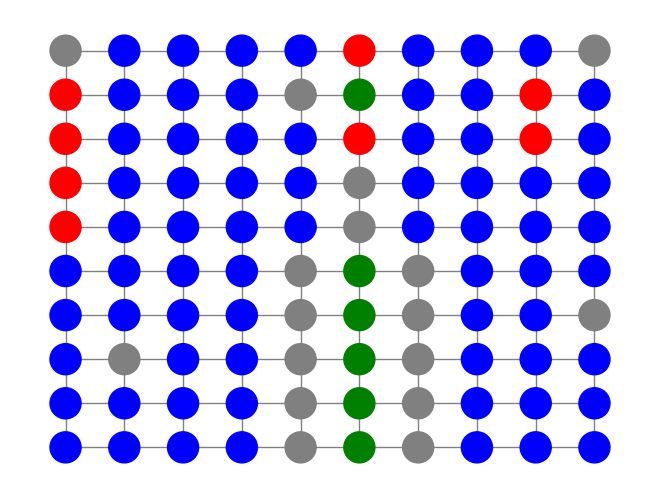

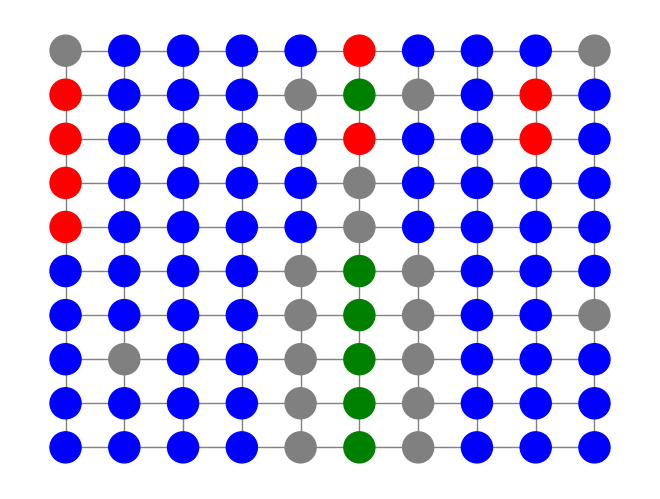

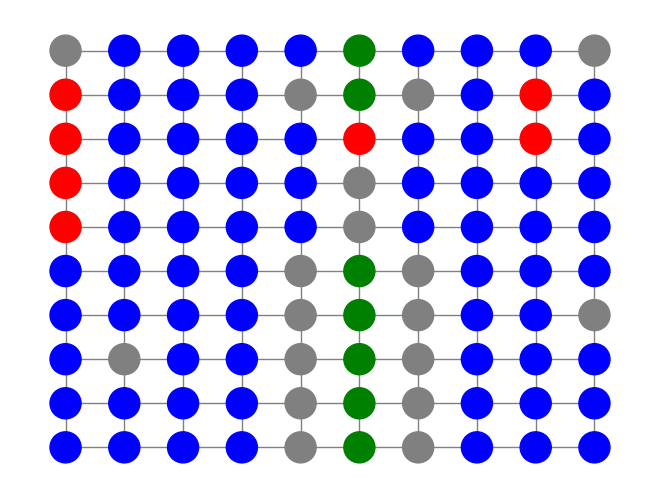

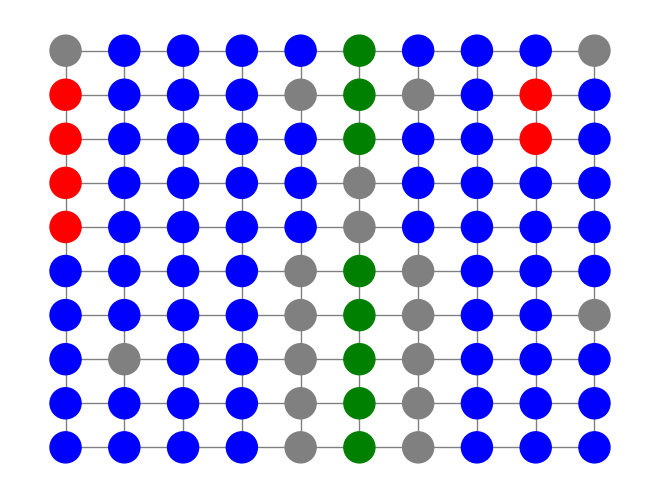

BFS explora: (5, 0)


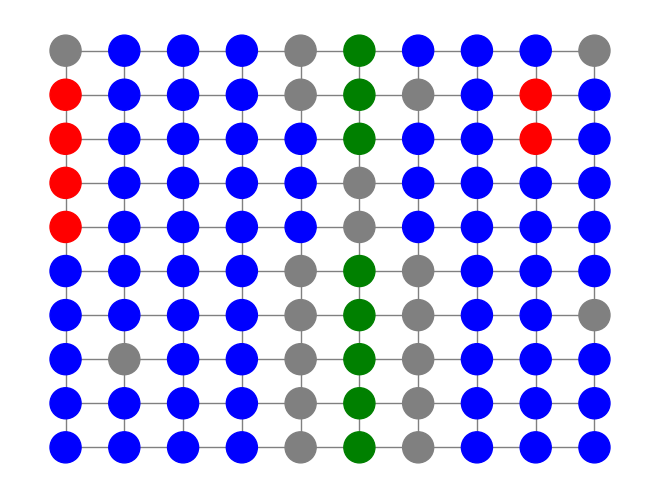

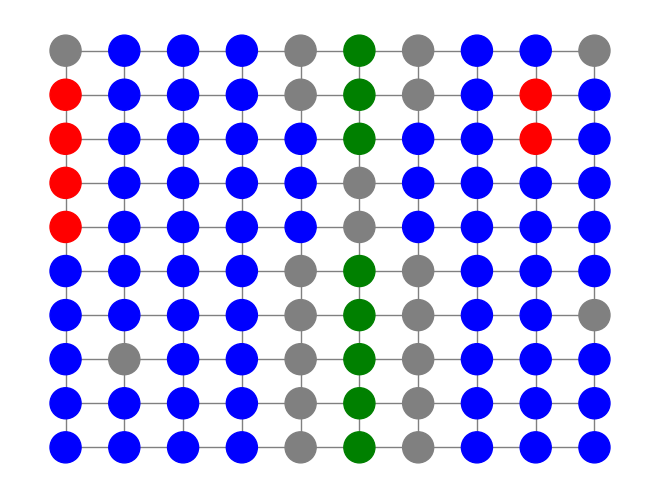

BFS explora: (5, 2)


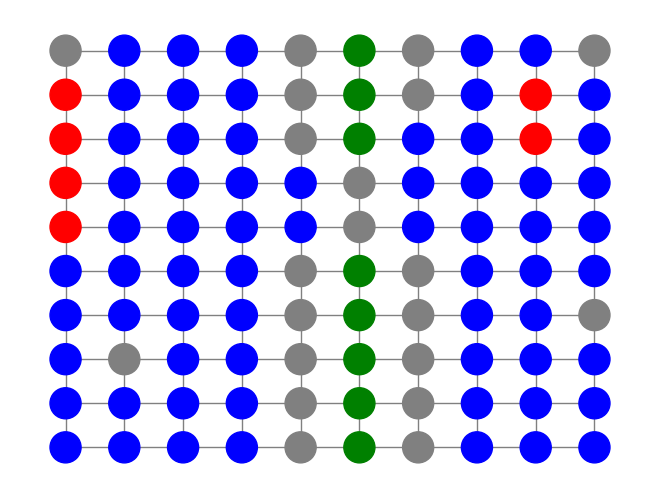

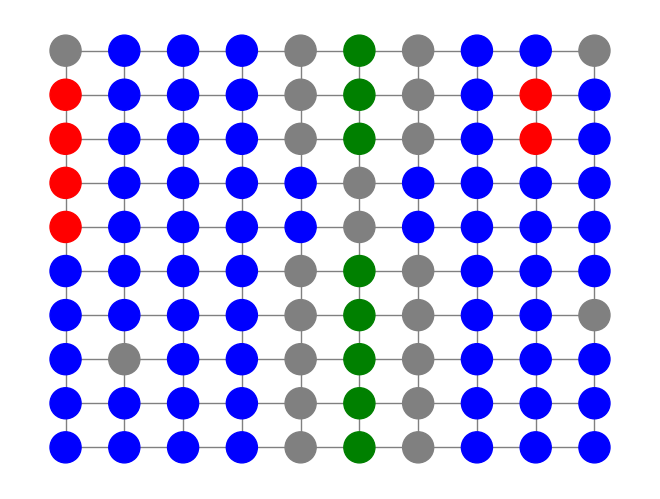

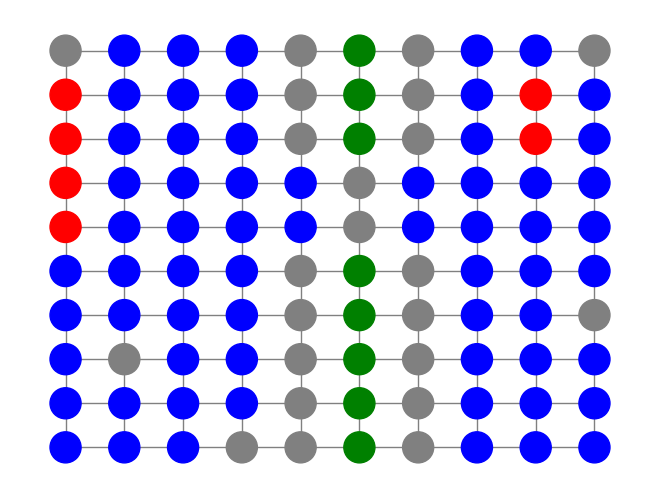

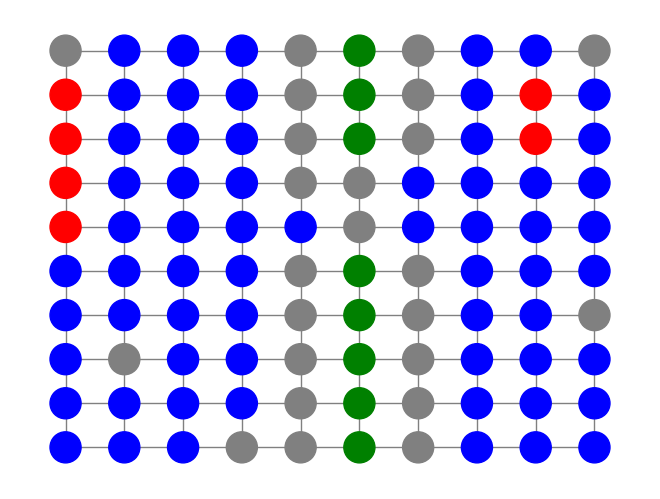

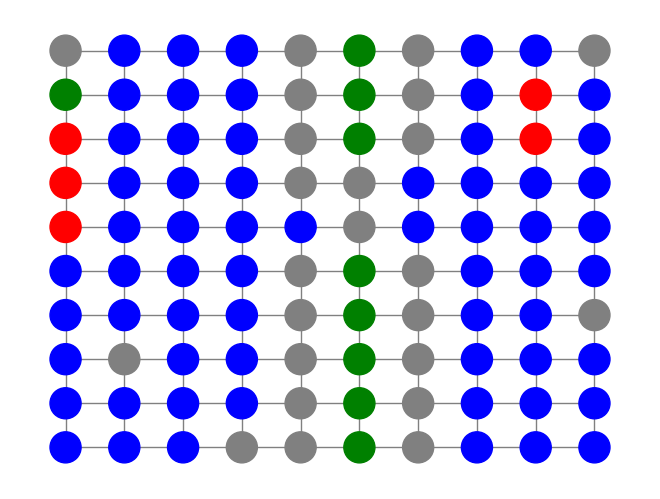

BFS explora: (0, 1)


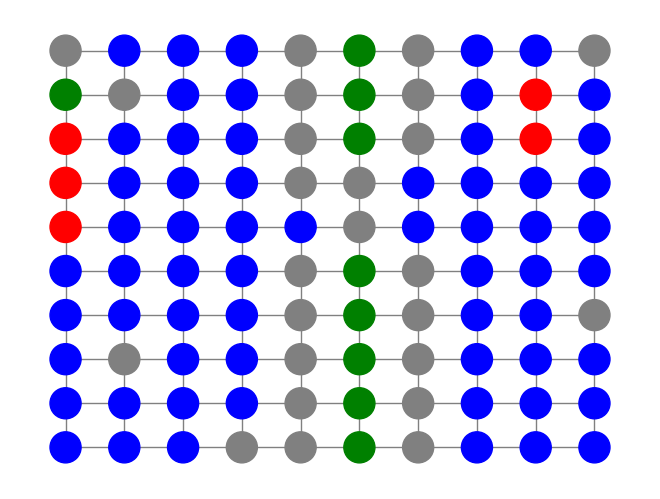

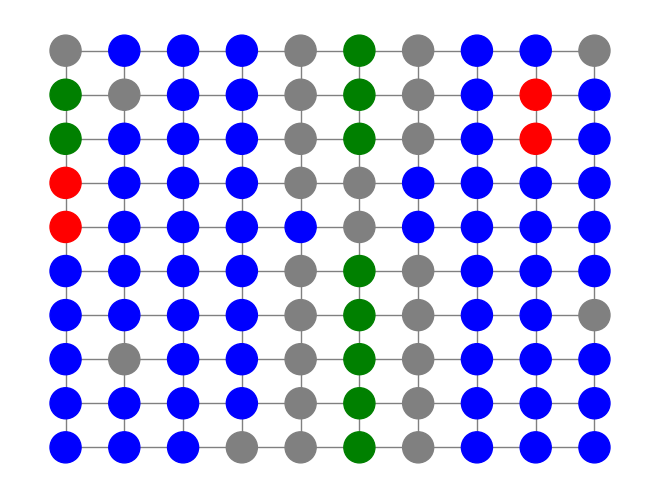

BFS explora: (0, 2)


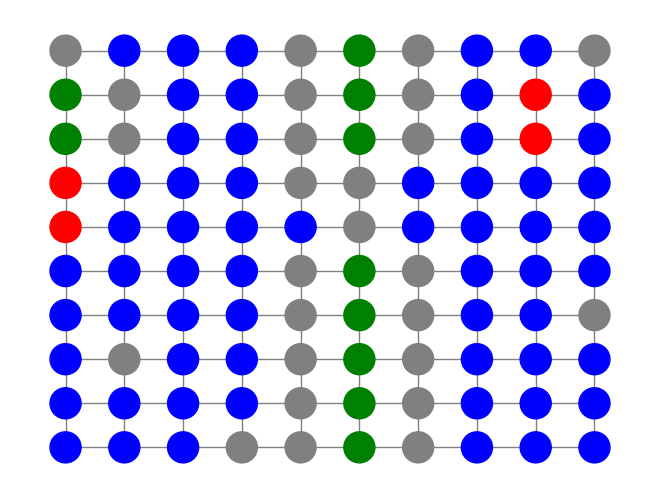

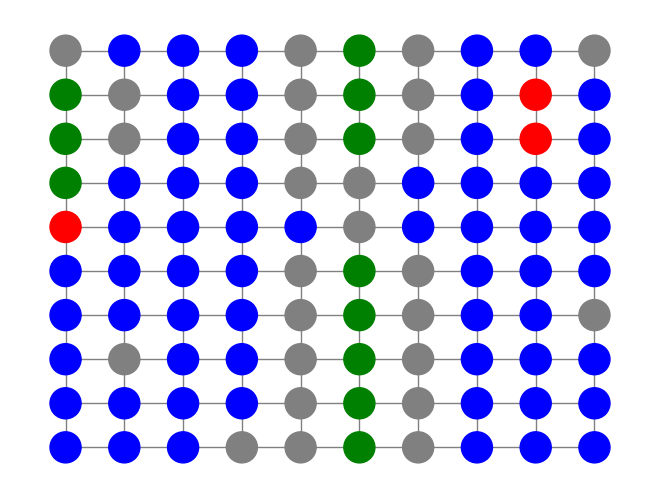

BFS explora: (0, 3)


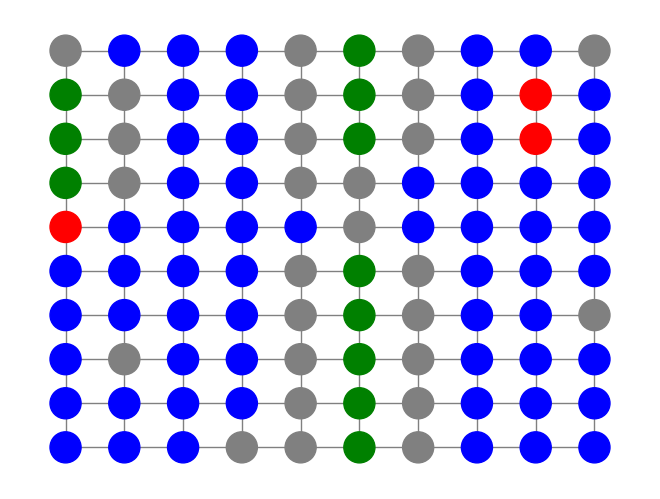

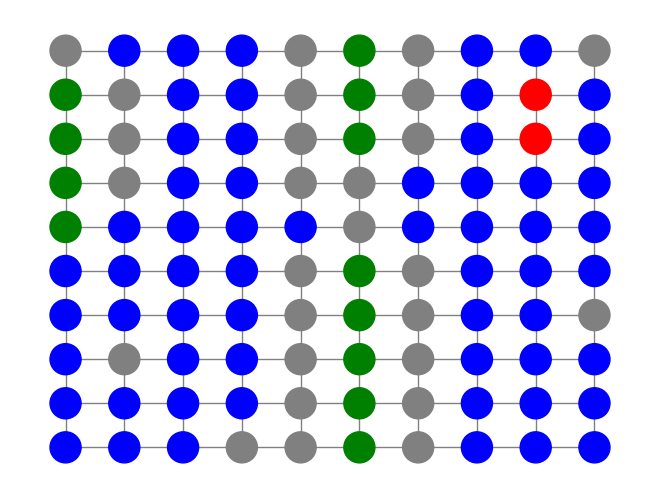

BFS explora: (0, 4)


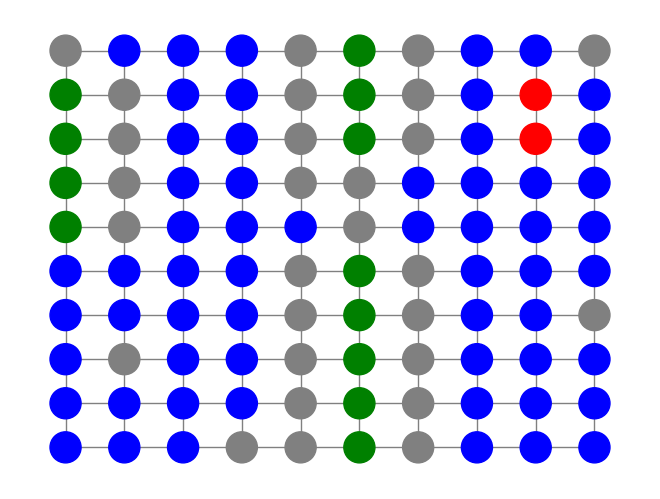

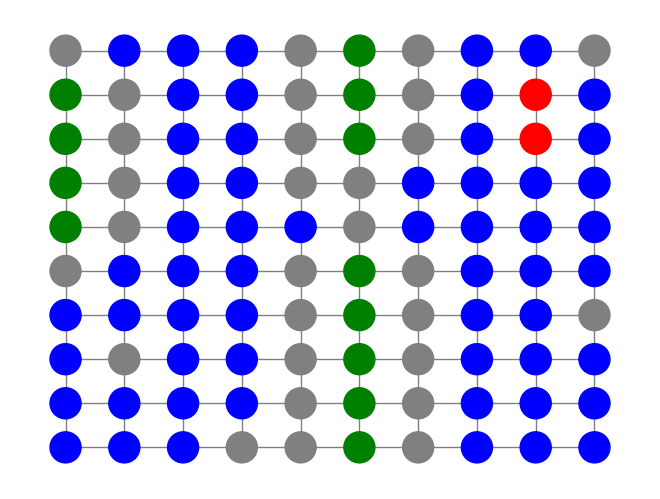

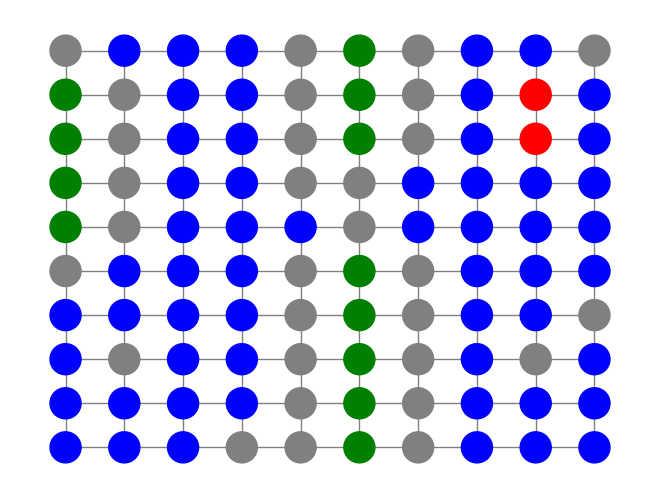

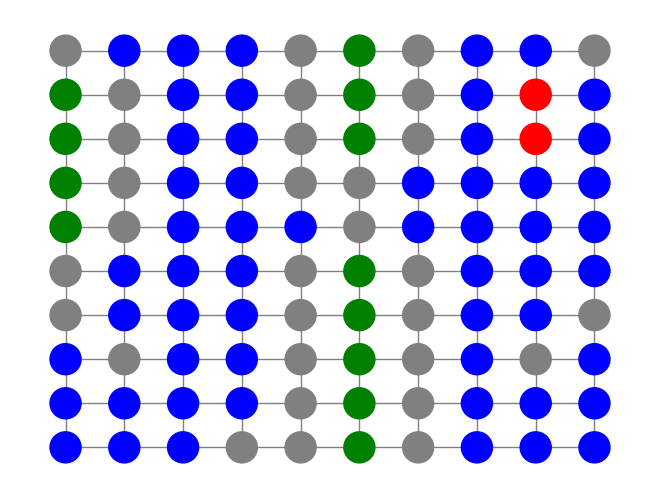

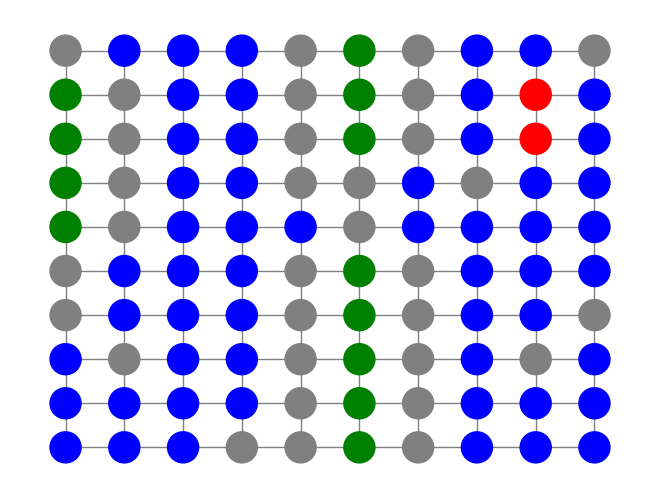

...

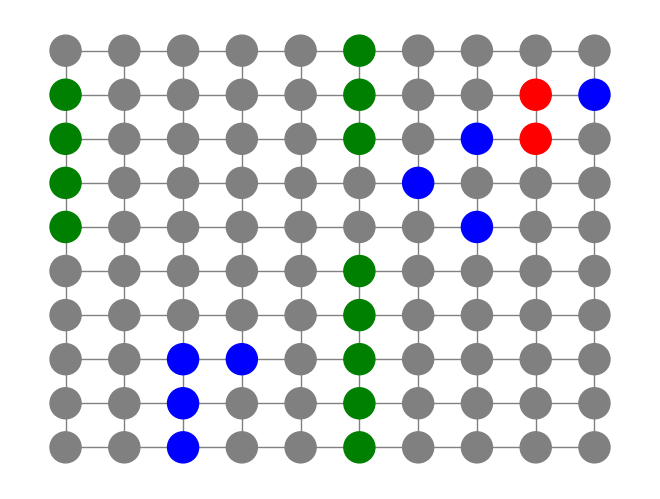

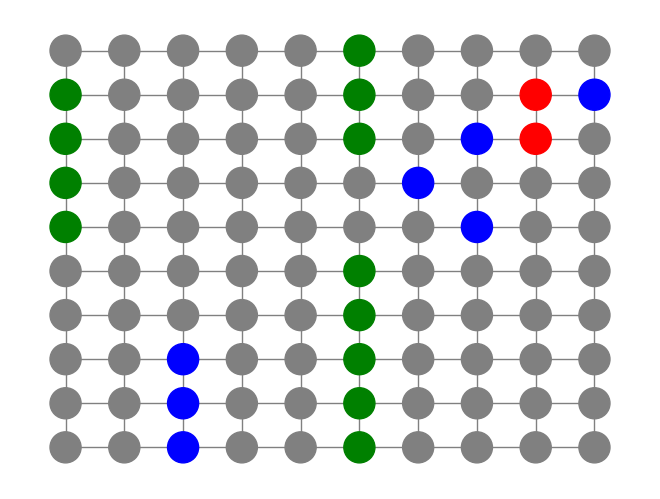

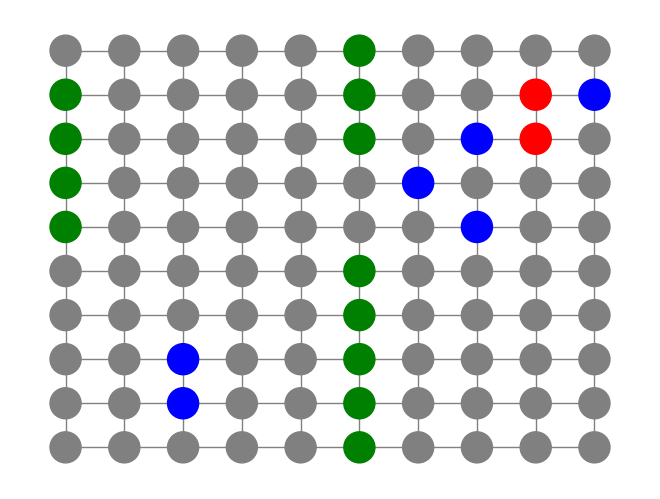

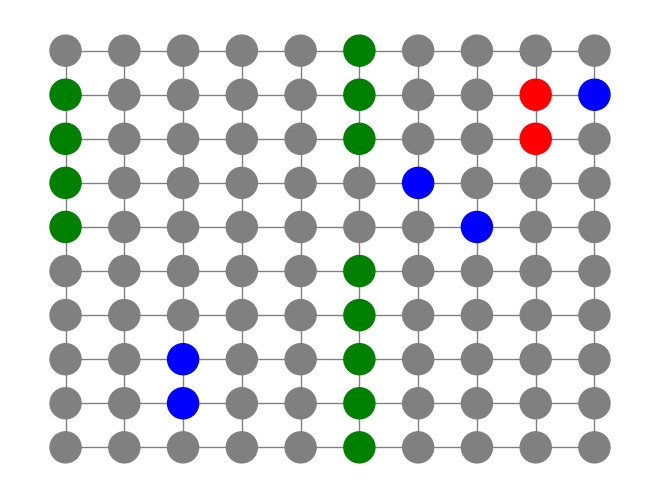

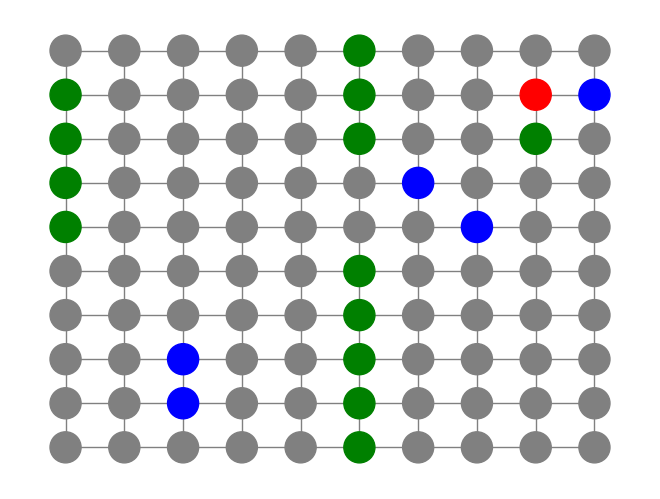

BFS explora: (8, 2)


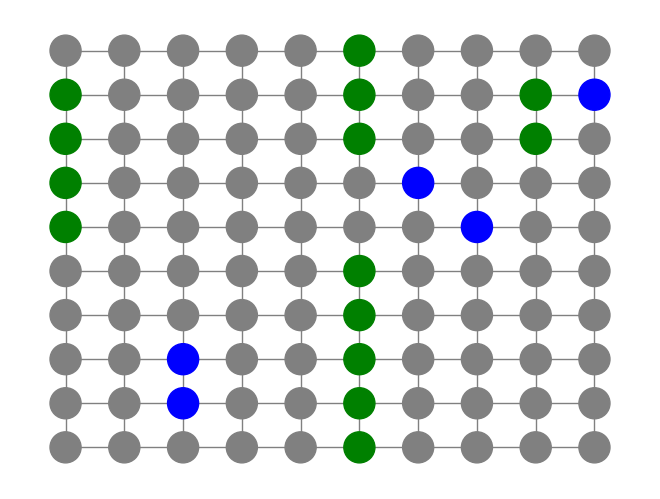


Estrategia DFS:


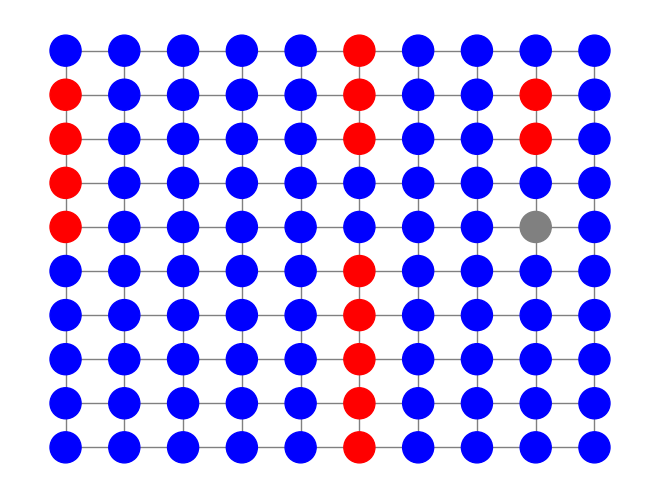

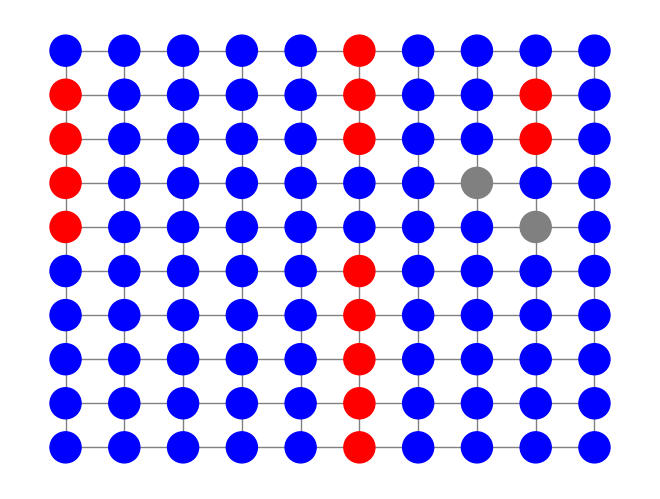

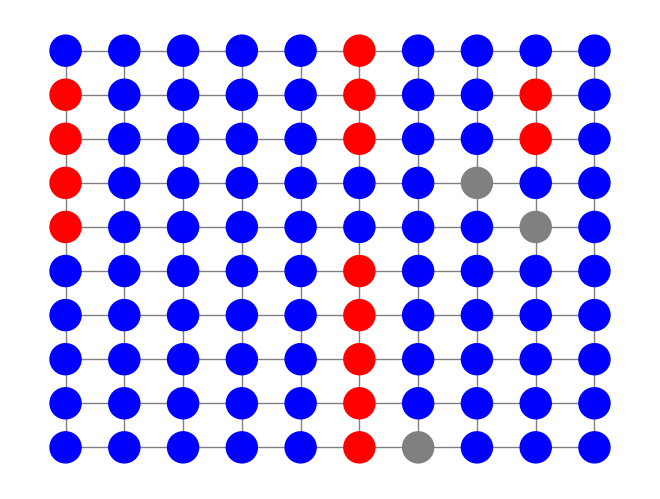

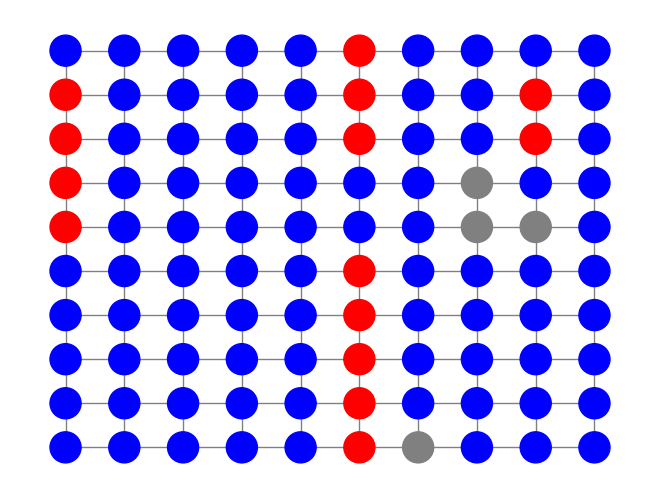

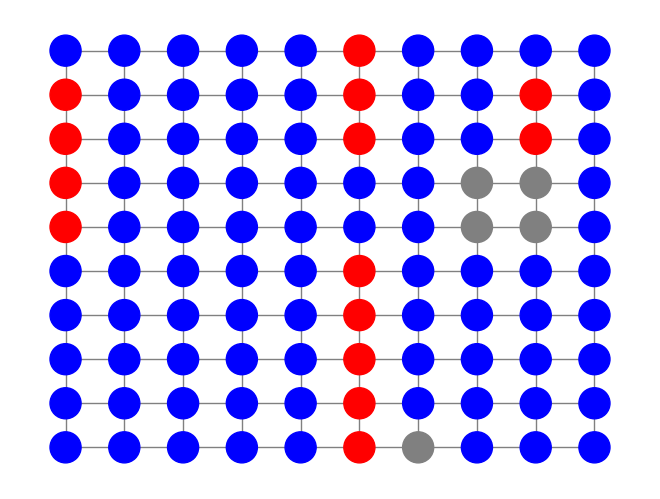

...

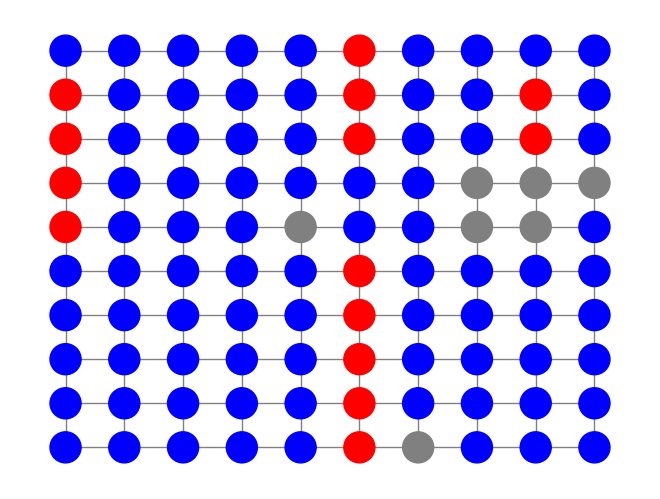

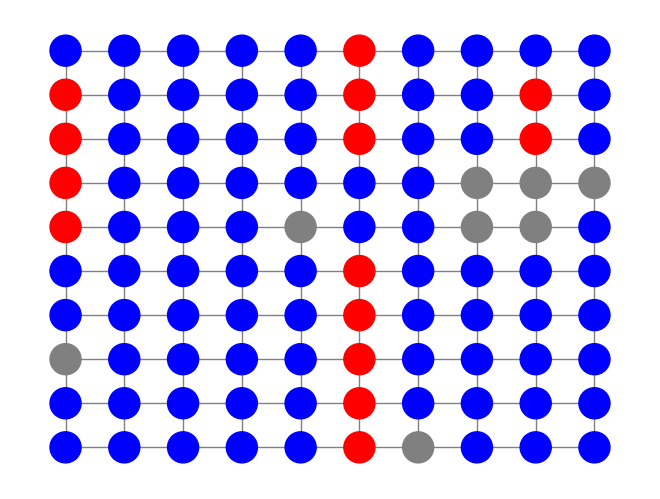

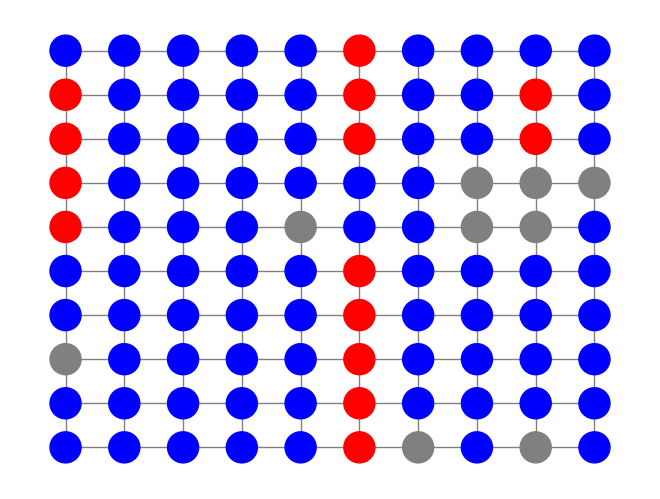

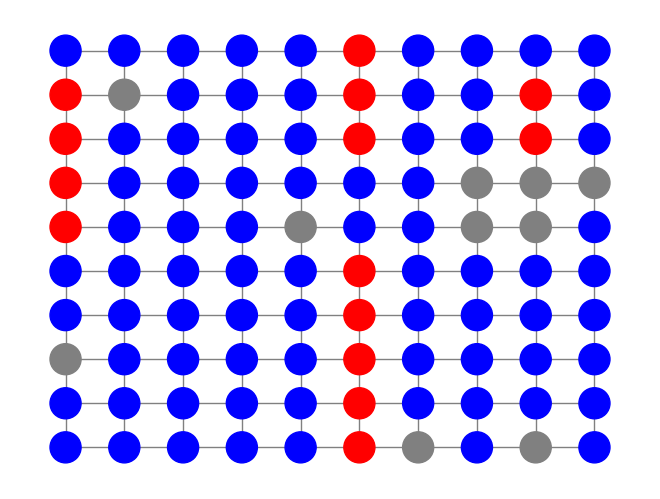

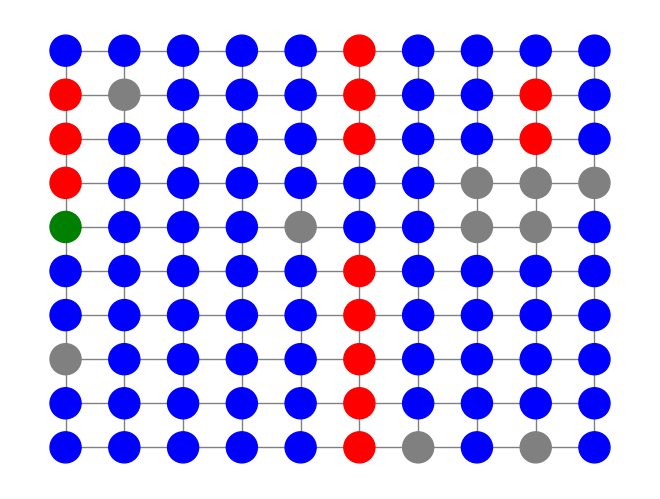

DFS explora: (0, 4)


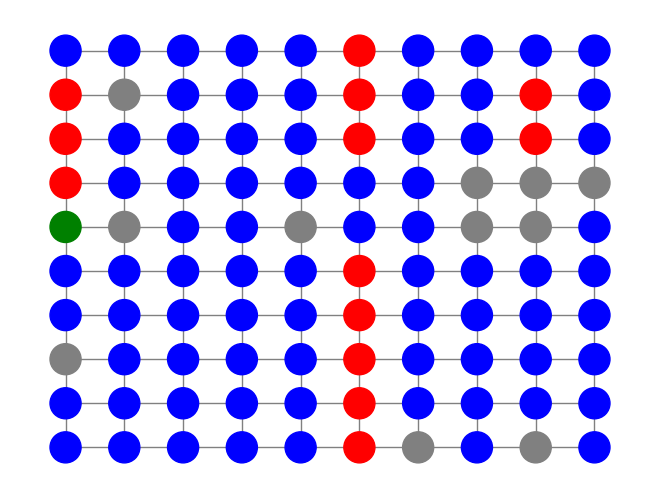

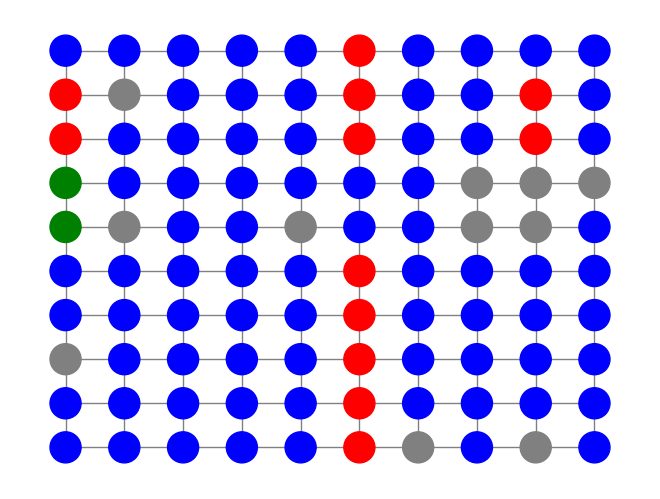

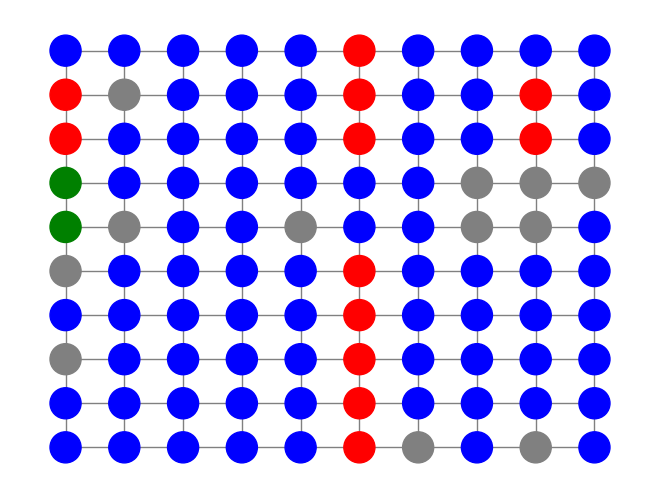

DFS explora: (0, 3)


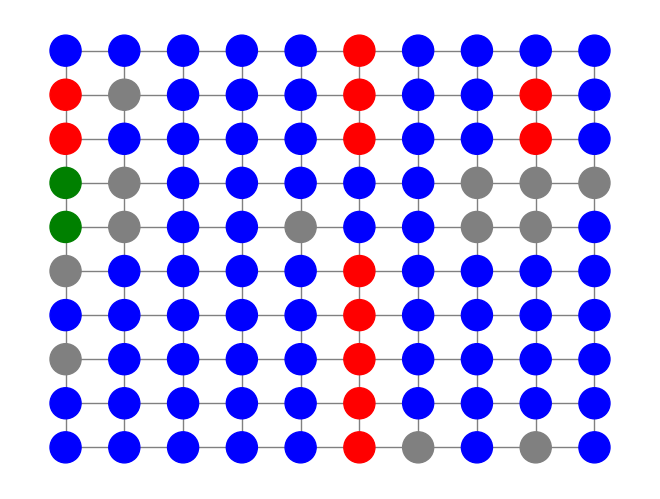

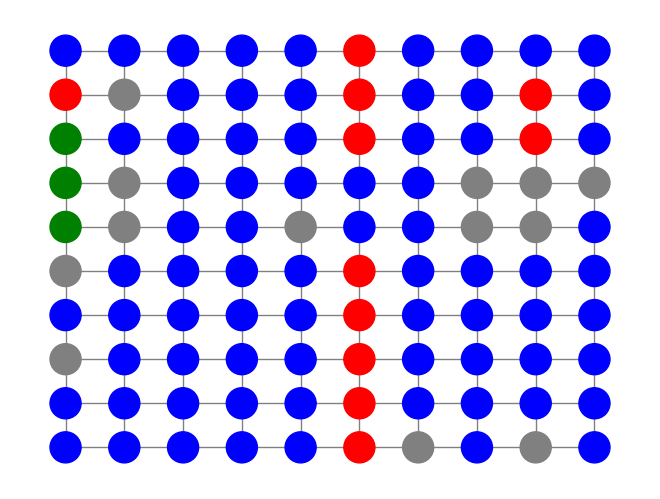

DFS explora: (0, 2)


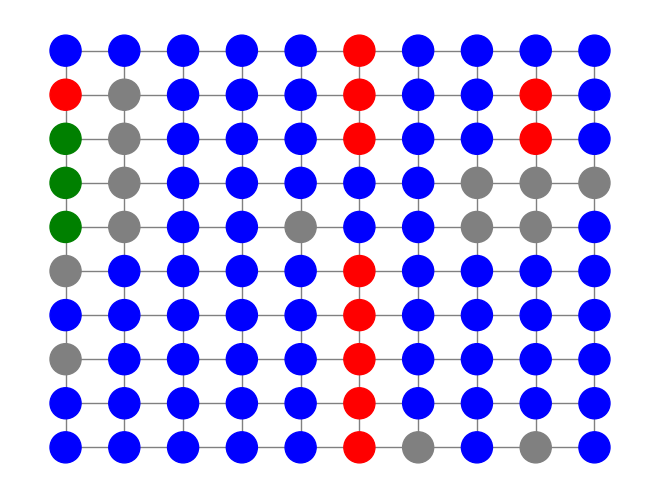

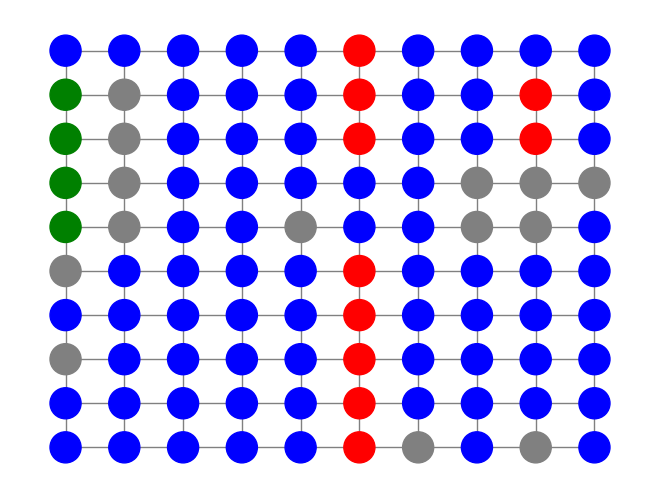

DFS explora: (0, 1)


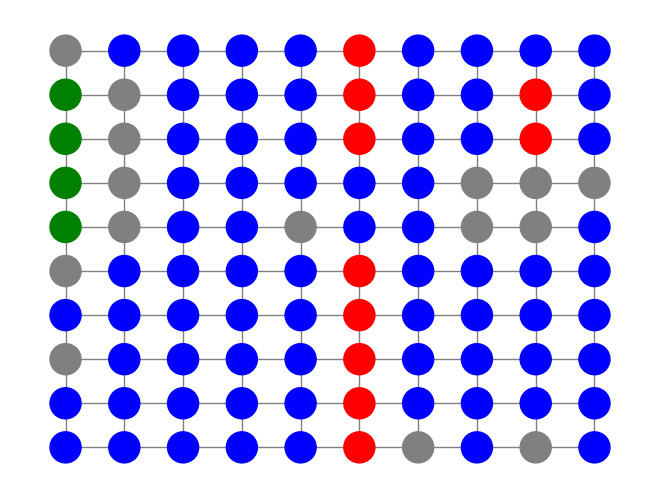

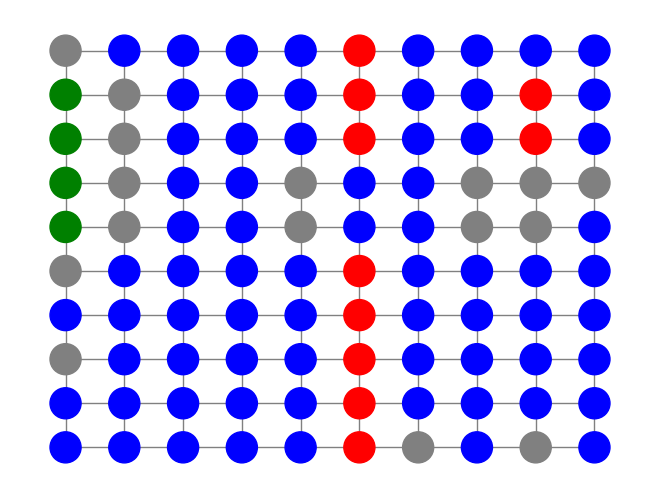

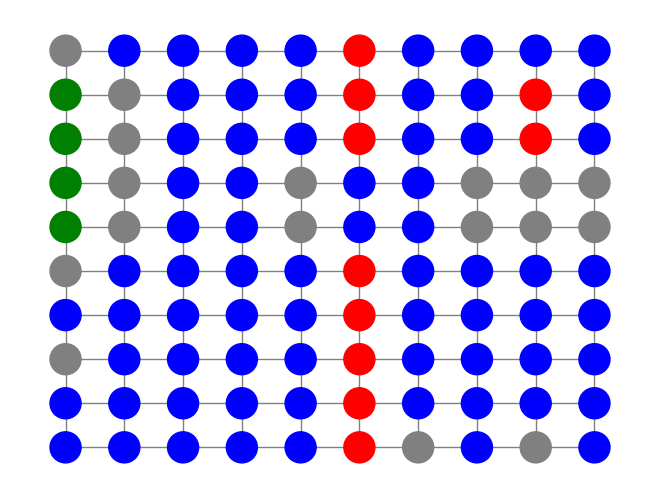

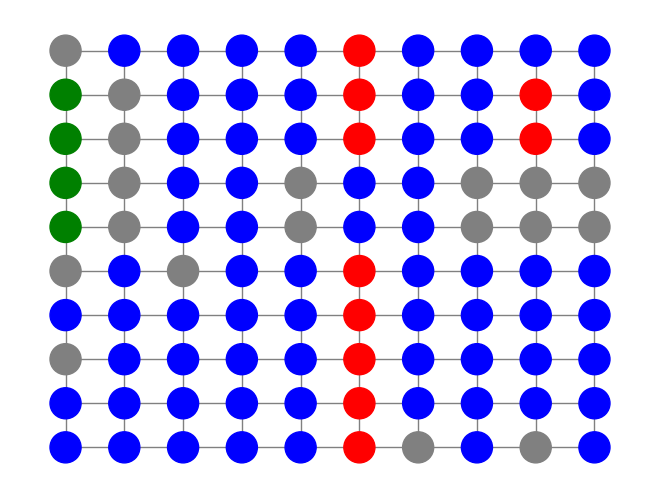

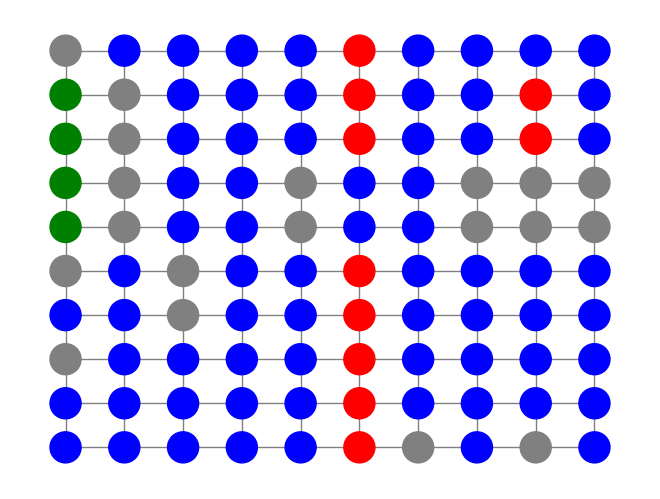

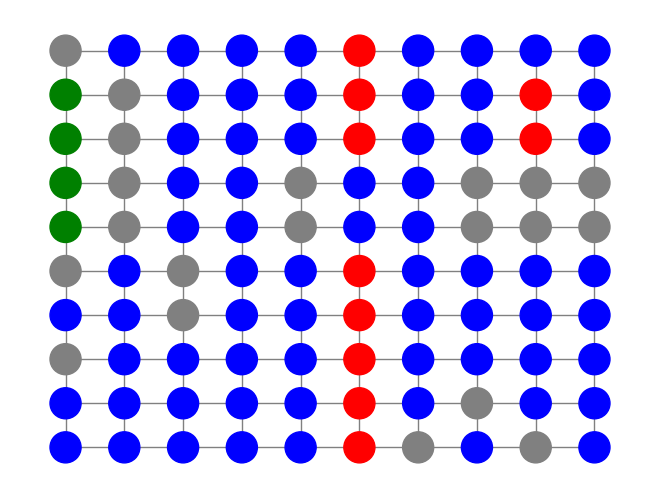

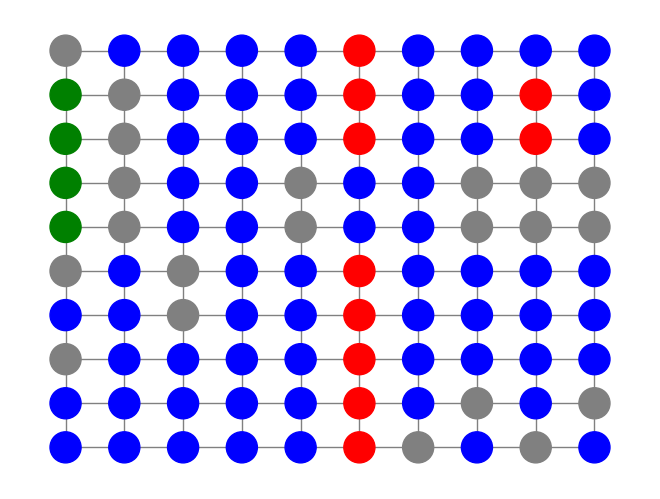

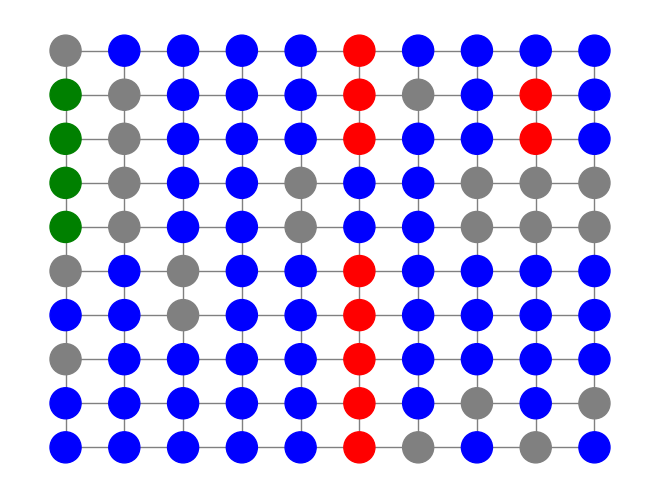

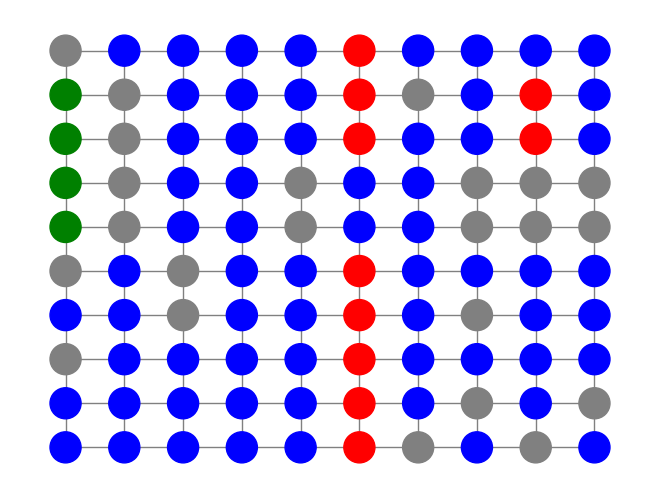

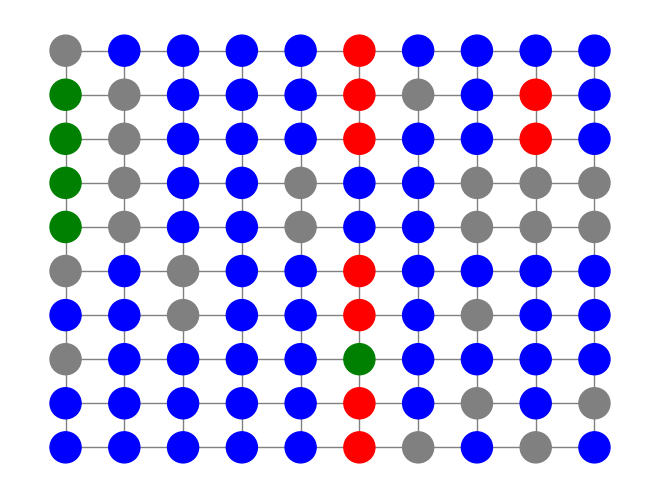

DFS explora: (5, 7)


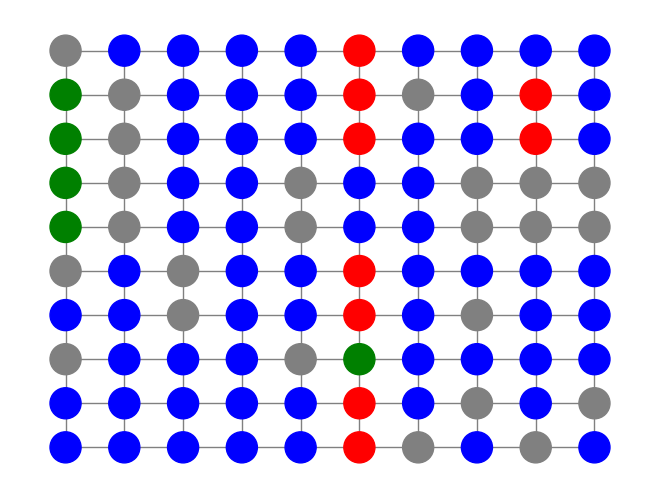

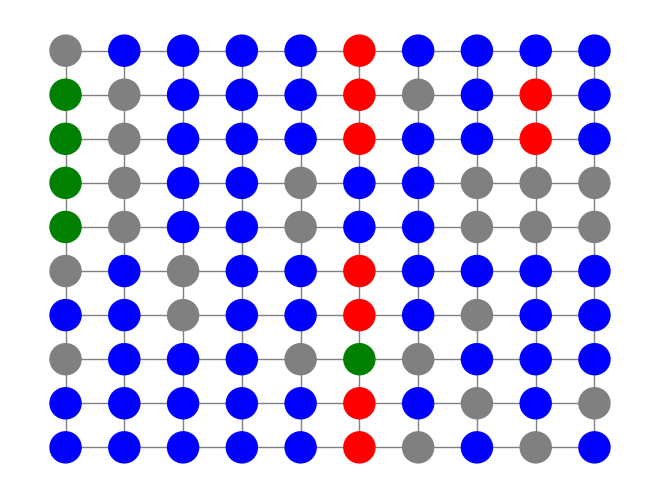

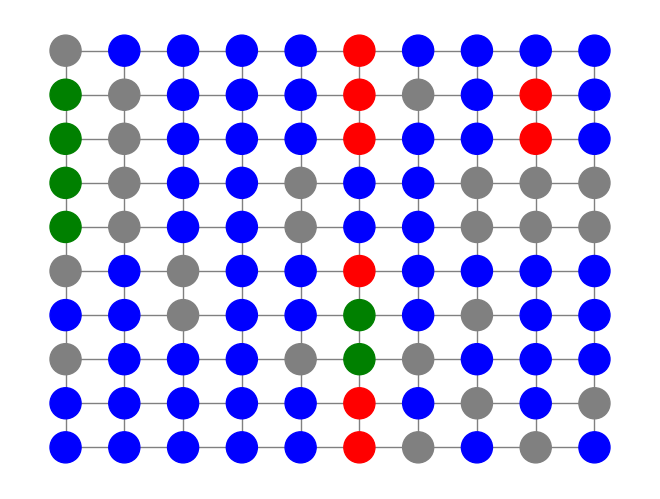

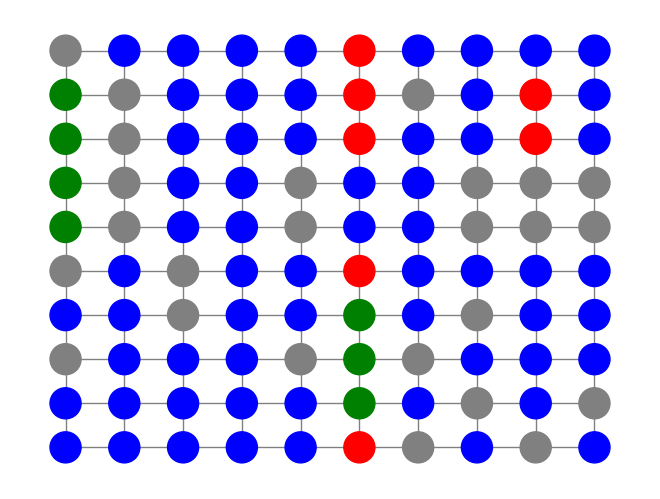

DFS explora: (5, 6)


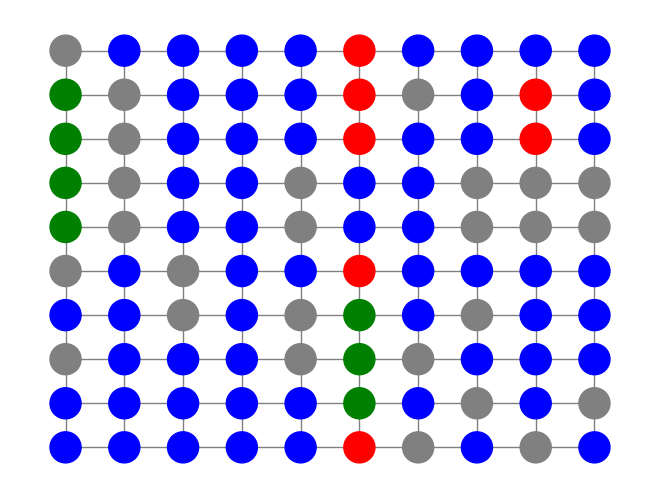

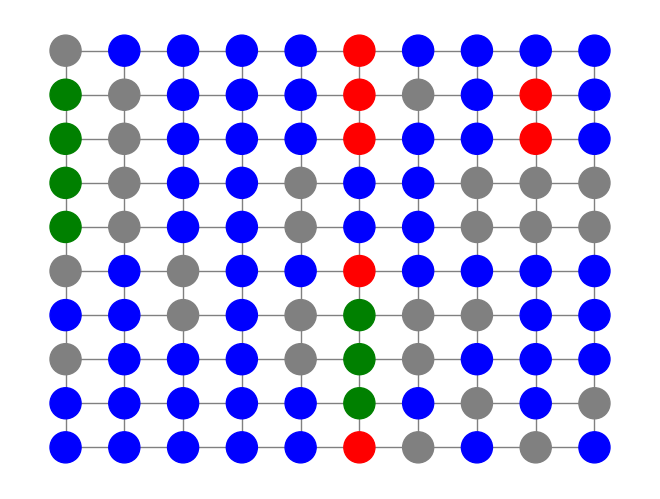

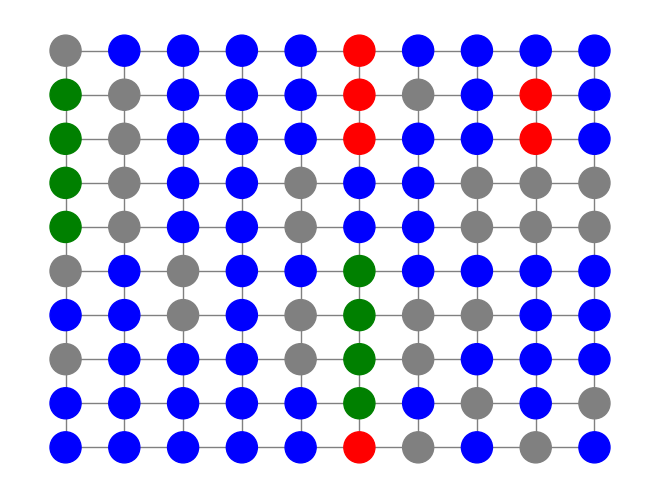

DFS explora: (5, 8)


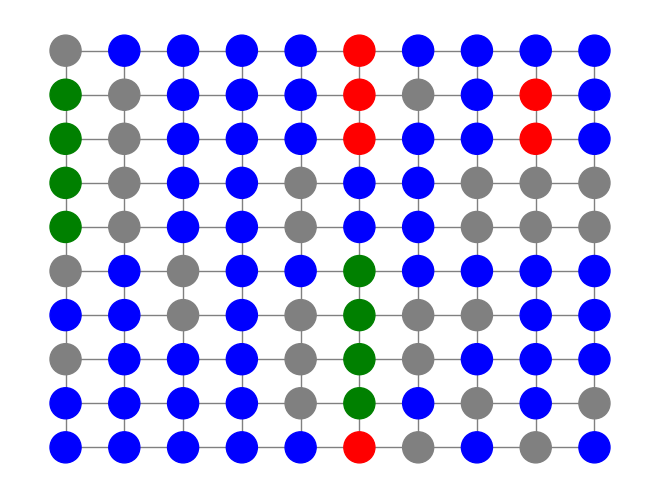

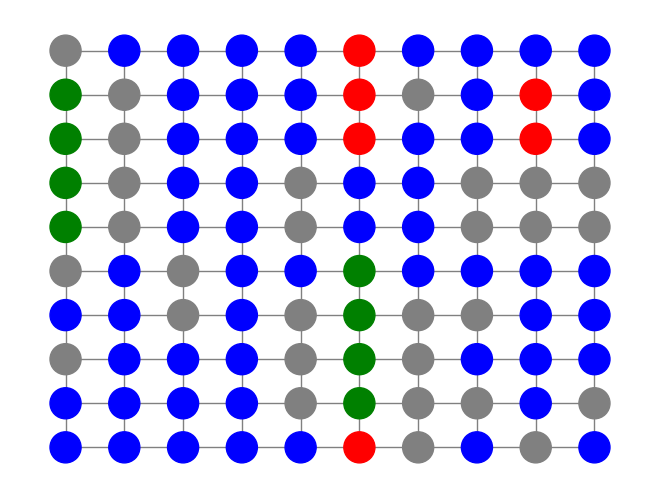

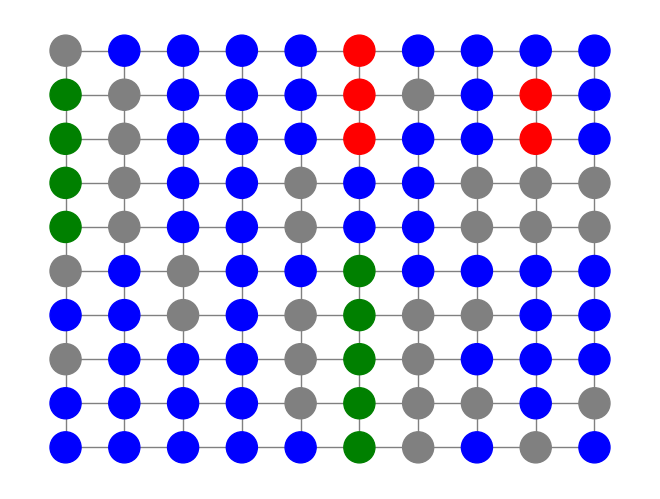

DFS explora: (5, 5)


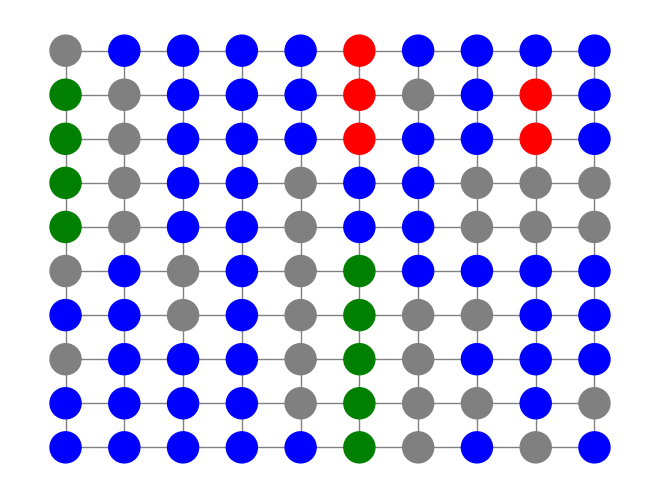

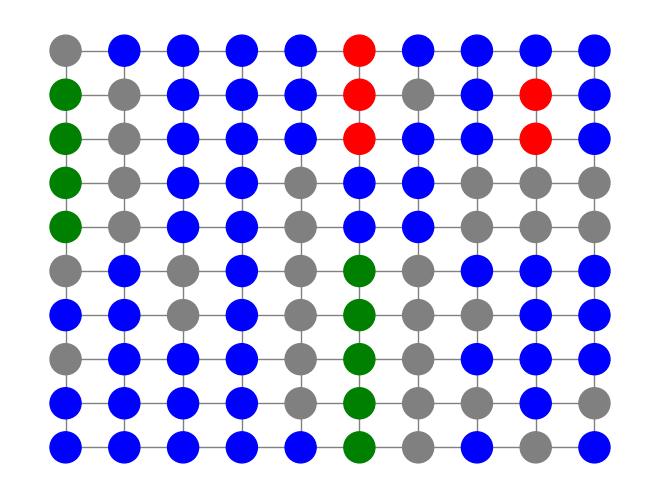

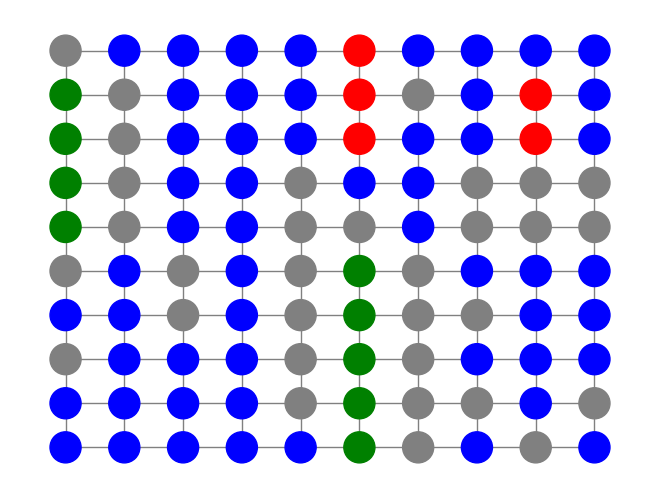

DFS explora: (5, 9)


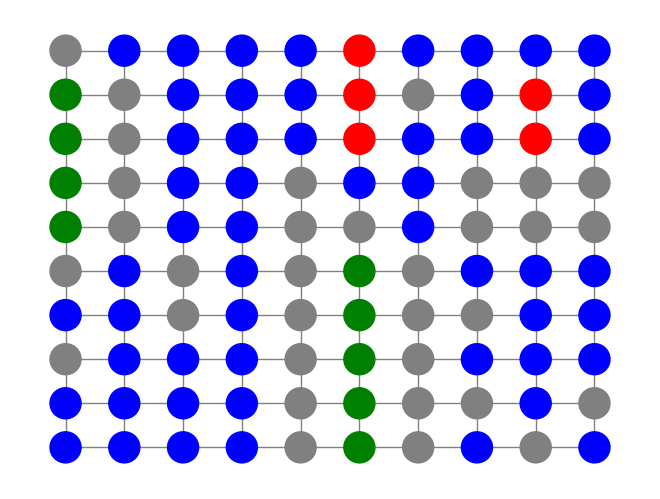

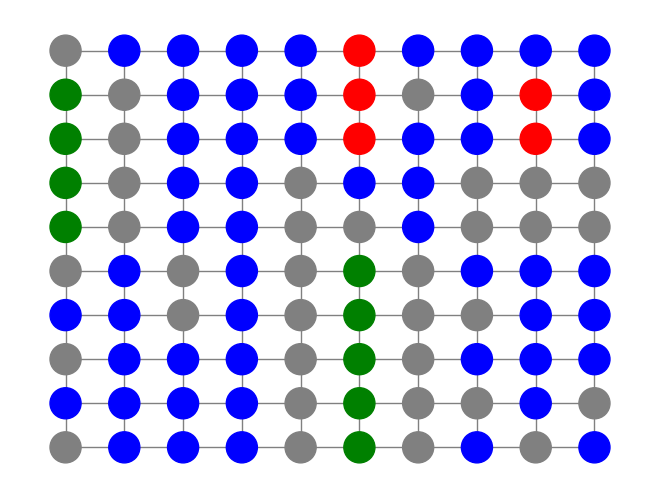

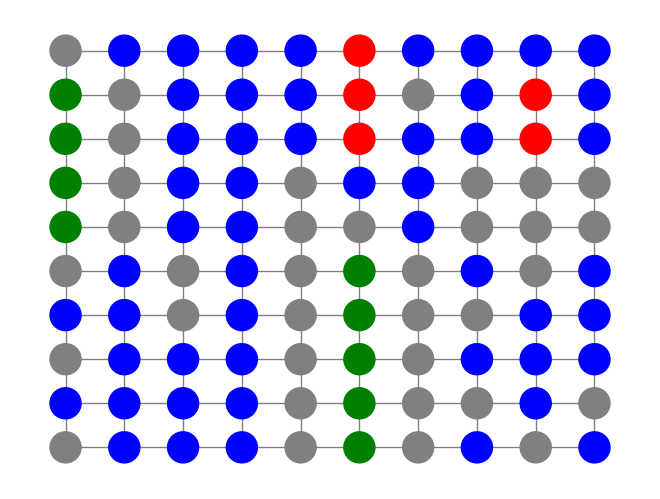

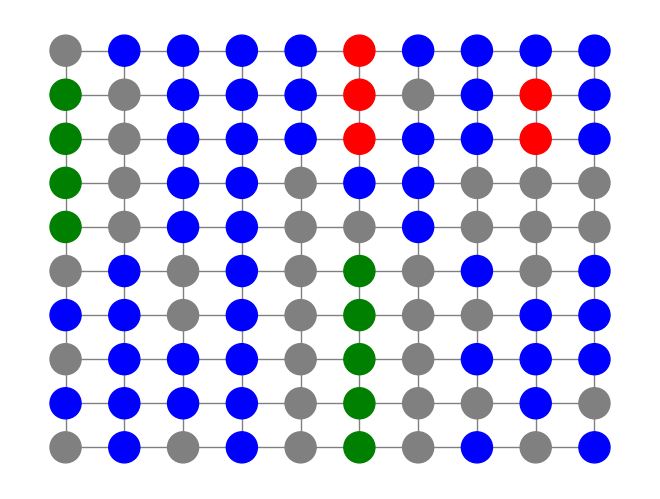

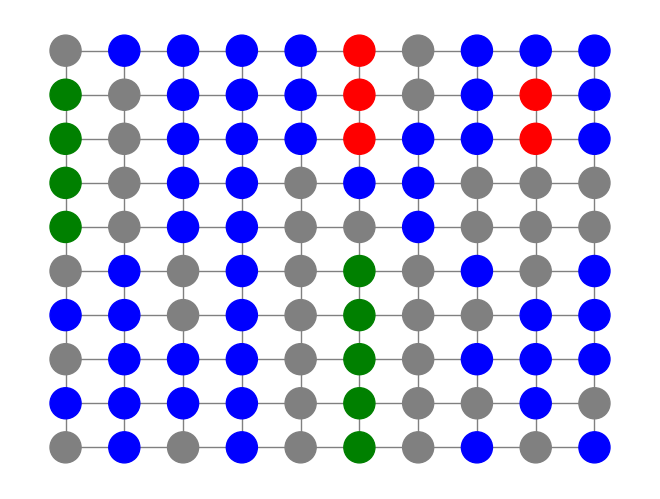

...

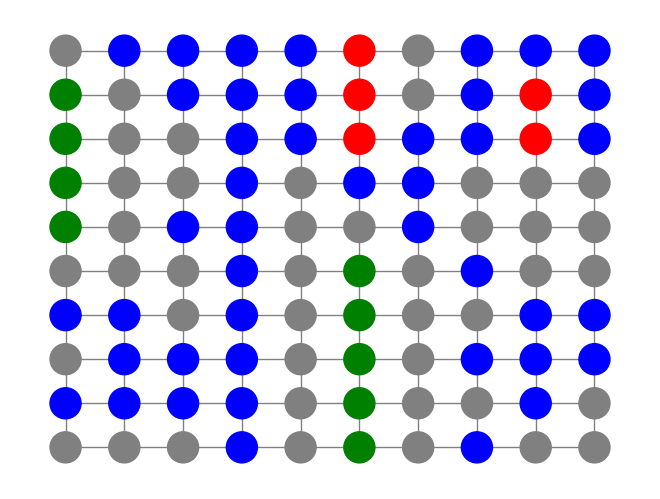

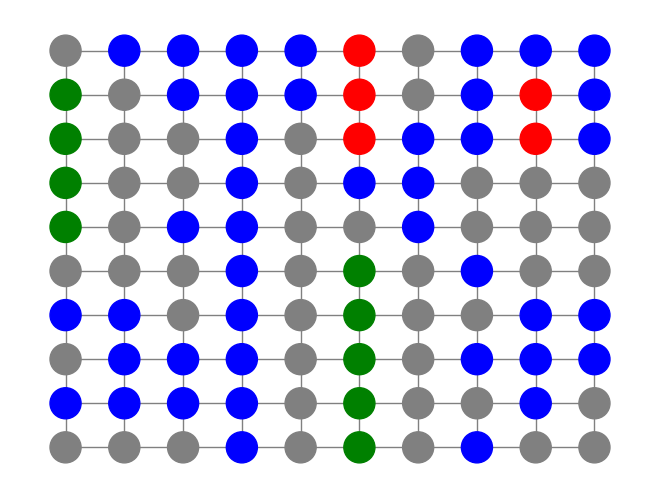

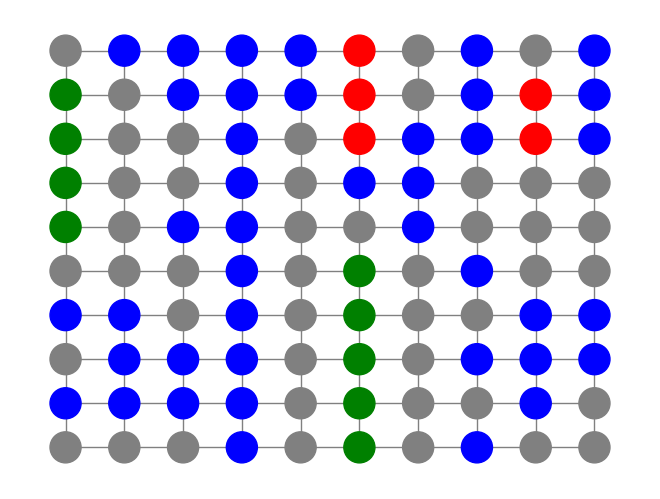

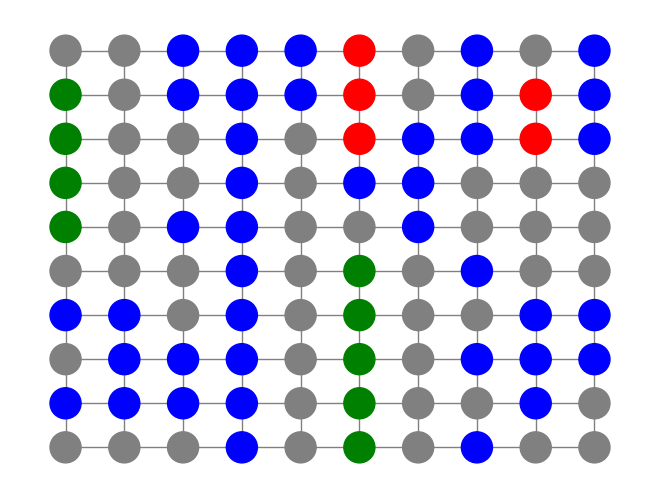

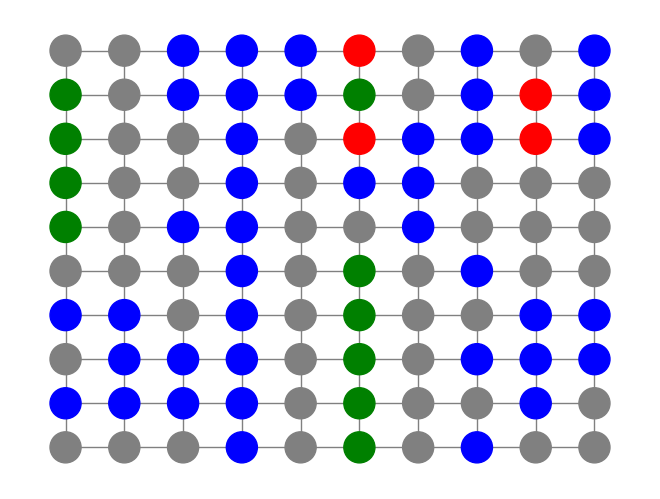

DFS explora: (5, 1)


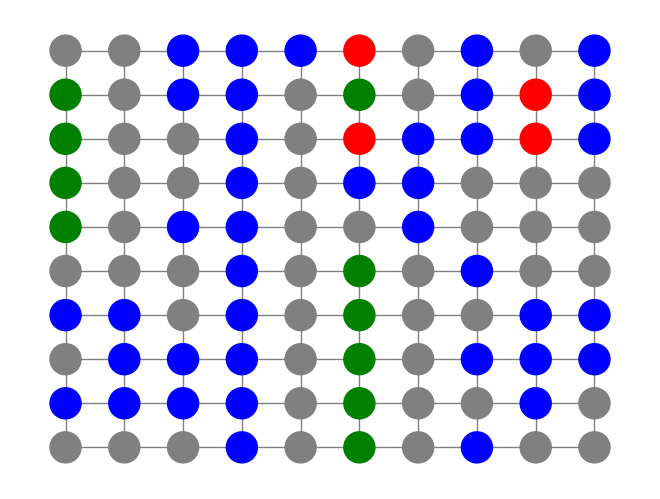

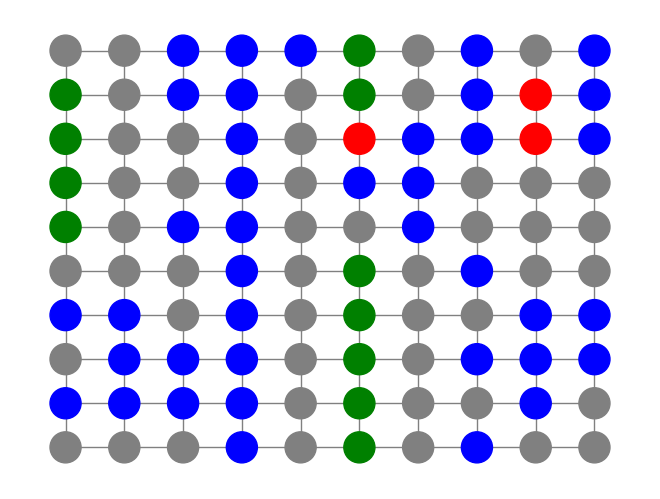

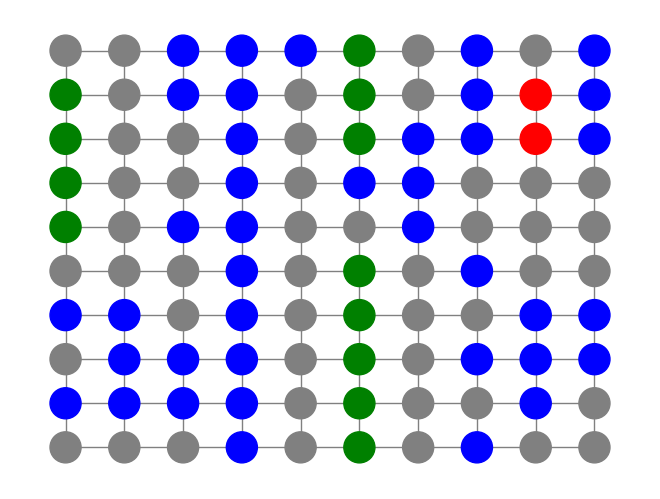

DFS explora: (5, 0)


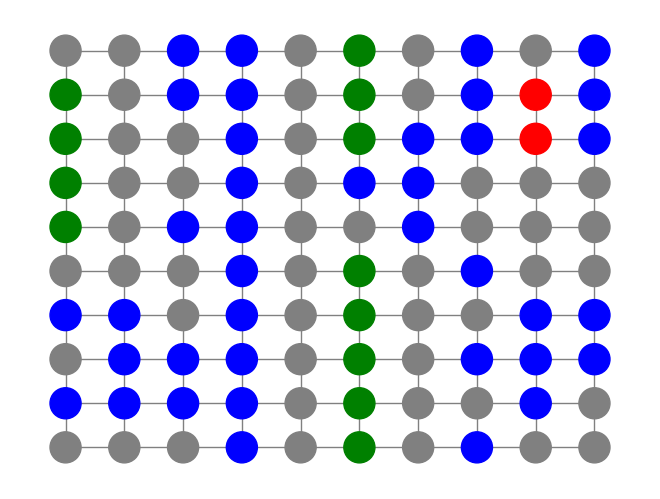

DFS explora: (5, 2)


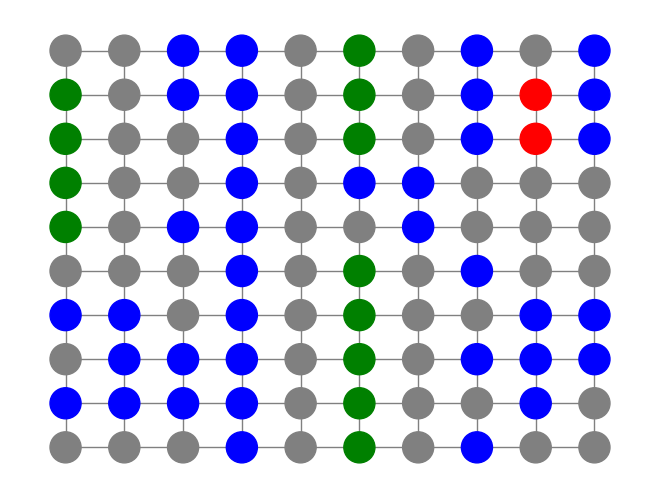

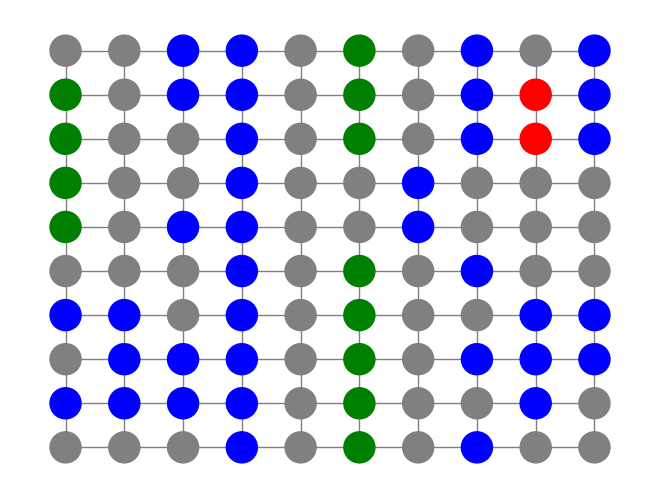

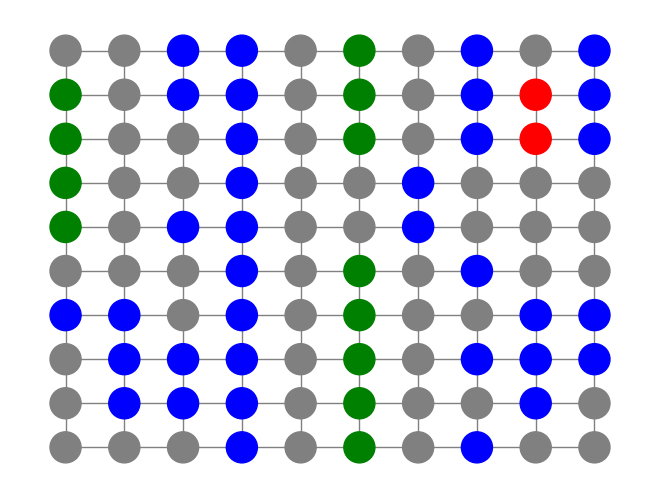

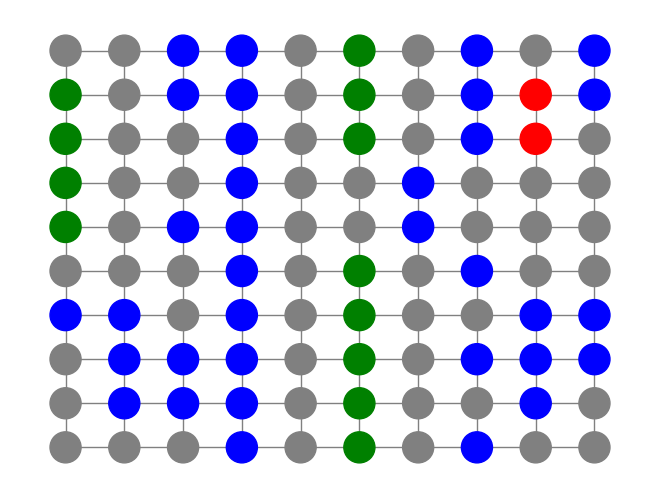

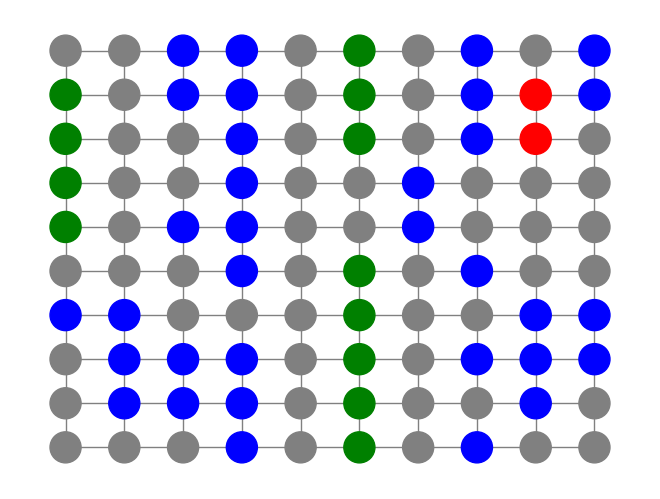

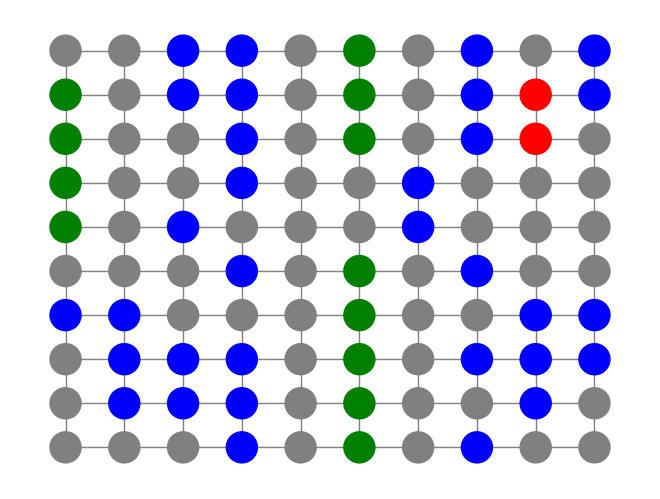

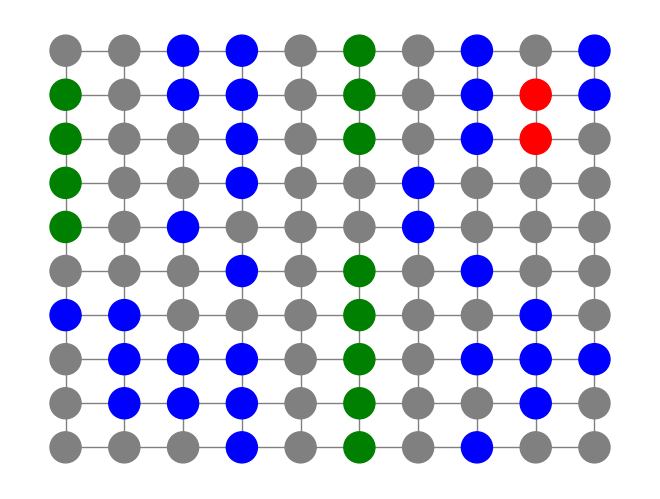

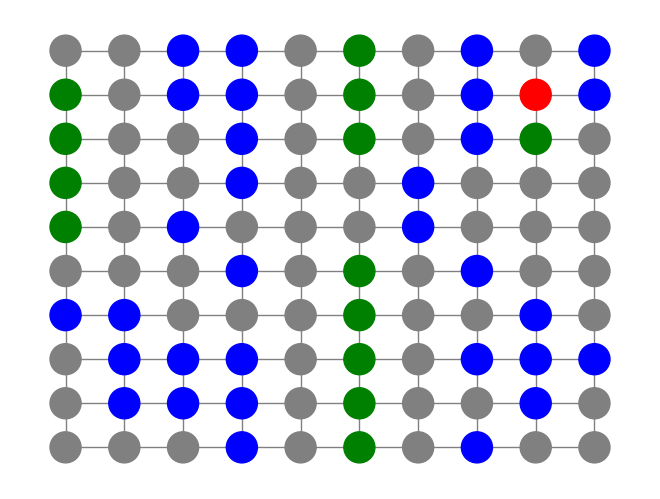

DFS explora: (8, 2)


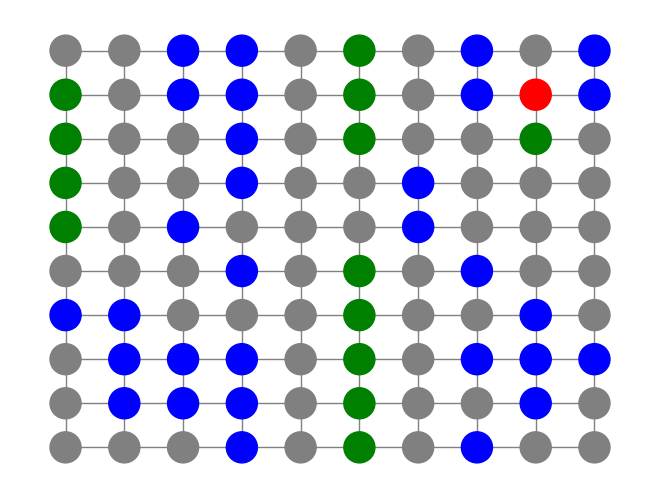

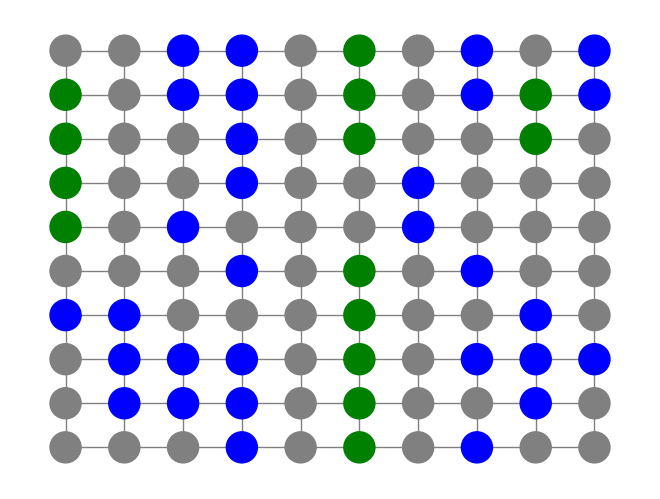


Estrategia Dijkstra:


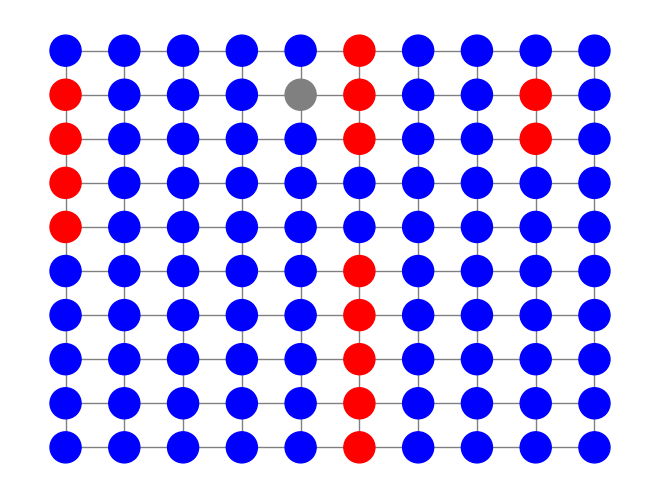

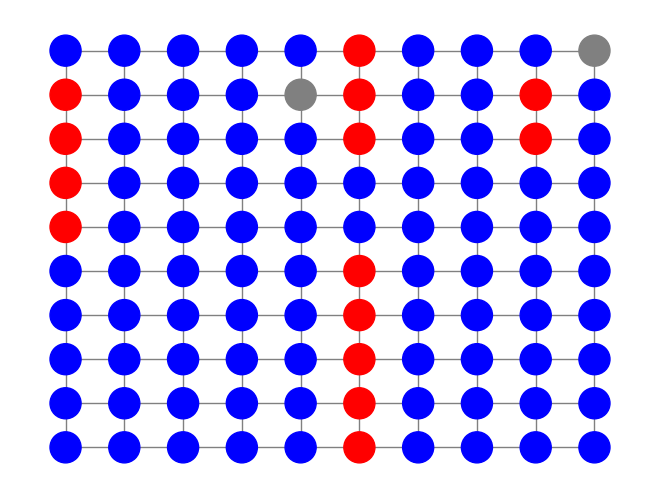

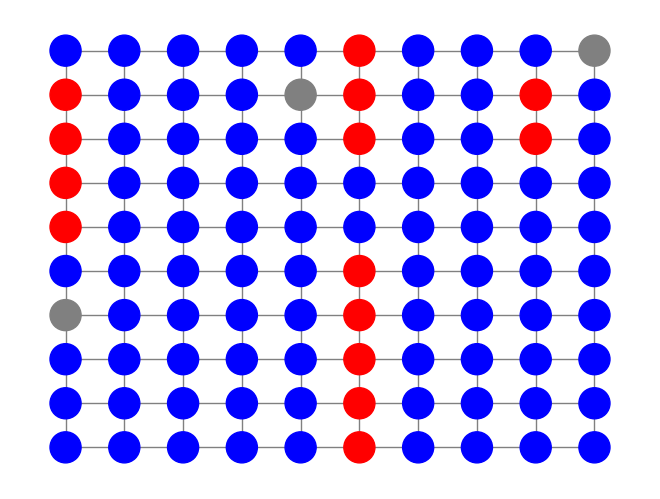

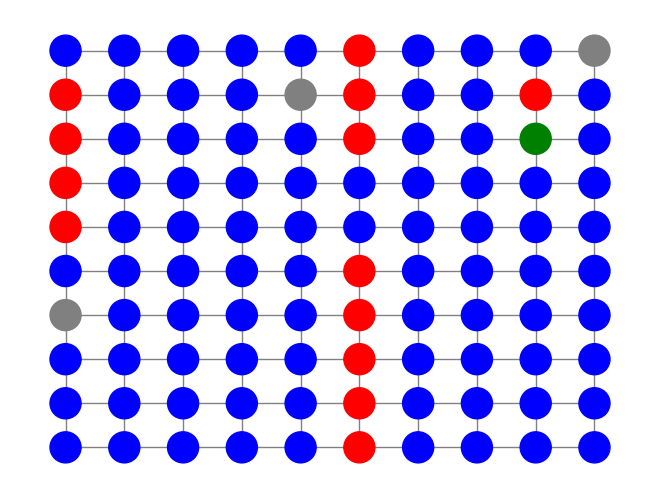

Dijkstra explora: (7, 2) con probabilidad 0.80


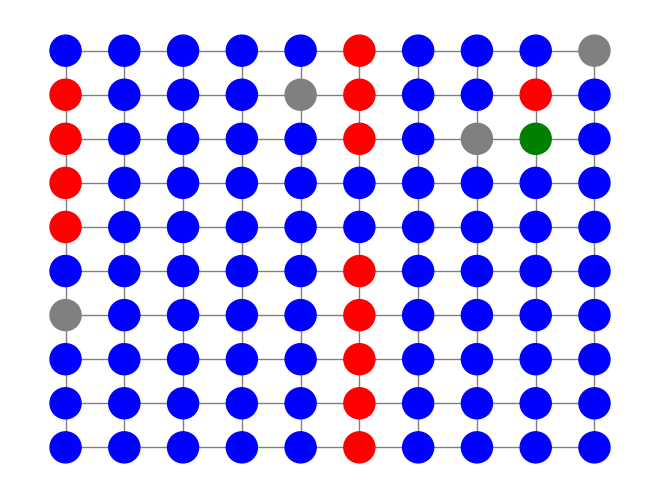

Dijkstra explora: (8, 1) con probabilidad 0.80


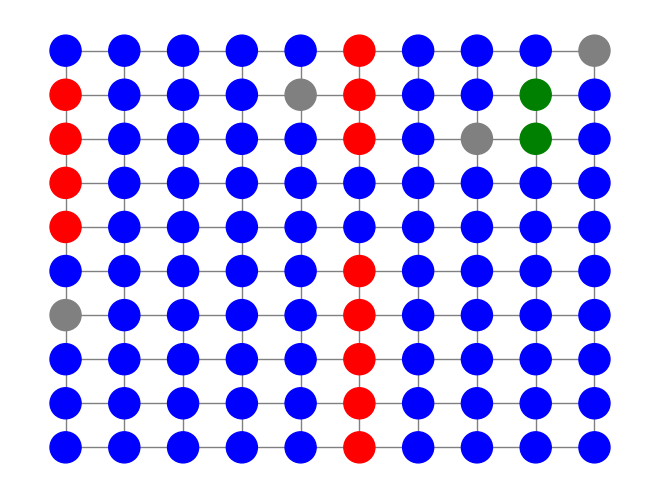

Dijkstra explora: (9, 2) con probabilidad 0.80


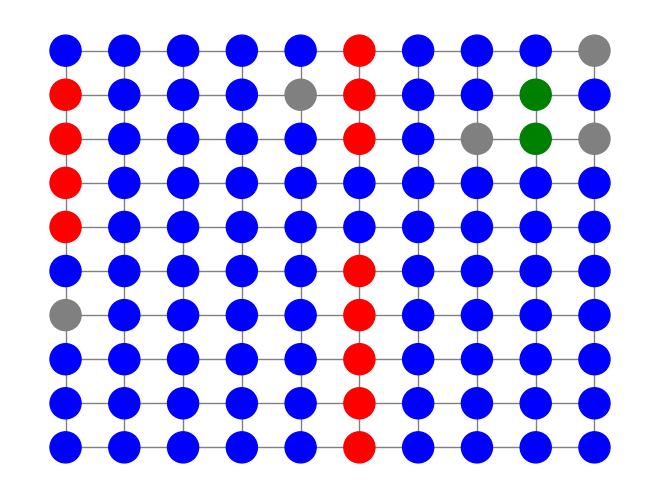

Dijkstra explora: (5, 6) con probabilidad 0.60


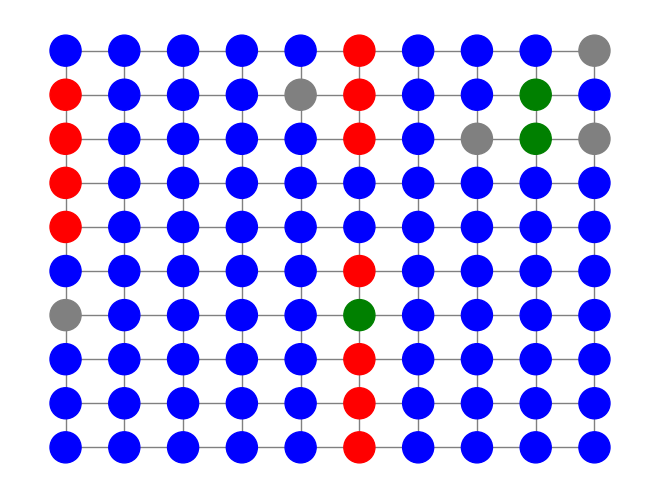

Dijkstra explora: (5, 8) con probabilidad 0.60


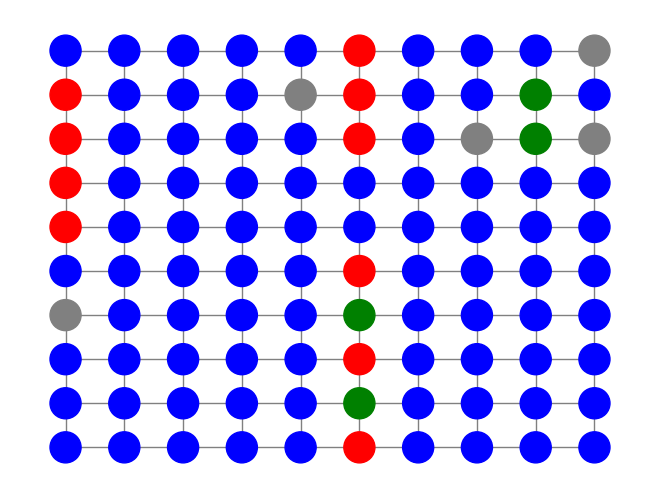

Dijkstra explora: (5, 7) con probabilidad 0.60


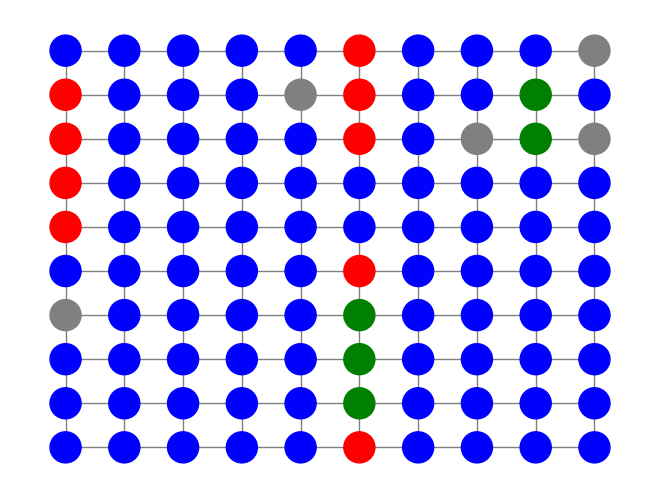

Dijkstra explora: (4, 7) con probabilidad 0.80


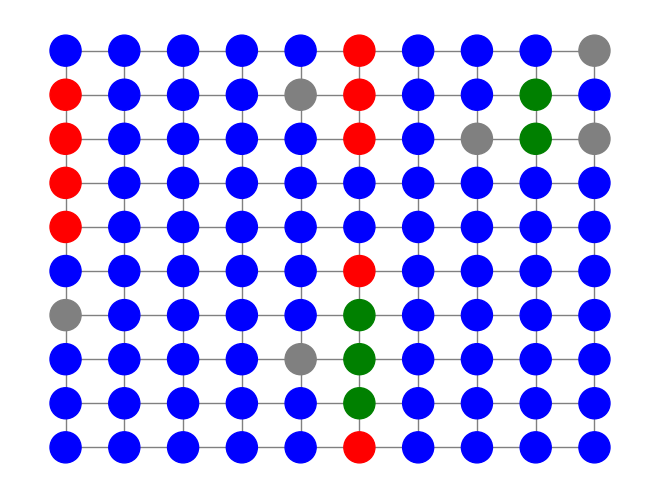

Dijkstra explora: (6, 7) con probabilidad 0.80


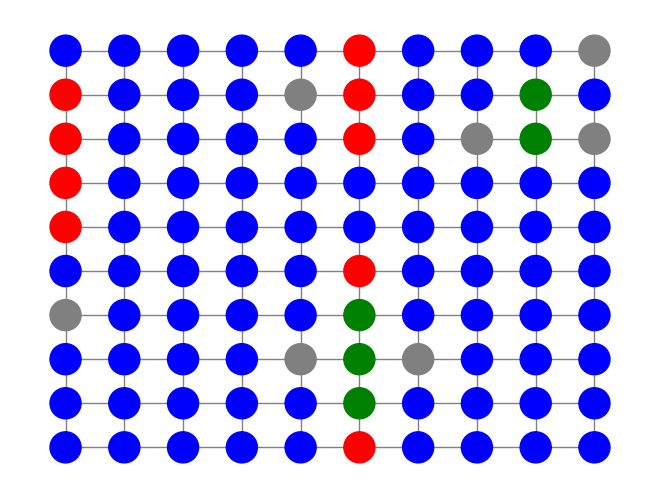

Dijkstra explora: (8, 3) con probabilidad 0.60


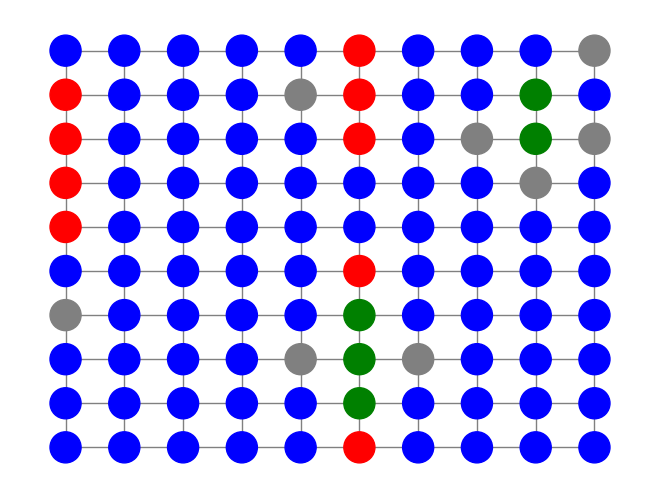

Dijkstra explora: (5, 0) con probabilidad 0.50


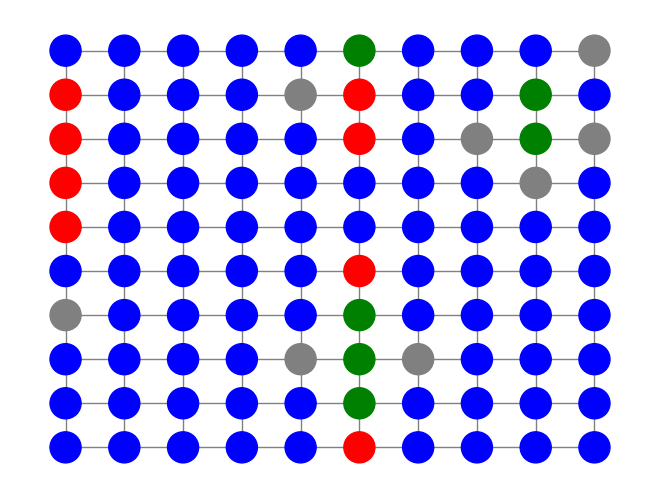

Dijkstra explora: (5, 2) con probabilidad 0.50


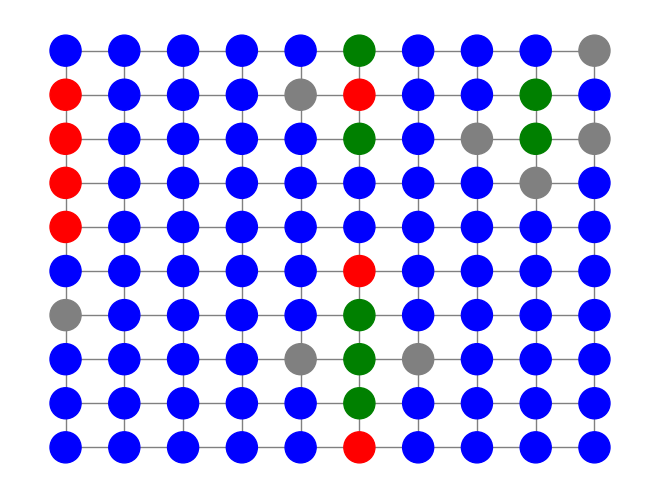

Dijkstra explora: (5, 1) con probabilidad 0.60


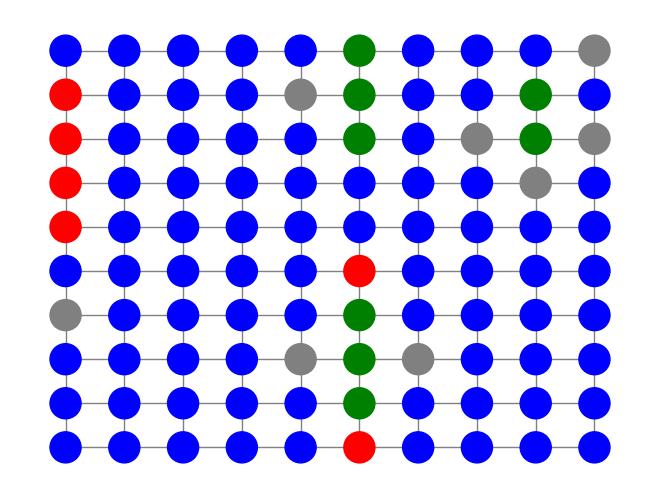

Dijkstra explora: (6, 1) con probabilidad 0.70


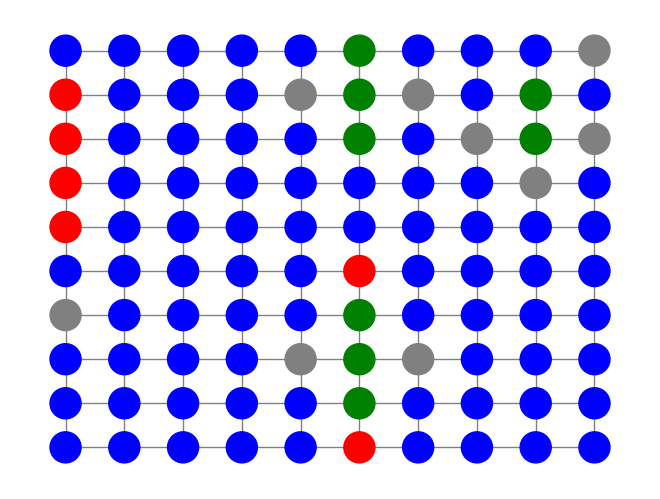

Dijkstra explora: (0, 2) con probabilidad 0.30


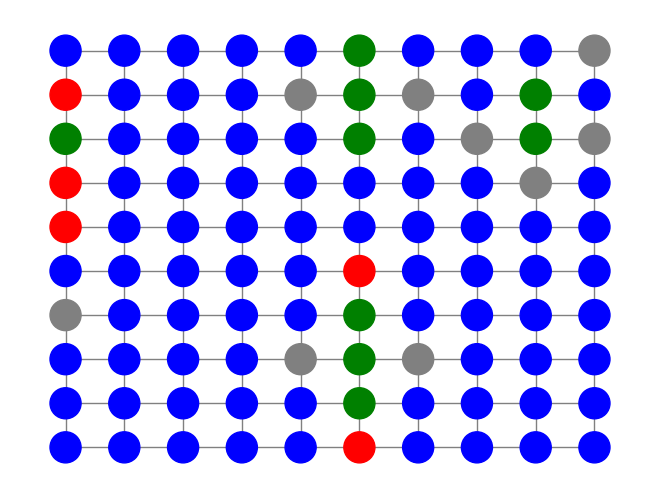

Dijkstra explora: (0, 3) con probabilidad 0.60


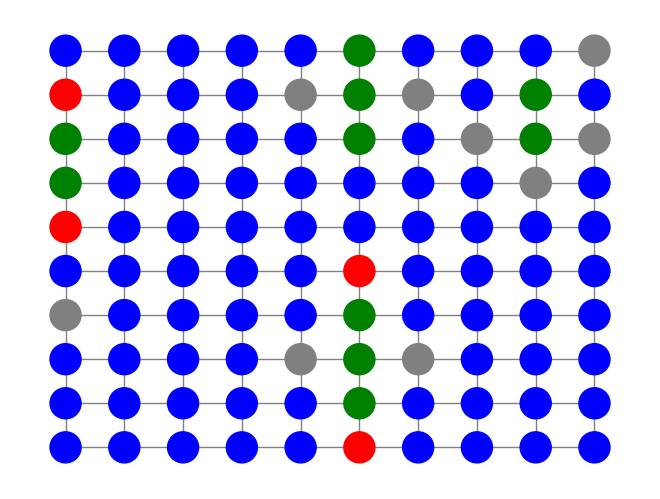

Dijkstra explora: (0, 1) con probabilidad 0.30


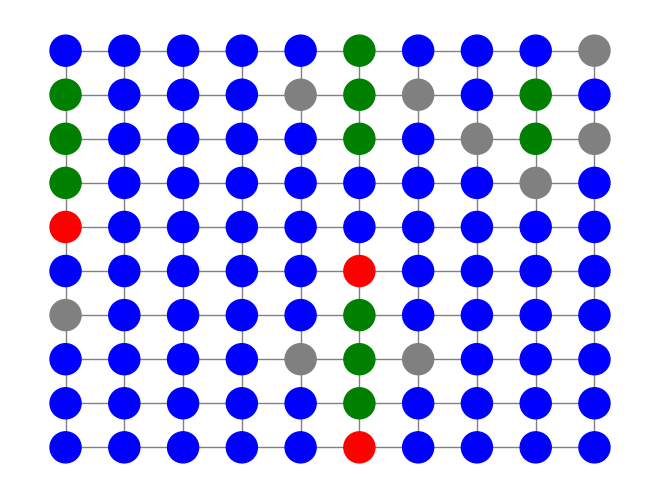

Dijkstra explora: (0, 0) con probabilidad 0.40


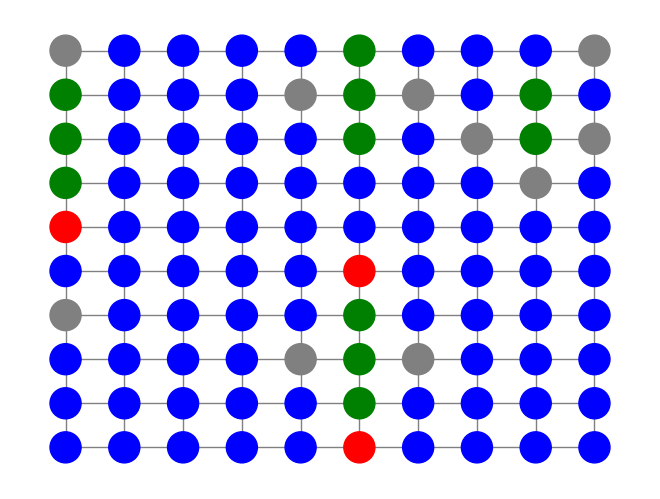

Dijkstra explora: (0, 4) con probabilidad 0.30


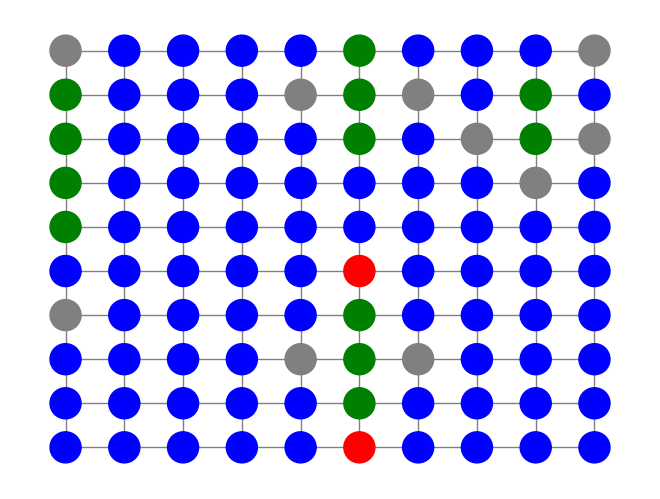

Dijkstra explora: (1, 4) con probabilidad 0.50


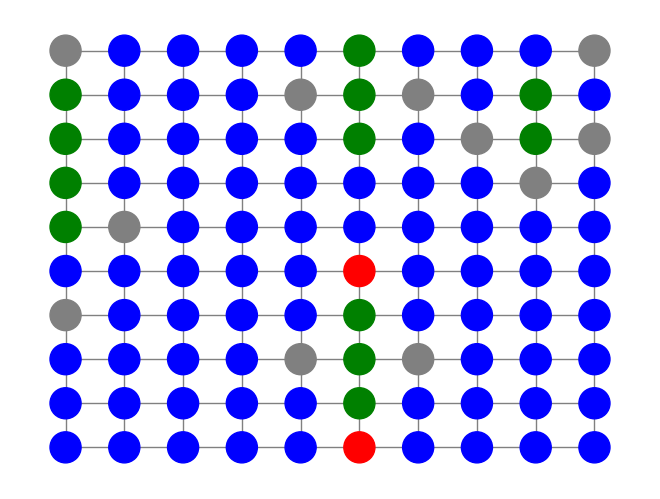

Dijkstra explora: (0, 5) con probabilidad 0.40


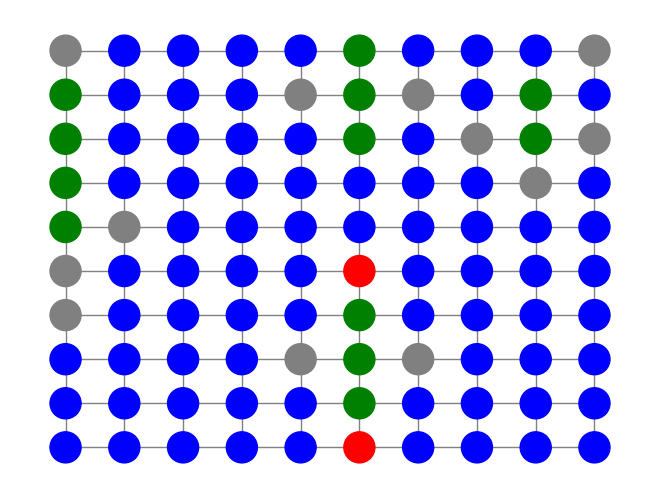

Dijkstra explora: (1, 1) con probabilidad 0.30


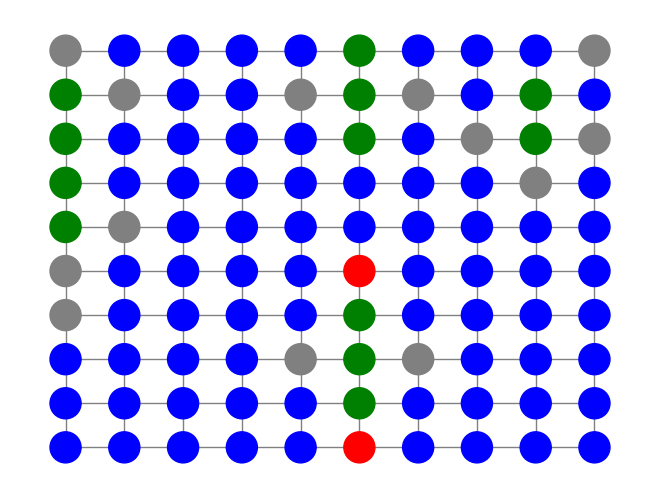

Dijkstra explora: (4, 0) con probabilidad 0.30


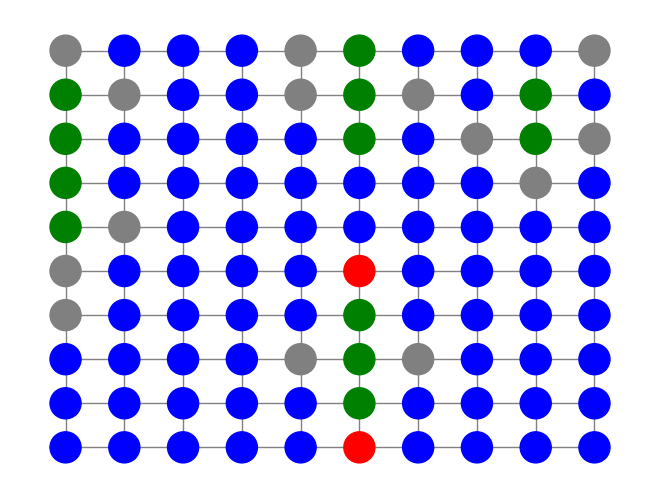

Dijkstra explora: (4, 2) con probabilidad 0.30


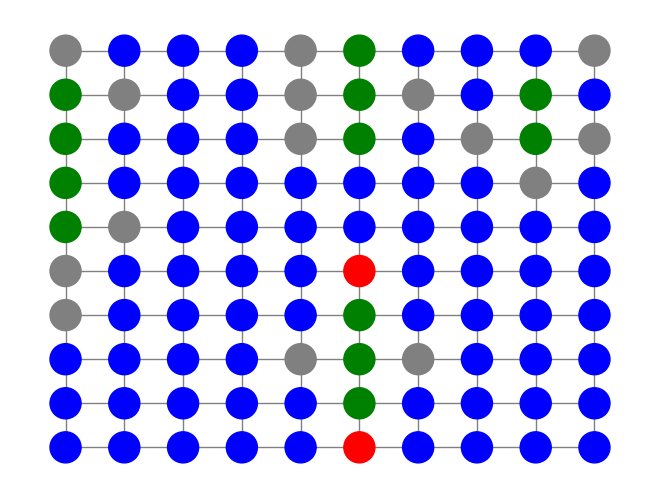

Dijkstra explora: (5, 3) con probabilidad 0.30


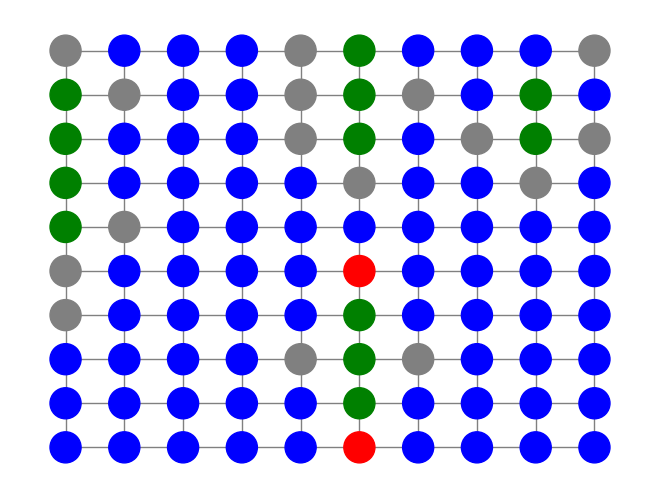

Dijkstra explora: (5, 5) con probabilidad 0.30


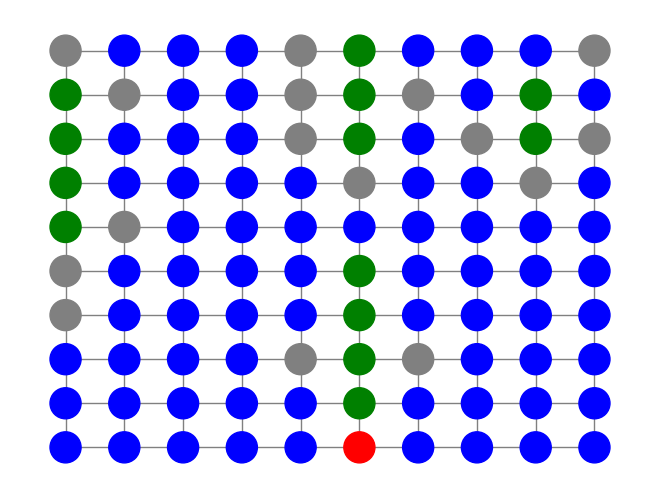

Dijkstra explora: (4, 5) con probabilidad 0.30


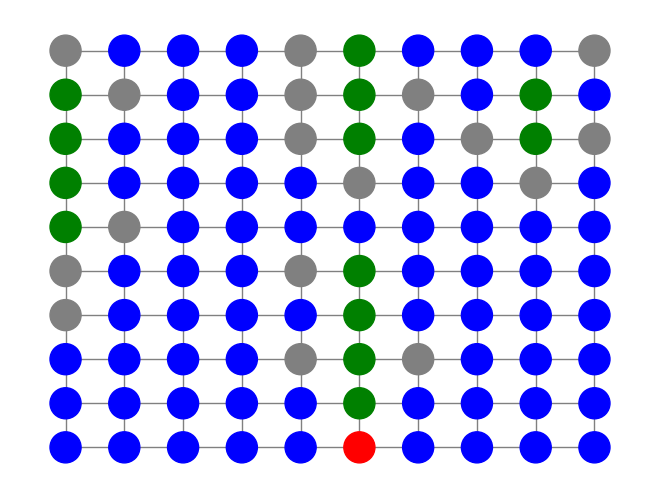

Dijkstra explora: (5, 4) con probabilidad 0.30


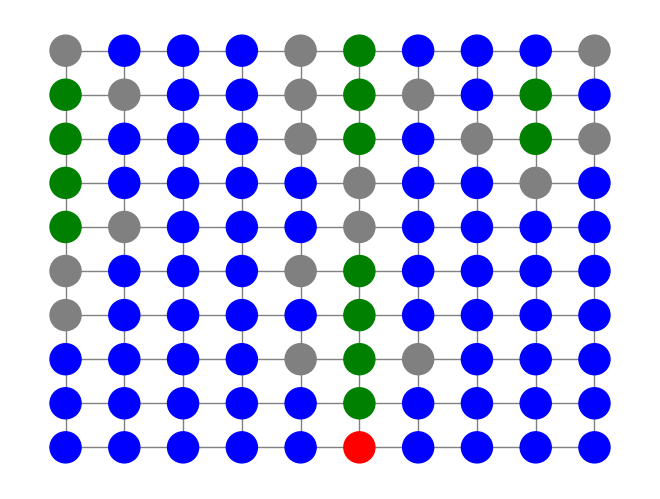

Dijkstra explora: (5, 9) con probabilidad 0.30


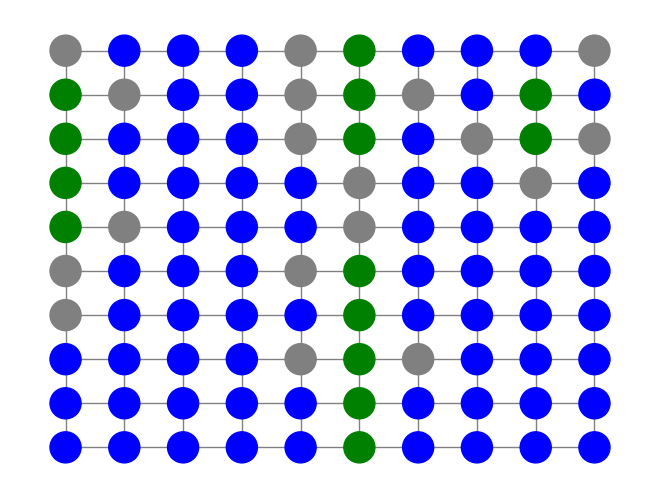


Comparación de estrategias:
BFS:
  Disparos: 63
  Tiempo total: 42.68 segundos
  Precisión: 22.22%
DFS:
  Disparos: 40
  Tiempo total: 35.13 segundos
  Precisión: 35.00%
Dijkstra:
  Disparos: 4
  Tiempo total: 19.19 segundos
  Precisión: 350.00%


In [ ]:
import networkx as nx
import matplotlib.pyplot as plt
import random
from collections import deque
import heapq
import time

# =======================
# Configuración del tablero
# =======================
def crear_tablero(tamaño=10):
    tablero = nx.grid_2d_graph(tamaño, tamaño)
    nx.set_node_attributes(tablero, 'azul', 'color')  # Color inicial de las casillas
    nx.set_node_attributes(tablero, None, 'barco')   # Indica si el nodo contiene un barco
    nx.set_node_attributes(tablero, 0.0, 'probabilidad')  # Probabilidad inicial de 0
    return tablero

def mostrar_tablero(tablero):
    color_map = {
        'azul': 'blue',
        'rojo': 'red',
        'verde': 'green',
        'gris': 'gray',
        'amarillo': 'yellow',
        'naranja': 'orange',
        'morado': 'purple',
        'cian': 'cyan'
    }
    colores = [color_map[tablero.nodes[nodo]['color']] for nodo in tablero.nodes()]
    pos = {(x, y): (x, -y) for x, y in tablero.nodes()}
    plt.clf()
    nx.draw(tablero, pos, node_color=colores, with_labels=False, node_size=500, edge_color='gray')
    plt.pause(0.1)

def reiniciar_colores(tablero):
    for nodo in tablero.nodes():
        if tablero.nodes[nodo]['barco']:
            tablero.nodes[nodo]['color'] = 'rojo'
        else:
            tablero.nodes[nodo]['color'] = 'azul'

# =======================
# Colocación de barcos con restricciones
# =======================
def verificar_adyacencia(tablero, nodos):
    for nodo in nodos:
        vecinos = list(tablero.neighbors(nodo))
        for vecino in vecinos:
            if tablero.nodes[vecino]['barco']:
                return False
    return True

def colocar_barco_optimo(tablero, tamaño, color_barco):
    while True:
        orientacion = random.choice(['horizontal', 'vertical'])
        x, y = random.randint(0, 9), random.randint(0, 9)

        if orientacion == 'horizontal' and x + tamaño <= 10:
            nodos = [(x + i, y) for i in range(tamaño)]
        elif orientacion == 'vertical' and y + tamaño <= 10:
            nodos = [(x, y + i) for i in range(tamaño)]
        else:
            continue

        if all(tablero.nodes[nodo]['color'] == 'azul' for nodo in nodos) and verificar_adyacencia(tablero, nodos):
            for nodo in nodos:
                tablero.nodes[nodo]['color'] = color_barco
                tablero.nodes[nodo]['barco'] = True
            break

# =======================
# Actualización de probabilidades
# =======================
def actualizar_probabilidades(tablero, disparo, impacto):
    for vecino in tablero.neighbors(disparo):
        if impacto:
            tablero.nodes[vecino]['probabilidad'] += 0.3  # Incrementar si hay impacto
        else:
            tablero.nodes[vecino]['probabilidad'] -= 0.1  # Reducir si no hay impacto
        # Limitar la probabilidad entre 0 y 1
        tablero.nodes[vecino]['probabilidad'] = max(0.0, min(1.0, tablero.nodes[vecino]['probabilidad']))

# =======================
# Estrategias de búsqueda
# =======================
def bfs_para_barcos(tablero, inicio, visitados, casillas_pendientes, partes_encontradas, total_partes_barcos):
    cola = deque([inicio])
    while cola and partes_encontradas < total_partes_barcos:
        nodo_actual = cola.popleft()
        print(f"BFS explora: {nodo_actual}")
        for vecino in tablero.neighbors(nodo_actual):
            if vecino not in visitados:
                visitados.add(vecino)
                if tablero.nodes[vecino]['barco']:
                    tablero.nodes[vecino]['color'] = 'verde'
                    casillas_pendientes.append(vecino)
                    partes_encontradas += 1
                else:
                    tablero.nodes[vecino]['color'] = 'gris'
                mostrar_tablero(tablero)
    return partes_encontradas

def dfs_para_barcos(tablero, inicio, visitados, casillas_pendientes, partes_encontradas, total_partes_barcos):
    pila = [inicio]
    while pila and partes_encontradas < total_partes_barcos:
        nodo_actual = pila.pop()
        print(f"DFS explora: {nodo_actual}")
        for vecino in tablero.neighbors(nodo_actual):
            if vecino not in visitados:
                visitados.add(vecino)
                if tablero.nodes[vecino]['barco']:
                    tablero.nodes[vecino]['color'] = 'verde'
                    casillas_pendientes.append(vecino)
                    partes_encontradas += 1
                else:
                    tablero.nodes[vecino]['color'] = 'gris'
                mostrar_tablero(tablero)
    return partes_encontradas

def dijkstra_para_barcos(tablero, visitados, casillas_pendientes, partes_encontradas, total_partes_barcos):
    while partes_encontradas < total_partes_barcos:
        probabilidades = nx.get_node_attributes(tablero, 'probabilidad')
        heap = [(-prob, nodo) for nodo, prob in probabilidades.items() if nodo not in visitados]
        heapq.heapify(heap)

        if not heap:
            break

        prob, nodo_actual = heapq.heappop(heap)
        prob = -prob  # Revertir el signo para obtener la probabilidad positiva
        print(f"Dijkstra explora: {nodo_actual} con probabilidad {prob:.2f}")

        if nodo_actual not in visitados:
            visitados.add(nodo_actual)

            if tablero.nodes[nodo_actual]['barco']:
                tablero.nodes[nodo_actual]['color'] = 'verde'
                casillas_pendientes.append(nodo_actual)
                actualizar_probabilidades(tablero, nodo_actual, impacto=True)
                partes_encontradas += 1
            else:
                tablero.nodes[nodo_actual]['color'] = 'gris'
                actualizar_probabilidades(tablero, nodo_actual, impacto=False)

            mostrar_tablero(tablero)

    return partes_encontradas

# =======================
# Algoritmo principal
# =======================
def ataque(tablero, estrategia):
    visitados = set()
    casillas_pendientes = deque()
    total_partes_barcos = sum(1 for nodo in tablero.nodes if tablero.nodes[nodo]['barco'])
    partes_encontradas = 0
    disparos = 0
    inicio_tiempo = time.time()

    plt.figure()

    while partes_encontradas < total_partes_barcos:
        if casillas_pendientes:
            inicio = casillas_pendientes.popleft()
            if estrategia == 'BFS':
                partes_encontradas = bfs_para_barcos(tablero, inicio, visitados, casillas_pendientes, partes_encontradas, total_partes_barcos)
            elif estrategia == 'DFS':
                partes_encontradas = dfs_para_barcos(tablero, inicio, visitados, casillas_pendientes, partes_encontradas, total_partes_barcos)
            elif estrategia == 'Dijkstra':
                partes_encontradas = dijkstra_para_barcos(tablero, visitados, casillas_pendientes, partes_encontradas, total_partes_barcos)
        else:
            disparo = disparo_aleatorio(tablero, visitados)
            if disparo:
                disparos += 1
                visitados.add(disparo)
                impacto = tablero.nodes[disparo]['barco']
                actualizar_probabilidades(tablero, disparo, impacto)
                if impacto:
                    tablero.nodes[disparo]['color'] = 'verde'
                    casillas_pendientes.append(disparo)
                    partes_encontradas += 1
                else:
                    tablero.nodes[disparo]['color'] = 'gris'
                mostrar_tablero(tablero)

    tiempo_total = time.time() - inicio_tiempo
    plt.show()
    return disparos, tiempo_total, partes_encontradas / disparos

def disparo_aleatorio(tablero, visitados):
    posibles = [nodo for nodo in tablero.nodes if nodo not in visitados]
    return random.choice(posibles) if posibles else None

# =======================
# Ejecución del programa
# =======================
# Crear tablero y colocar barcos
tablero = crear_tablero()
colores_barcos = ['amarillo', 'naranja', 'morado', 'cian']
tamaños_barcos = [5, 4, 3, 2]
for tamaño, color in zip(tamaños_barcos, colores_barcos):
    colocar_barco_optimo(tablero, tamaño, color)

# Ejecutar estrategias
estrategias = ['BFS', 'DFS', 'Dijkstra']
resultados = {}

for estrategia in estrategias:
    reiniciar_colores(tablero)
    print(f"\nEstrategia {estrategia}:")
    disparos, tiempo_total, precision = ataque(tablero, estrategia)
    resultados[estrategia] = {
        'Disparos': disparos,
        'Tiempo total (s)': tiempo_total,
        'Precisión (%)': precision * 100
    }

# Mostrar resultados
print("\nComparación de estrategias:")
for estrategia, datos in resultados.items():
    print(f"{estrategia}:")
    print(f"  Disparos: {datos['Disparos']}")
    print(f"  Tiempo total: {datos['Tiempo total (s)']:.2f} segundos")
    print(f"  Precisión: {datos['Precisión (%)']:.2f}%")


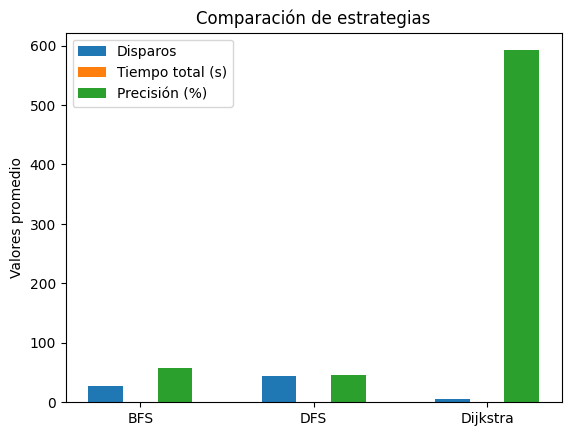


Resultados de la simulación:

Estrategia: BFS
  Promedio de disparos: 38.30
  Tiempo total promedio: 0.00 segundos
  Precisión promedio: 40.83%

Estrategia: DFS
  Promedio de disparos: 33.70
  Tiempo total promedio: 0.00 segundos
  Precisión promedio: 46.45%

Estrategia: Dijkstra
  Promedio de disparos: 6.60
  Tiempo total promedio: 0.02 segundos
  Precisión promedio: 545.47%


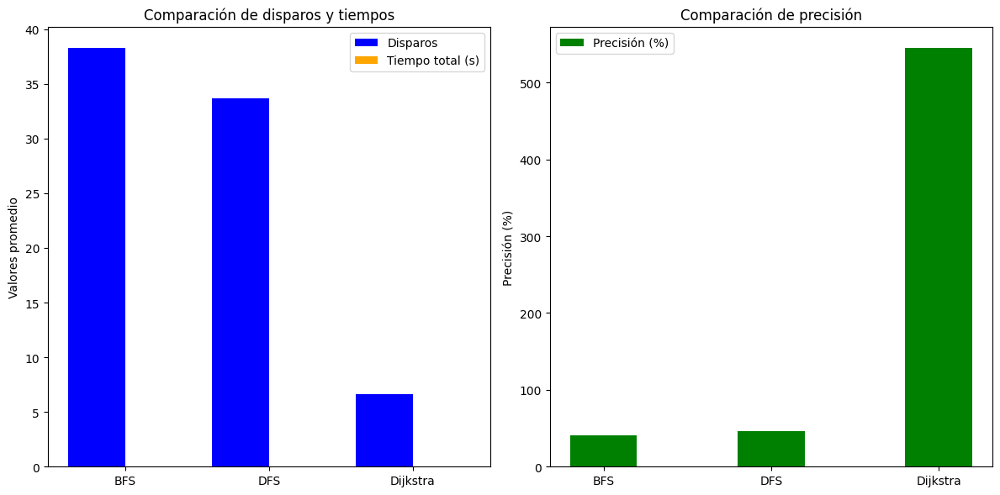

In [ ]:
# =======================
# Simulación y visualización
# =======================
def simular_estrategias(n_simulaciones=10):
    estrategias = ['BFS', 'DFS', 'Dijkstra']
    resultados = {estrategia: [] for estrategia in estrategias}

    for _ in range(n_simulaciones):
        for estrategia in estrategias:
            tablero = crear_tablero()
            colores_barcos = ['amarillo', 'naranja', 'morado', 'cian']
            tamaños_barcos = [5, 4, 3, 2]
            for tamaño, color in zip(tamaños_barcos, colores_barcos):
                colocar_barco_optimo(tablero, tamaño, color)
            reiniciar_colores(tablero)

            disparos, tiempo_total, precision = ataque(tablero, estrategia)
            resultados[estrategia].append((disparos, tiempo_total, precision))

    # Calcular promedios de las métricas
    promedios = {
        estrategia: {
            'Disparos': np.mean([res[0] for res in resultados[estrategia]]),
            'Tiempo total (s)': np.mean([res[1] for res in resultados[estrategia]]),
            'Precisión (%)': np.mean([res[2] for res in resultados[estrategia]]) * 100
        }
        for estrategia in estrategias
    }

    # Mostrar resultados en consola
    print("\nResultados de la simulación:")
    for estrategia, datos in promedios.items():
        print(f"\nEstrategia: {estrategia}")
        print(f"  Promedio de disparos: {datos['Disparos']:.2f}")
        print(f"  Tiempo total promedio: {datos['Tiempo total (s)']:.2f} segundos")
        print(f"  Precisión promedio: {datos['Precisión (%)']:.2f}%")

    return promedios

def graficar_resultados(promedios):
    estrategias = list(promedios.keys())
    disparos = [promedios[estrategia]['Disparos'] for estrategia in estrategias]
    tiempos = [promedios[estrategia]['Tiempo total (s)'] for estrategia in estrategias]
    precisiones = [promedios[estrategia]['Precisión (%)'] for estrategia in estrategias]

    x = np.arange(len(estrategias))

    # Crear gráfica comparativa
    plt.figure(figsize=(12, 6))

    # Comparativa de disparos
    plt.subplot(1, 2, 1)
    plt.bar(x - 0.2, disparos, width=0.4, label='Disparos', color='blue')
    plt.bar(x + 0.2, tiempos, width=0.4, label='Tiempo total (s)', color='orange')
    plt.xticks(x, estrategias)
    plt.ylabel('Valores promedio')
    plt.title('Comparación de disparos y tiempos')
    plt.legend()

    # Comparativa de precisiones
    plt.subplot(1, 2, 2)
    plt.bar(x, precisiones, width=0.4, label='Precisión (%)', color='green')
    plt.xticks(x, estrategias)
    plt.ylabel('Precisión (%)')
    plt.title('Comparación de precisión')
    plt.legend()

    plt.tight_layout()
    plt.show()

# Simular y graficar
promedios = simular_estrategias(n_simulaciones=10)
graficar_resultados(promedios)



Resultados de la simulación:

Estrategia: BFS
  Promedio de disparos: 36.90
  Tiempo total promedio: 0.00 segundos
  Precisión promedio: 42.20%

Estrategia: DFS
  Promedio de disparos: 37.90
  Tiempo total promedio: 0.00 segundos
  Precisión promedio: 43.34%

Estrategia: Dijkstra
  Promedio de disparos: 8.90
  Tiempo total promedio: 0.01 segundos
  Precisión promedio: 362.43%


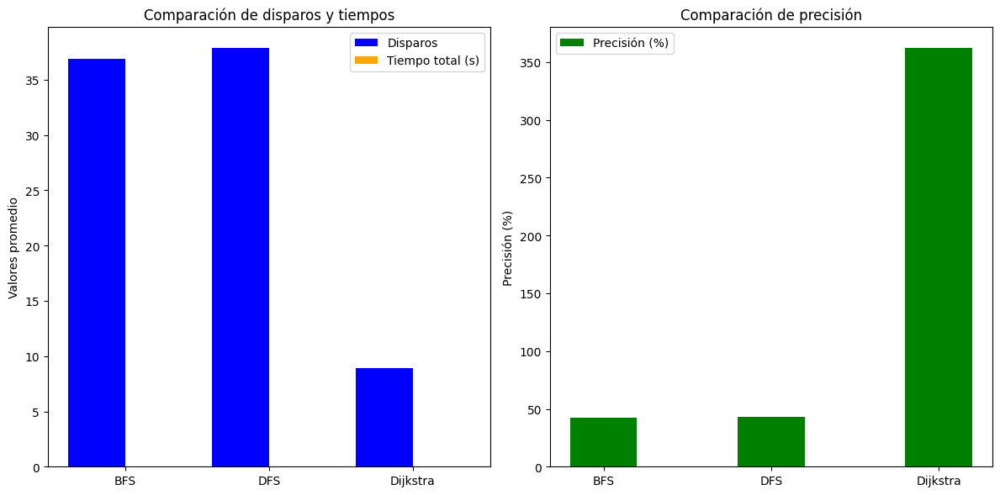